<a href="https://colab.research.google.com/github/AnirudhA3/pcb_board/blob/main/SAM_1.1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# ==============================
# STEP 1: Install Dependencies
# ==============================
!pip install segment-anything opencv-python matplotlib torch torchvision -q

# ==============================
# STEP 2: Import Libraries
# ==============================
import torch
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

print("✅ Libraries imported successfully!")

# ==============================
# STEP 3: Download the Pretrained SAM Model (ViT-B)
# ==============================
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth

# ==============================
# STEP 4: Load the Model
# ==============================
sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
mask_generator = SamAutomaticMaskGenerator(sam)

print("✅ SAM model (ViT-B) loaded successfully and ready to use!")


✅ Libraries imported successfully!
✅ SAM model (ViT-B) loaded successfully and ready to use!


📤 Please upload your PCB image (e.g., pcb_sample.jpg)


Saving dummy1.jpg to dummy1 (2).jpg
✅ Image uploaded successfully: dummy1 (2).jpg


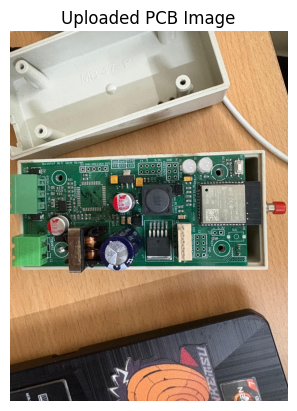

NameError: name 'sam' is not defined

In [ ]:
# ==============================
# STEP 5: Upload a PCB Image
# ==============================
from google.colab import files
import cv2
import matplotlib.pyplot as plt

print("📤 Please upload your PCB image (e.g., pcb_sample.jpg)")
uploaded = files.upload()

# Get the uploaded image filename
image_path = list(uploaded.keys())[0]
print(f"✅ Image uploaded successfully: {image_path}")

# Read and convert to RGB
image = cv2.imread(image_path)
if image is None:
    raise ValueError("❌ Image not found or failed to load. Try uploading again.")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.imshow(image)
plt.title("Uploaded PCB Image")
plt.axis('off')
plt.show()

# ==============================
# STEP 6: Run SAM for Mask Generation
# ==============================
from segment_anything import SamAutomaticMaskGenerator

mask_generator = SamAutomaticMaskGenerator(sam)
masks = mask_generator.generate(image)

print(f"✅ SAM detected {len(masks)} distinct regions/components!")

# ==============================
# STEP 7: Visualize All Segmented Masks
# ==============================
import numpy as np

mask_image = np.zeros_like(image)
for m in masks:
    color = np.random.randint(0, 255, (1, 3), dtype=np.uint8)
    mask_image[m["segmentation"]] = color

plt.figure(figsize=(10, 10))
plt.imshow(mask_image)
plt.title("SAM Segmented Regions (Each Color = Component)")
plt.axis('off')
plt.show()


In [ ]:
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# Reload the model (no need to reinstall again)
sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
mask_generator = SamAutomaticMaskGenerator(sam)

print("✅ SAM model loaded and ready again!")


✅ SAM model loaded and ready again!


✅ SAM model loaded successfully!
📤 Please upload your PCB image (e.g., pcb_sample.jpg)


Saving hosa.jpeg to hosa.jpeg
✅ Image uploaded: hosa.jpeg
🧩 Resized image to: 768x1024


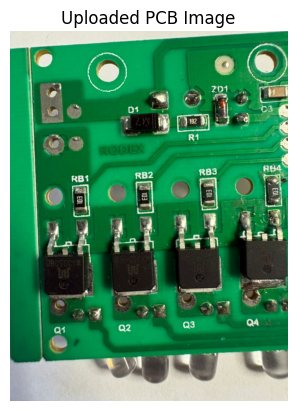

🔍 Running SAM... please wait (takes ~30-60 s)...
✅ SAM detected 55 regions/components!


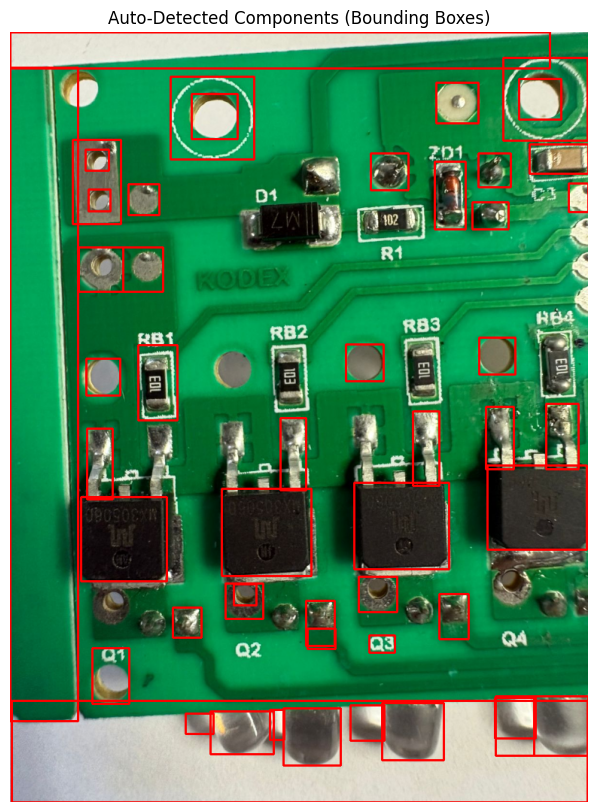

💾 Output saved as: pcb_with_boxes_optimized.jpg
✅ SAM model loaded successfully!
📤 Please upload your PCB image (e.g., pcb_sample.jpg)


KeyboardInterrupt: 

In [3]:
# =====================================
# STEP 1: Install required dependencies
# =====================================
!pip install segment-anything opencv-python matplotlib torch torchvision -q

# =====================================
# STEP 2: Import and load SAM (ViT-B)
# =====================================
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
import cv2, torch, numpy as np, matplotlib.pyplot as plt
from google.colab import files

# Download pretrained model
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth

# Load lightweight version of SAM
sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
print("✅ SAM model loaded successfully!")

# =====================================
# STEP 3: Upload your PCB image
# =====================================
print("📤 Please upload your PCB image (e.g., pcb_sample.jpg)")
uploaded = files.upload()
image_path = list(uploaded.keys())[0]
print(f"✅ Image uploaded: {image_path}")

image = cv2.imread(image_path)
if image is None:
    raise ValueError("❌ Image not found or failed to load.")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# =====================================
# STEP 4: Resize image to save RAM
# =====================================
max_size = 1024     # reduce resolution if needed
h, w = image.shape[:2]
scale = max_size / max(h, w)
if scale < 1:
    image = cv2.resize(image, (int(w*scale), int(h*scale)))
print(f"🧩 Resized image to: {image.shape[1]}x{image.shape[0]}")

plt.imshow(image)
plt.title("Uploaded PCB Image")
plt.axis('off')
plt.show()

# =====================================
# STEP 5: Configure lightweight SAM mask generator
# =====================================
mask_generator = SamAutomaticMaskGenerator(
    sam,
    points_per_side=16,          # fewer sampling points (default 32)
    pred_iou_thresh=0.88,        # higher confidence
    stability_score_thresh=0.92, # ignore uncertain masks
    crop_n_layers=0,             # disable multiscale
    min_mask_region_area=500     # skip tiny noise regions
)

# =====================================
# STEP 6: Run SAM segmentation
# =====================================
print("🔍 Running SAM... please wait (takes ~30-60 s)...")
masks = mask_generator.generate(image)
print(f"✅ SAM detected {len(masks)} regions/components!")

# =====================================
# STEP 7: Draw bounding boxes around detected components
# =====================================
boxed = image.copy()
for m in masks:
    seg = m["segmentation"].astype('uint8')
    x, y, w, h = cv2.boundingRect(seg)
    if w*h > 400:   # filter small boxes
        cv2.rectangle(boxed, (x, y), (x+w, y+h), (255, 0, 0), 2)

plt.figure(figsize=(10,10))
plt.imshow(boxed)
plt.title("Auto-Detected Components (Bounding Boxes)")
plt.axis('off')
plt.show()

# =====================================
# STEP 8: Save output
# =====================================
out_path = "pcb_with_boxes_optimized.jpg"
cv2.imwrite(out_path, cv2.cvtColor(boxed, cv2.COLOR_RGB2BGR))
print(f"💾 Output saved as: {out_path}")
# =====================================
# STEP 1: Install required dependencies
# =====================================
!pip install segment-anything opencv-python matplotlib torch torchvision -q

# =====================================
# STEP 2: Import and load SAM (ViT-B)
# =====================================
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
import cv2, torch, numpy as np, matplotlib.pyplot as plt
from google.colab import files

# Download pretrained model
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth

# Load lightweight version of SAM
sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
print("✅ SAM model loaded successfully!")

# =====================================
# STEP 3: Upload your PCB image
# =====================================
print("📤 Please upload your PCB image (e.g., pcb_sample.jpg)")
uploaded = files.upload()
image_path = list(uploaded.keys())[0]
print(f"✅ Image uploaded: {image_path}")

image = cv2.imread(image_path)
if image is None:
    raise ValueError("❌ Image not found or failed to load.")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# =====================================
# STEP 4: Resize image to save RAM
# =====================================
max_size = 1024     # reduce resolution if needed
h, w = image.shape[:2]
scale = max_size / max(h, w)
if scale < 1:
    image = cv2.resize(image, (int(w*scale), int(h*scale)))
print(f"🧩 Resized image to: {image.shape[1]}x{image.shape[0]}")

plt.imshow(image)
plt.title("Uploaded PCB Image")
plt.axis('off')
plt.show()

# =====================================
# STEP 5: Configure lightweight SAM mask generator
# =====================================
mask_generator = SamAutomaticMaskGenerator(
    sam,
    points_per_side=16,          # fewer sampling points (default 32)
    pred_iou_thresh=0.88,        # higher confidence
    stability_score_thresh=0.92, # ignore uncertain masks
    crop_n_layers=0,             # disable multiscale
    min_mask_region_area=500     # skip tiny noise regions
)

# =====================================
# STEP 6: Run SAM segmentation
# =====================================
print("🔍 Running SAM... please wait (takes ~30-60 s)...")
masks = mask_generator.generate(image)
print(f"✅ SAM detected {len(masks)} regions/components!")

# =====================================
# STEP 7: Draw bounding boxes around detected components
# =====================================
boxed = image.copy()
for m in masks:
    seg = m["segmentation"].astype('uint8')
    x, y, w, h = cv2.boundingRect(seg)
    if w*h > 400:   # filter small boxes
        cv2.rectangle(boxed, (x, y), (x+w, y+h), (255, 0, 0), 2)

plt.figure(figsize=(10,10))
plt.imshow(boxed)
plt.title("Auto-Detected Components (Bounding Boxes)")
plt.axis('off')
plt.show()

# =====================================
# STEP 8: Save output
# =====================================
out_path = "pcb_with_boxes_optimized.jpg"
cv2.imwrite(out_path, cv2.cvtColor(boxed, cv2.COLOR_RGB2BGR))
print(f"💾 Output saved as: {out_path}")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 22.3 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
✅ SAM model loaded successfully!
📤 Please upload your PCB image (e.g., pcb_sample.jpg)


Saving hosa.jpeg to hosa (1).jpeg
✅ Image uploaded: hosa (1).jpeg
🧩 Resized image to: 768x1024


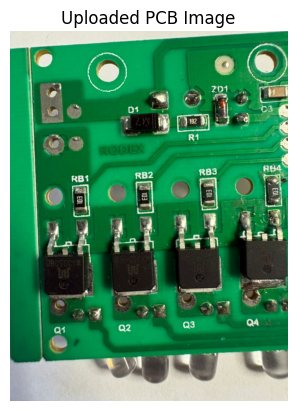

🔍 Running SAM... please wait (takes ~30-60 s)...
✅ SAM detected 35 regions/components!


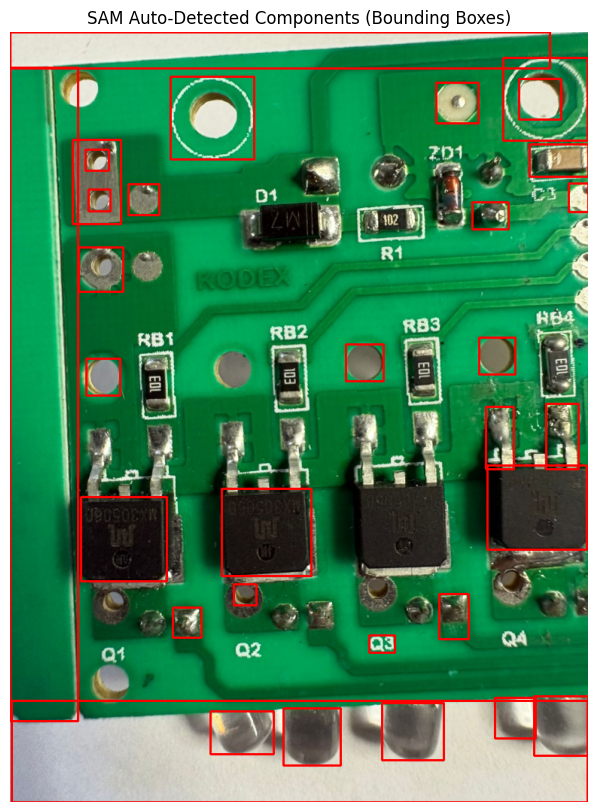

💾 SAM output saved as: pcb_with_boxes_optimized.jpg
🚀 Loading YOLO model...
✅ YOLO model loaded successfully!
🔍 Running YOLO inference with high confidence (0.6)...

image 1/1 /content/hosa (1).jpeg: 640x480 (no detections), 95.3ms
Speed: 3.8ms preprocess, 95.3ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 480)
Results saved to /content/runs/detect/predict


error: OpenCV(4.12.0) /io/opencv/modules/core/src/arithm.cpp:662: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function 'arithm_op'


In [4]:
# =====================================
# STEP 1: Install required dependencies
# =====================================
!pip install segment-anything opencv-python matplotlib torch torchvision ultralytics -q

# =====================================
# STEP 2: Import and load SAM (ViT-B)
# =====================================
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from ultralytics import YOLO
import cv2, torch, numpy as np, matplotlib.pyplot as plt
from google.colab import files

# Download pretrained model
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth

# Load lightweight version of SAM
sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
print("✅ SAM model loaded successfully!")

# =====================================
# STEP 3: Upload your PCB image
# =====================================
print("📤 Please upload your PCB image (e.g., pcb_sample.jpg)")
uploaded = files.upload()
image_path = list(uploaded.keys())[0]
print(f"✅ Image uploaded: {image_path}")

image = cv2.imread(image_path)
if image is None:
    raise ValueError("❌ Image not found or failed to load.")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# =====================================
# STEP 4: Resize image to save RAM
# =====================================
max_size = 1024     # reduce resolution if needed
h, w = image.shape[:2]
scale = max_size / max(h, w)
if scale < 1:
    image = cv2.resize(image, (int(w*scale), int(h*scale)))
print(f"🧩 Resized image to: {image.shape[1]}x{image.shape[0]}")

plt.imshow(image)
plt.title("Uploaded PCB Image")
plt.axis('off')
plt.show()

# =====================================
# STEP 5: Configure lightweight SAM mask generator
# =====================================
mask_generator = SamAutomaticMaskGenerator(
    sam,
    points_per_side=16,          # fewer sampling points (default 32)
    pred_iou_thresh=0.92,        # increased confidence level
    stability_score_thresh=0.95, # ignore uncertain masks
    crop_n_layers=0,             # disable multiscale
    min_mask_region_area=800     # skip tiny noise regions
)

# =====================================
# STEP 6: Run SAM segmentation
# =====================================
print("🔍 Running SAM... please wait (takes ~30-60 s)...")
masks = mask_generator.generate(image)
print(f"✅ SAM detected {len(masks)} regions/components!")

# =====================================
# STEP 7: Draw bounding boxes around detected components
# =====================================
boxed = image.copy()
for m in masks:
    seg = m["segmentation"].astype('uint8')
    x, y, w, h = cv2.boundingRect(seg)
    if w*h > 400:   # filter small boxes
        cv2.rectangle(boxed, (x, y), (x+w, y+h), (255, 0, 0), 2)

plt.figure(figsize=(10,10))
plt.imshow(boxed)
plt.title("SAM Auto-Detected Components (Bounding Boxes)")
plt.axis('off')
plt.show()

# =====================================
# STEP 8: Save SAM output
# =====================================
out_path = "pcb_with_boxes_optimized.jpg"
cv2.imwrite(out_path, cv2.cvtColor(boxed, cv2.COLOR_RGB2BGR))
print(f"💾 SAM output saved as: {out_path}")

# =====================================
# STEP 9: YOLO MODEL INTEGRATION
# =====================================
print("🚀 Loading YOLO model...")

# Load a pretrained YOLOv8n model (you can replace with your own path)
yolo_model = YOLO("yolov8n.pt")  # lightweight model for detection
print("✅ YOLO model loaded successfully!")

# Run YOLO inference with higher confidence threshold
print("🔍 Running YOLO inference with high confidence (0.6)...")
yolo_results = yolo_model.predict(source=image_path, conf=0.6, save=True)

# =====================================
# STEP 10: Visualize YOLO + SAM Results Together
# =====================================
yolo_image = cv2.imread(image_path)
for r in yolo_results:
    for box in r.boxes:
        x1, y1, x2, y2 = box.xyxy[0].cpu().numpy().astype(int)
        conf = float(box.conf)
        label = str(r.names[int(box.cls)])
        if conf > 0.6:  # confidence threshold
            cv2.rectangle(yolo_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(yolo_image, f"{label} {conf:.2f}", (x1, y1 - 5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

# Combine SAM (blue boxes) + YOLO (green boxes)
combined = cv2.addWeighted(cv2.cvtColor(boxed, cv2.COLOR_RGB2BGR), 0.6, yolo_image, 0.6, 0)

plt.figure(figsize=(10,10))
plt.imshow(cv2.cvtColor(combined, cv2.COLOR_BGR2RGB))
plt.title("Combined SAM (Blue) + YOLO (Green) Detections")
plt.axis('off')
plt.show()

# =====================================
# STEP 11: Save final combined output
# =====================================
final_path = "pcb_sam_yolo_combined.jpg"
cv2.imwrite(final_path, combined)
print(f"💾 Final SAM + YOLO output saved as: {final_path}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
✅ Google Drive mounted successfully!
✅ Found and loaded latest YOLO model:
/content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt

📸 Upload your MASTER and TEST PCB images:


Saving dummy.jpg to dummy (1).jpg
Saving dummy1.jpg to dummy1 (5).jpg
✅ Images loaded:
 - Master: dummy (1).jpg
 - Test: dummy1 (5).jpg
📏 Cropped PCB region: x=578, y=460, w=1575, h=3299
📏 Cropped PCB region: x=0, y=1339, w=2708, h=1247

0: 640x320 7 ICss, 10 capacitorss, 2 resistorss, 39.1ms
Speed: 2.1ms preprocess, 39.1ms inference, 32.4ms postprocess per image at shape (1, 3, 640, 320)

0: 320x640 7 ICss, 12 capacitorss, 2 resistorss, 35.6ms
Speed: 2.5ms preprocess, 35.6ms inference, 1.2ms postprocess per image at shape (1, 3, 320, 640)
✅ YOLO detection complete.
📂 Results saved to: /content/pcb_output


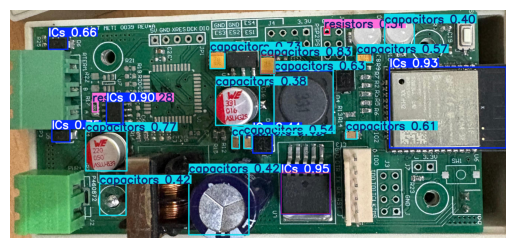


🟥 Visual comparison saved at: /content/pcb_output/difference_visual.png
📊 JSON differences saved at: /content/pcb_output/differences.json

🔍 Loading SAM model for segmentation refinement...
✅ SAM model loaded successfully!
🎯 Running SAM on detected regions from TEST PCB...


KeyboardInterrupt: 

In [8]:
# ==============================================================
# 🧠 PCB COMPONENT COMPARISON + SAM SEGMENTATION + OpenCV Overlay
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ==============================================================
# 🧩 Imports
# ==============================================================
import os, cv2, json, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from google.colab import files, drive
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output"
os.makedirs(OUT_DIR, exist_ok=True)

drive.mount('/content/drive')
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Auto-Find the Latest YOLO Model (best.pt)
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found_models = []

for root, dirs, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            full_path = os.path.join(root, f)
            found_models.append((full_path, os.path.getmtime(full_path)))

if not found_models:
    raise FileNotFoundError("❌ No 'best.pt' found in your Drive. Please train or upload the model.")

found_models.sort(key=lambda x: x[1], reverse=True)
MODEL_PATH = found_models[0][0]

print(f"✅ Found and loaded latest YOLO model:\n{MODEL_PATH}")
model = YOLO(MODEL_PATH)

# ==============================================================
# ✂️ Auto-Crop PCB Area (Green Segmentation)
# ==============================================================
def auto_crop_board(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        print("⚠️ No green PCB region detected — using full image.")
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    print(f"📏 Cropped PCB region: x={x}, y={y}, w={w}, h={h}")
    return image[y:y+h, x:x+w]

# ==============================================================
# 🧩 YOLO Detection Function
# ==============================================================
def detect_with_yolo(image, prefix="PCB"):
    results = model(image)
    annotated = results[0].plot()
    comps = []
    for i, box in enumerate(results[0].boxes):
        cls_id = int(box.cls)
        label = results[0].names[cls_id]
        x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
        comps.append({
            "id": f"{prefix}{i}",
            "label": label,
            "position": [int(x1), int(y1), int(x2 - x1), int(y2 - y1)]
        })
    return annotated, comps

# ==============================================================
# 📤 Upload MASTER and TEST PCB Images
# ==============================================================
print("\n📸 Upload your MASTER and TEST PCB images:")
uploaded = files.upload()
paths = list(uploaded.keys())

if len(paths) < 2:
    raise ValueError("❌ Please upload both MASTER and TEST PCB images.")

master_img = cv2.imread(paths[0])
test_img   = cv2.imread(paths[1])
print(f"✅ Images loaded:\n - Master: {paths[0]}\n - Test: {paths[1]}")

# ==============================================================
# 🔍 YOLO Detection + JSON Export
# ==============================================================
master_crop = auto_crop_board(master_img)
test_crop   = auto_crop_board(test_img)

master_detected, master_comps = detect_with_yolo(master_crop, "M")
test_detected, test_comps = detect_with_yolo(test_crop, "T")

master_json = {"components": master_comps}
test_json   = {"components": test_comps}

cv2.imwrite(f"{OUT_DIR}/master_detected.png", master_detected)
cv2.imwrite(f"{OUT_DIR}/test_detected.png", test_detected)
with open(f"{OUT_DIR}/master.json", "w") as f: json.dump(master_json, f, indent=2)
with open(f"{OUT_DIR}/test.json", "w") as f: json.dump(test_json, f, indent=2)

print(f"✅ YOLO detection complete.\n📂 Results saved to: {OUT_DIR}")

# ==============================================================
# 🔁 JSON Comparison + Visual Markup
# ==============================================================
def compare_json(master, test):
    diffs = []
    for m in master["components"]:
        match = next((t for t in test["components"] if t["label"] == m["label"]), None)
        if not match:
            diffs.append({"label": m["label"], "status": "missing", "position": m["position"]})
        else:
            dx = abs(m["position"][0] - match["position"][0])
            dy = abs(m["position"][1] - match["position"][1])
            if dx > 10 or dy > 10:
                diffs.append({
                    "label": m["label"],
                    "status": "moved",
                    "old_position": m["position"],
                    "new_position": match["position"]
                })
    return {"differences": diffs}

def visualize_differences(diff_json, test_img):
    for d in diff_json["differences"]:
        if d["status"] == "missing":
            x, y, w, h = d["position"]
            cv2.rectangle(test_img, (x, y), (x+w, y+h), (0, 0, 255), 2)
            cv2.putText(test_img, f"{d['label']} missing", (x, y-5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 1)
        elif d["status"] == "moved":
            nx, ny, nw, nh = d["new_position"]
            cv2.rectangle(test_img, (nx, ny), (nx+nw, ny+nh), (0,0,255), 2)
            cv2.putText(test_img, f"{d['label']} moved", (nx, ny-5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 1)
    return test_img

diff_json = compare_json(master_json, test_json)
with open(f"{OUT_DIR}/differences.json", "w") as f: json.dump(diff_json, f, indent=2)

visualized = visualize_differences(diff_json, test_detected.copy())
cv2.imwrite(f"{OUT_DIR}/difference_visual.png", visualized)

plt.imshow(cv2.cvtColor(visualized, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()

print("\n🟥 Visual comparison saved at:", f"{OUT_DIR}/difference_visual.png")
print("📊 JSON differences saved at:", f"{OUT_DIR}/differences.json")

# ==============================================================
# 🧠 SAM SEGMENTATION REFINEMENT + OpenCV
# ==============================================================
print("\n🔍 Loading SAM model for segmentation refinement...")
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth
sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")

mask_generator = SamAutomaticMaskGenerator(
    sam,
    points_per_side=16,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=0,
    min_mask_region_area=800
)
print("✅ SAM model loaded successfully!")

# Run SAM on TEST image regions
print("🎯 Running SAM on detected regions from TEST PCB...")
sam_refined = test_crop.copy()

for comp in test_comps:
    x, y, w, h = comp["position"]
    roi = test_crop[y:y+h, x:x+w]
    if roi.size == 0: continue
    masks = mask_generator.generate(roi)
    for m in masks:
        seg = m["segmentation"].astype('uint8')
        contours, _ = cv2.findContours(seg, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        for cnt in contours:
            cv2.drawContours(sam_refined[y:y+h, x:x+w], [cnt], -1, (255, 0, 0), 1)

combined_final = cv2.addWeighted(visualized, 0.6, sam_refined, 0.6, 0)
cv2.imwrite(f"{OUT_DIR}/final_combined_sam_overlay.png", combined_final)

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(combined_final, cv2.COLOR_BGR2RGB))
plt.title("Final Combined Output (YOLO + SAM + Comparison)")
plt.axis("off")
plt.show()

print("\n✅ Complete Pipeline Executed Successfully!")
print(f"📁 All outputs saved in: {OUT_DIR}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
✅ Google Drive mounted successfully!
✅ Found and loaded latest YOLO model:
/content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt

📸 Upload your MASTER and TEST PCB images:


Saving dummy.jpg to dummy (2).jpg
Saving dummy1.jpg to dummy1 (6).jpg
✅ Images loaded:
 - Master: dummy (2).jpg
 - Test: dummy1 (6).jpg
📏 Cropped PCB region: x=578, y=460, w=1575, h=3299
📏 Cropped PCB region: x=0, y=1339, w=2708, h=1247

0: 640x320 7 ICss, 10 capacitorss, 2 resistorss, 9.6ms
Speed: 2.1ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 320)

0: 320x640 7 ICss, 12 capacitorss, 2 resistorss, 7.9ms
Speed: 2.3ms preprocess, 7.9ms inference, 1.2ms postprocess per image at shape (1, 3, 320, 640)
✅ YOLO detection complete.
📂 Results saved to: /content/pcb_output


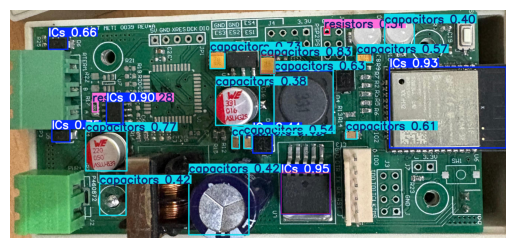


🟥 Visual comparison saved at: /content/pcb_output/difference_visual.png
📊 JSON differences saved at: /content/pcb_output/differences.json

⚡ Loading optimized SAM (ViT-B) for segmentation refinement...
✅ Optimized SAM (ViT-B) loaded successfully!
🎯 Running SAM on detected regions from TEST PCB...


KeyboardInterrupt: 

In [11]:
# ==============================================================
# 🧠 PCB COMPONENT COMPARISON + YOLOv8 + SAM (Optimized ViT-B) + OpenCV Overlay
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ==============================================================
# 🧩 Imports
# ==============================================================
import os, cv2, json, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from google.colab import files, drive
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output"
os.makedirs(OUT_DIR, exist_ok=True)

drive.mount('/content/drive')
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Auto-Find the Latest YOLO Model (best.pt)
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found_models = []

for root, dirs, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            full_path = os.path.join(root, f)
            found_models.append((full_path, os.path.getmtime(full_path)))

if not found_models:
    raise FileNotFoundError("❌ No 'best.pt' found in your Drive. Please train or upload the model.")

found_models.sort(key=lambda x: x[1], reverse=True)
MODEL_PATH = found_models[0][0]

print(f"✅ Found and loaded latest YOLO model:\n{MODEL_PATH}")
model = YOLO(MODEL_PATH)

# ==============================================================
# ✂️ Auto-Crop PCB Area (Green Segmentation)
# ==============================================================
def auto_crop_board(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        print("⚠️ No green PCB region detected — using full image.")
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    print(f"📏 Cropped PCB region: x={x}, y={y}, w={w}, h={h}")
    return image[y:y+h, x:x+w]

# ==============================================================
# 🧩 YOLO Detection Function
# ==============================================================
def detect_with_yolo(image, prefix="PCB"):
    results = model(image)
    annotated = results[0].plot()
    comps = []
    for i, box in enumerate(results[0].boxes):
        cls_id = int(box.cls)
        label = results[0].names[cls_id]
        x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
        comps.append({
            "id": f"{prefix}{i}",
            "label": label,
            "position": [int(x1), int(y1), int(x2 - x1), int(y2 - y1)]
        })
    return annotated, comps

# ==============================================================
# 📤 Upload MASTER and TEST PCB Images
# ==============================================================
print("\n📸 Upload your MASTER and TEST PCB images:")
uploaded = files.upload()
paths = list(uploaded.keys())

if len(paths) < 2:
    raise ValueError("❌ Please upload both MASTER and TEST PCB images.")

master_img = cv2.imread(paths[0])
test_img   = cv2.imread(paths[1])
print(f"✅ Images loaded:\n - Master: {paths[0]}\n - Test: {paths[1]}")

# ==============================================================
# 🔍 YOLO Detection + JSON Export
# ==============================================================
master_crop = auto_crop_board(master_img)
test_crop   = auto_crop_board(test_img)

master_detected, master_comps = detect_with_yolo(master_crop, "M")
test_detected, test_comps = detect_with_yolo(test_crop, "T")

master_json = {"components": master_comps}
test_json   = {"components": test_comps}

cv2.imwrite(f"{OUT_DIR}/master_detected.png", master_detected)
cv2.imwrite(f"{OUT_DIR}/test_detected.png", test_detected)
with open(f"{OUT_DIR}/master.json", "w") as f: json.dump(master_json, f, indent=2)
with open(f"{OUT_DIR}/test.json", "w") as f: json.dump(test_json, f, indent=2)

print(f"✅ YOLO detection complete.\n📂 Results saved to: {OUT_DIR}")

# ==============================================================
# 🔁 JSON Comparison + Visual Markup
# ==============================================================
def compare_json(master, test):
    diffs = []
    for m in master["components"]:
        match = next((t for t in test["components"] if t["label"] == m["label"]), None)
        if not match:
            diffs.append({"label": m["label"], "status": "missing", "position": m["position"]})
        else:
            dx = abs(m["position"][0] - match["position"][0])
            dy = abs(m["position"][1] - match["position"][1])
            if dx > 10 or dy > 10:
                diffs.append({
                    "label": m["label"],
                    "status": "moved",
                    "old_position": m["position"],
                    "new_position": match["position"]
                })
    return {"differences": diffs}

def visualize_differences(diff_json, test_img):
    for d in diff_json["differences"]:
        if d["status"] == "missing":
            x, y, w, h = d["position"]
            cv2.rectangle(test_img, (x, y), (x+w, y+h), (0, 0, 255), 2)
            cv2.putText(test_img, f"{d['label']} missing", (x, y-5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 1)
        elif d["status"] == "moved":
            nx, ny, nw, nh = d["new_position"]
            cv2.rectangle(test_img, (nx, ny), (nx+nw, ny+nh), (0,0,255), 2)
            cv2.putText(test_img, f"{d['label']} moved", (nx, ny-5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 1)
    return test_img

diff_json = compare_json(master_json, test_json)
with open(f"{OUT_DIR}/differences.json", "w") as f: json.dump(diff_json, f, indent=2)

visualized = visualize_differences(diff_json, test_detected.copy())
cv2.imwrite(f"{OUT_DIR}/difference_visual.png", visualized)

plt.imshow(cv2.cvtColor(visualized, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()

print("\n🟥 Visual comparison saved at:", f"{OUT_DIR}/difference_visual.png")
print("📊 JSON differences saved at:", f"{OUT_DIR}/differences.json")

# ==============================================================
# 🧠 OPTIMIZED SAM SEGMENTATION (ViT-B) + OpenCV Overlay
# ==============================================================
print("\n⚡ Loading optimized SAM (ViT-B) for segmentation refinement...")
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth

sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")

mask_generator = SamAutomaticMaskGenerator(
    sam,
    points_per_side=8,           # fewer sample points
    pred_iou_thresh=0.9,         # high confidence
    stability_score_thresh=0.95, # stable masks only
    crop_n_layers=0,             # disable multi-scale
    min_mask_region_area=1000    # ignore small regions
)
print("✅ Optimized SAM (ViT-B) loaded successfully!")

# Run SAM refinement on TEST PCB
print("🎯 Running SAM on detected regions from TEST PCB...")
sam_refined = test_crop.copy()

for comp in test_comps:
    x, y, w, h = comp["position"]
    roi = test_crop[y:y+h, x:x+w]
    if roi.size == 0:
        continue
    masks = mask_generator.generate(roi)
    for m in masks:
        seg = m["segmentation"].astype('uint8')
        contours, _ = cv2.findContours(seg, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        for cnt in contours:
            cv2.drawContours(sam_refined[y:y+h, x:x+w], [cnt], -1, (255, 0, 0), 1)

# Combine YOLO + SAM + Comparison Results
combined_final = cv2.addWeighted(visualized, 0.6, sam_refined, 0.6, 0)
cv2.imwrite(f"{OUT_DIR}/final_combined_sam_overlay_fast.png", combined_final)

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(combined_final, cv2.COLOR_BGR2RGB))
plt.title("Final Combined Output (YOLO + SAM + Comparison)")
plt.axis("off")
plt.show()

print("\n✅ Full Pipeline Executed Successfully!")
print(f"📁 All outputs saved in: {OUT_DIR}")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 51.0 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Mounted at /content/drive
✅ Google Drive mounted successfully!
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📸 Please upload a PCB image:


Saving hosa.jpeg to hosa.jpeg
✅ Image uploaded: hosa.jpeg
🟩 Running YOLO detection...
✅ YOLO detected 4 components.
🔵 Loading SAM model...
✅ SAM model ready!
🔵 Running SAM on uncovered regions...
✅ SAM added 11 new boxes.
🟠 Running OpenCV edge detection as backup...
✅ OpenCV added 92 boxes.


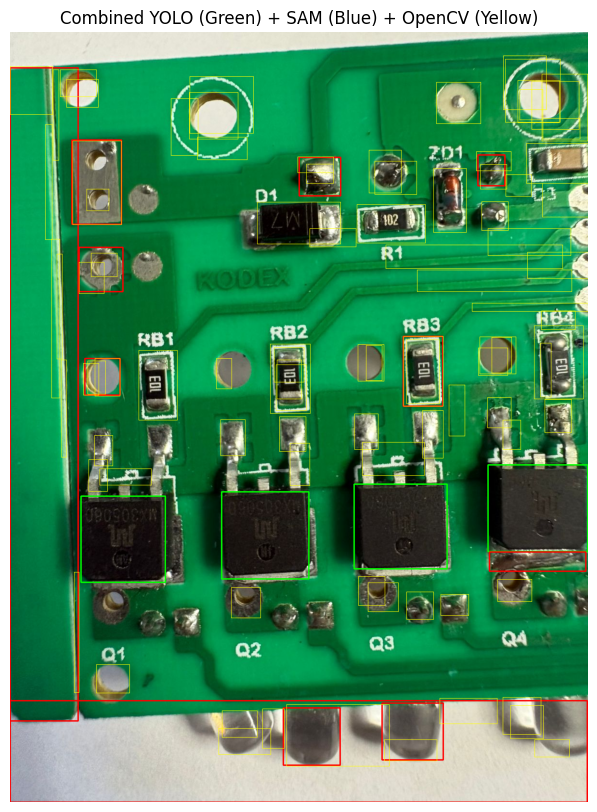

💾 Saved combined detection image at: /content/pcb_output/final_combined_detections.png
✂️ Cropping detected regions...
✅ Cropped 107 component regions.
📁 Crops saved to: /content/pcb_output/crops


In [1]:
# ==============================================================
# 🧠 PCB COMPONENT DETECTION — YOLO + SAM + OpenCV + Cropping
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ==============================================================
# 🧩 Imports
# ==============================================================
import os, cv2, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output"
CROP_DIR = f"{OUT_DIR}/crops"
os.makedirs(CROP_DIR, exist_ok=True)

drive.mount('/content/drive')
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Load YOLO model
# ==============================================================
# Auto-find your trained YOLO model (latest best.pt)
search_root = "/content/drive/My Drive/YOLO"
found_models = []
for root, dirs, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            found_models.append(os.path.join(root, f))
if not found_models:
    raise FileNotFoundError("❌ No best.pt found in your Drive.")
MODEL_PATH = sorted(found_models, key=os.path.getmtime, reverse=True)[0]
print(f"✅ Using YOLO model: {MODEL_PATH}")

model = YOLO(MODEL_PATH)

# ==============================================================
# 📤 Upload a single PCB image
# ==============================================================
print("📸 Please upload a PCB image:")
uploaded = files.upload()
image_path = list(uploaded.keys())[0]
image = cv2.imread(image_path)
if image is None:
    raise ValueError("❌ Image failed to load.")
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
print(f"✅ Image uploaded: {image_path}")

# ==============================================================
# 🔍 STEP 1 — YOLO Detection
# ==============================================================
print("🟩 Running YOLO detection...")
yolo_results = model.predict(source=image_rgb, conf=0.6, verbose=False)
yolo_boxes = []

for result in yolo_results:
    for box in result.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0].cpu().numpy())
        conf = float(box.conf)
        cls = int(box.cls)
        label = result.names[cls]
        if conf > 0.6:
            yolo_boxes.append((x1, y1, x2, y2, label, conf))

yolo_image = image_rgb.copy()
for (x1, y1, x2, y2, label, conf) in yolo_boxes:
    cv2.rectangle(yolo_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(yolo_image, f"{label}", (x1, y1 - 5),
                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

print(f"✅ YOLO detected {len(yolo_boxes)} components.")

# ==============================================================
# 🧠 STEP 2 — SAM Segmentation (for missing/unboxed areas)
# ==============================================================
print("🔵 Loading SAM model...")
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth

sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
mask_generator = SamAutomaticMaskGenerator(
    sam,
    points_per_side=8,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=0,
    min_mask_region_area=1000
)
print("✅ SAM model ready!")

# Create a mask to track YOLO-covered areas
mask_yolo = np.zeros(image.shape[:2], dtype=np.uint8)
for (x1, y1, x2, y2, _, _) in yolo_boxes:
    cv2.rectangle(mask_yolo, (x1, y1), (x2, y2), 255, -1)

# Run SAM only on uncovered regions
inverse_mask = cv2.bitwise_not(mask_yolo)
uncovered = cv2.bitwise_and(image_rgb, image_rgb, mask=inverse_mask)

print("🔵 Running SAM on uncovered regions...")
masks = mask_generator.generate(uncovered)
sam_image = image_rgb.copy()
sam_boxes = []

for m in masks:
    seg = m["segmentation"].astype('uint8')
    x, y, w, h = cv2.boundingRect(seg)
    overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
    if not overlap and w*h > 1000:  # skip overlapping YOLO boxes
        cv2.rectangle(sam_image, (x, y), (x+w, y+h), (255, 0, 0), 2)
        sam_boxes.append((x, y, x+w, y+h))

print(f"✅ SAM added {len(sam_boxes)} new boxes.")

# ==============================================================
# ⚙️ STEP 3 — OpenCV Edge-based Backup Detection
# ==============================================================
print("🟠 Running OpenCV edge detection as backup...")
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
edges = cv2.Canny(gray, 60, 150)
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
opencv_boxes = []

for c in contours:
    x, y, w, h = cv2.boundingRect(c)
    overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
    if w*h > 2000 and not overlap:
        cv2.rectangle(image_rgb, (x, y), (x+w, y+h), (255, 255, 0), 1)
        opencv_boxes.append((x, y, x+w, y+h))

print(f"✅ OpenCV added {len(opencv_boxes)} boxes.")

# ==============================================================
# 🖼️ STEP 4 — Combine and Visualize All Boxes
# ==============================================================
final = image_rgb.copy()

# Draw YOLO boxes (green)
for (x1, y1, x2, y2, _, _) in yolo_boxes:
    cv2.rectangle(final, (x1, y1), (x2, y2), (0, 255, 0), 2)

# Draw SAM boxes (blue)
for (x1, y1, x2, y2) in sam_boxes:
    cv2.rectangle(final, (x1, y1), (x2, y2), (255, 0, 0), 2)

# Draw OpenCV boxes (yellow)
for (x1, y1, x2, y2) in opencv_boxes:
    cv2.rectangle(final, (x1, y1), (x2, y2), (255, 255, 0), 1)

plt.figure(figsize=(10, 10))
plt.imshow(final)
plt.title("Combined YOLO (Green) + SAM (Blue) + OpenCV (Yellow)")
plt.axis('off')
plt.show()

cv2.imwrite(f"{OUT_DIR}/final_combined_detections.png", cv2.cvtColor(final, cv2.COLOR_RGB2BGR))
print(f"💾 Saved combined detection image at: {OUT_DIR}/final_combined_detections.png")

# ==============================================================
# ✂️ STEP 5 — Auto-Cropping of All Detected Components
# ==============================================================
print("✂️ Cropping detected regions...")
all_boxes = yolo_boxes + [(x1, y1, x2, y2, "sam", 1) for (x1, y1, x2, y2) in sam_boxes] + [(x1, y1, x2, y2, "opencv", 1) for (x1, y1, x2, y2) in opencv_boxes]
for i, (x1, y1, x2, y2, src, _) in enumerate(all_boxes):
    crop = image[y1:y2, x1:x2]
    if crop.size == 0: continue
    cv2.imwrite(f"{CROP_DIR}/{src}_crop_{i}.png", crop)

print(f"✅ Cropped {len(all_boxes)} component regions.")
print(f"📁 Crops saved to: {CROP_DIR}")


In [ ]:
# ==============================================================
# 🧠 PCB COMPONENT COMPARISON — YOLO + SAM + OpenCV (2 Boards)
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# ⚙️ SETUP
# ==============================================================
OUT_DIR = "/content/pcb_output"
os.makedirs(OUT_DIR, exist_ok=True)

drive.mount('/content/drive')
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Load Latest YOLO Model Automatically
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found_models = []
for root, dirs, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            found_models.append(os.path.join(root, f))

if not found_models:
    raise FileNotFoundError("❌ No best.pt found in your Drive.")

MODEL_PATH = sorted(found_models, key=os.path.getmtime, reverse=True)[0]
print(f"✅ Using YOLO model: {MODEL_PATH}")
model = YOLO(MODEL_PATH)

# ==============================================================
# 📤 Upload MASTER and TEST PCB Images
# ==============================================================
print("📸 Please upload your MASTER and TEST PCB images:")
uploaded = files.upload()
paths = list(uploaded.keys())

if len(paths) < 2:
    raise ValueError("❌ Please upload two images (MASTER and TEST).")

master_img = cv2.imread(paths[0])
test_img = cv2.imread(paths[1])
if master_img is None or test_img is None:
    raise ValueError("❌ Failed to load one or both images.")
print(f"✅ Loaded:\n - Master: {paths[0]}\n - Test: {paths[1]}")

# ==============================================================
# ⚙️ Common Detection Function (YOLO + SAM + OpenCV)
# ==============================================================
def detect_components(image, prefix="PCB"):
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # YOLO detection
    yolo_results = model.predict(source=image_rgb, conf=0.6, verbose=False)
    yolo_boxes = []
    for result in yolo_results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0].cpu().numpy())
            conf = float(box.conf)
            if conf > 0.6:
                yolo_boxes.append((x1, y1, x2, y2))

    # Mask out YOLO regions
    mask_yolo = np.zeros(image.shape[:2], dtype=np.uint8)
    for (x1, y1, x2, y2) in yolo_boxes:
        cv2.rectangle(mask_yolo, (x1, y1), (x2, y2), 255, -1)

    # SAM
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth
    sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
    mask_generator = SamAutomaticMaskGenerator(
        sam,
        points_per_side=8,
        pred_iou_thresh=0.9,
        stability_score_thresh=0.95,
        crop_n_layers=0,
        min_mask_region_area=1000
    )

    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(image_rgb, image_rgb, mask=inverse_mask)
    masks = mask_generator.generate(uncovered)
    sam_boxes = []
    for m in masks:
        seg = m["segmentation"].astype('uint8')
        x, y, w, h = cv2.boundingRect(seg)
        overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
        if not overlap and w*h > 1000:
            sam_boxes.append((x, y, x+w, y+h))

    # OpenCV edge-based backup
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 60, 150)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    opencv_boxes = []
    for c in contours:
        x, y, w, h = cv2.boundingRect(c)
        overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
        if w*h > 2000 and not overlap:
            opencv_boxes.append((x, y, x+w, y+h))

    all_boxes = yolo_boxes + sam_boxes + opencv_boxes
    detected = image_rgb.copy()

    # Draw boxes
    for (x1, y1, x2, y2) in yolo_boxes:
        cv2.rectangle(detected, (x1, y1), (x2, y2), (0, 255, 0), 2)
    for (x1, y1, x2, y2) in sam_boxes:
        cv2.rectangle(detected, (x1, y1), (x2, y2), (255, 0, 0), 2)
    for (x1, y1, x2, y2) in opencv_boxes:
        cv2.rectangle(detected, (x1, y1), (x2, y2), (255, 255, 0), 1)

    return detected, all_boxes

# ==============================================================
# 🧠 Run detection on both boards
# ==============================================================
print("\n🟩 Running detection on MASTER PCB...")
master_detected, master_boxes = detect_components(master_img, "MASTER")

print("\n🟦 Running detection on TEST PCB...")
test_detected, test_boxes = detect_components(test_img, "TEST")

# ==============================================================
# 🔁 Compare bounding boxes (simple IoU matching)
# ==============================================================
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    inter = max(0, xB - xA) * max(0, yB - yA)
    areaA = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    areaB = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])
    return inter / float(areaA + areaB - inter + 1e-6)

missing_boxes = []
for m_box in master_boxes:
    matched = any(iou(m_box, t_box) > 0.5 for t_box in test_boxes)
    if not matched:
        missing_boxes.append(m_box)

# ==============================================================
# 🖼️ Visualize Comparison
# ==============================================================
final = test_img.copy()

if len(missing_boxes) == 0:
    cv2.putText(final, "✅ GOOD BOARD", (50, 80), cv2.FONT_HERSHEY_SIMPLEX, 2, (0,255,0), 4)
else:
    for (x1, y1, x2, y2) in missing_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (0, 0, 255), 3)
        cv2.putText(final, "MISSING", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
    cv2.putText(final, "❌ DEFECTIVE BOARD", (50, 80), cv2.FONT_HERSHEY_SIMPLEX, 2, (0,0,255), 4)

plt.figure(figsize=(12, 12))
plt.imshow(cv2.cvtColor(final, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title("PCB Comparison Result")
plt.show()

cv2.imwrite(f"{OUT_DIR}/final_comparison_result.png", final)
print(f"💾 Comparison result saved at: {OUT_DIR}/final_comparison_result.png")

if len(missing_boxes) == 0:
    print("✅ GOOD BOARD — All components matched.")
else:
    print(f"❌ DEFECTIVE BOARD — {len(missing_boxes)} components missing or misaligned.")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
✅ Google Drive mounted successfully!
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📸 Please upload your MASTER and TEST PCB images:


Saving dummy.jpg to dummy (1).jpg
Saving dummy1.jpg to dummy1 (1).jpg
✅ Loaded:
 - Master: dummy (1).jpg
 - Test: dummy1 (1).jpg

🟩 Running detection on MASTER PCB...


  Preparing metadata (setup.py) ... done


/usr/local/lib/python3.12/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
/usr/local/lib/python3.12/dist-packages/timm/models/registry.py:4: FutureWarning: Importing from timm.models.registry is deprecated, please import via timm.models
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.models", FutureWarning)
/usr/local/lib/python3.12/dist-packages/mobile_sam/modeling/tiny_vit_sam.py:656: UserWarning: Overwriting tiny_vit_5m_224 in registry with mobile_sam.modeling.tiny_vit_sam.tiny_vit_5m_224. This is because the name being registered conflicts with an existing name. Please check if this is not expected.
  return register_model(fn_wrapper)
/usr/local/lib/python3.12/dist-packages/mobile_sam/modeling/tiny_vit_sam.py:656: UserWarning: Overwriting tiny_vit_11m

MobileSAM package available — will attempt to use MobileSAM.
Mounted at /content/drive
Drive mounted.
Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
YOLO model loaded.

Upload MASTER and TEST PCB image files (upload MASTER first, then TEST).


Saving dummy.jpg to dummy (2).jpg
Saving dummy1.jpg to dummy1 (2).jpg
Master resized scale: 0.298, Test resized scale: 0.298

Running YOLO on MASTER image...
YOLO (master) inference time: 2.08s
YOLO found 6 boxes on MASTER.


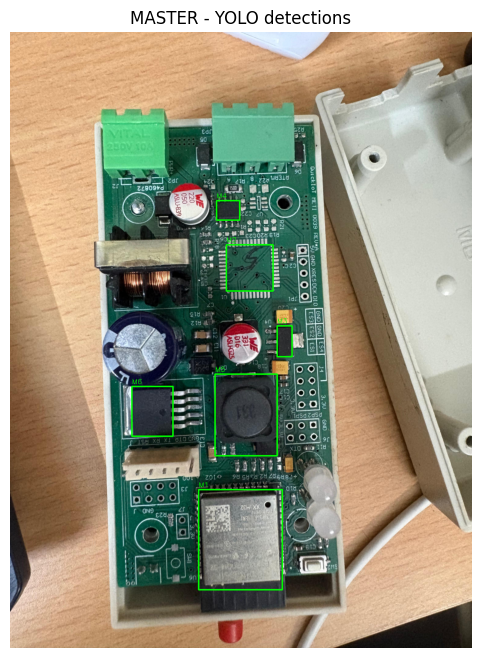

Saved master detections JSON.

Running YOLO on TEST image...
YOLO (test) inference time: 0.02s
YOLO found 7 boxes on TEST.


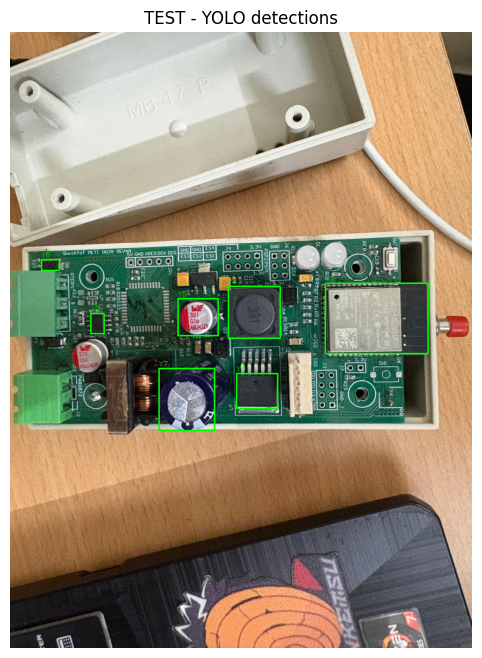

Saved test YOLO detections JSON.

Loading lightweight SAM model (MobileSAM preferred). This step may take ~30-60s depending on network and GPU.
MobileSAM registry load failed; will fallback to segment-anything ViT-B.
Falling back to optimized Segment Anything (ViT-B). Downloading checkpoint (~360MB) if not present...


NameError: name 'sam_model_registry' is not defined

In [1]:
# ==============================================================
# Robust PCB comparison pipeline: YOLO (master) -> (test) YOLO + SAM (MobileSAM preferred, ViT-B fallback) -> OpenCV -> compare
# ==============================================================
# Run this whole cell in Google Colab

# ----------------------------
# Install dependencies
# ----------------------------
!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision
# Try to install MobileSAM; if this fails it's okay, script will fall back to optimized ViT-B
!pip install -q git+https://github.com/ChaoningZhang/MobileSAM.git || true
!pip install -q segment-anything || true

# ----------------------------
# Imports
# ----------------------------
import os, sys, time, json, math
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files, drive
from ultralytics import YOLO
import torch

# We'll try to import MobileSAM (preferred). If unavailable, we use segment_anything's ViT-B (optimized).
use_mobilesam = False
try:
    from mobile_sam import sam_model_registry as mobile_sam_registry, SamAutomaticMaskGenerator as MobileSamMaskGen
    use_mobilesam = True
    print("MobileSAM package available — will attempt to use MobileSAM.")
except Exception as e:
    print("MobileSAM not available or import failed. Will attempt optimized SegmentAnything ViT-B fallback.")
    # import SAM from segment_anything
    try:
        from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
    except Exception as e2:
        print("segment-anything import failed. Please ensure segment-anything is installed.")
        raise

# ----------------------------
# Configs & output folders
# ----------------------------
OUT_DIR = "/content/pcb_output"
CROP_DIR = os.path.join(OUT_DIR, "crops")
os.makedirs(CROP_DIR, exist_ok=True)
os.makedirs(OUT_DIR, exist_ok=True)

# Parameters (tweak if desired)
MAX_IMAGE_SIZE = 1200        # max long side (px) to reduce RAM usage
YOLO_CONF = 0.55             # YOLO confidence threshold
SAM_POINTS_PER_SIDE = 8      # SAM sampling density (lower = faster)
SAM_MIN_MASK_AREA = 800      # ignore tiny SAM masks (px area)
IOU_MATCH_THRESHOLD = 0.45   # IoU threshold to consider match

# ----------------------------
# Mount Drive
# ----------------------------
drive.mount('/content/drive', force_remount=True)
print("Drive mounted.")

# ----------------------------
# Auto-find latest best.pt in Drive
# ----------------------------
search_root = "/content/drive/My Drive/YOLO"
found_models = []
for root, dirs, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            found_models.append(os.path.join(root, f))
if not found_models:
    raise FileNotFoundError("No best.pt found under /content/drive/My Drive/YOLO — please place your YOLO 'best.pt' in that folder or change search_root.")
MODEL_PATH = sorted(found_models, key=os.path.getmtime, reverse=True)[0]
print("Using YOLO model:", MODEL_PATH)

# Load YOLO (lightweight call)
yolo_model = YOLO(MODEL_PATH)
print("YOLO model loaded.")

# ----------------------------
# Helper functions
# ----------------------------
def resize_keep_aspect(img, max_side):
    h, w = img.shape[:2]
    scale = float(max_side) / max(h, w)
    if scale < 1.0:
        new_w = int(round(w * scale))
        new_h = int(round(h * scale))
        return cv2.resize(img, (new_w, new_h), interpolation=cv2.INTER_AREA), scale
    else:
        return img, 1.0

def draw_boxes_on_image(img, boxes, color=(0,255,0), thickness=2, label_prefix=None):
    out = img.copy()
    for i, b in enumerate(boxes):
        x1,y1,x2,y2 = map(int, b[:4])
        cv2.rectangle(out, (x1,y1),(x2,y2), color, thickness)
        if label_prefix is not None:
            cv2.putText(out, f"{label_prefix}{i+1}", (x1, max(10,y1-5)), cv2.FONT_HERSHEY_SIMPLEX, 0.45, color, 1)
    return out

def compute_iou(boxA, boxB):
    # boxes as (x1,y1,x2,y2)
    xA = max(boxA[0], boxB[0]); yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2]); yB = min(boxA[3], boxB[3])
    interW = max(0, xB - xA); interH = max(0, yB - yA)
    inter = interW * interH
    areaA = max(0, (boxA[2]-boxA[0])) * max(0,(boxA[3]-boxA[1]))
    areaB = max(0, (boxB[2]-boxB[0])) * max(0,(boxB[3]-boxB[1]))
    denom = float(areaA + areaB - inter + 1e-9)
    if denom == 0:
        return 0.0
    return inter/denom

def save_crops(image_bgr, boxes, prefix):
    saved = []
    for i, b in enumerate(boxes):
        x1,y1,x2,y2 = map(int, b[:4])
        crop = image_bgr[y1:y2, x1:x2]
        if crop.size == 0:
            continue
        p = os.path.join(CROP_DIR, f"{prefix}_crop_{i+1}.png")
        cv2.imwrite(p, crop)
        saved.append(p)
    return saved

# ----------------------------
# Step 0: Upload two images: master (first) and test (second)
# ----------------------------
print("\nUpload MASTER and TEST PCB image files (upload MASTER first, then TEST).")
uploaded = files.upload()
uploaded_paths = list(uploaded.keys())
if len(uploaded_paths) < 2:
    raise ValueError("Please upload two images: MASTER and TEST (in that order).")

master_path = uploaded_paths[0]
test_path = uploaded_paths[1]

master_bgr = cv2.imread(master_path)
test_bgr = cv2.imread(test_path)
if master_bgr is None or test_bgr is None:
    raise ValueError("Failed to read uploaded images. Ensure they are valid image files.")

# Resize both images to limit memory
master_bgr_resized, scale_master = resize_keep_aspect(master_bgr, MAX_IMAGE_SIZE)
test_bgr_resized, scale_test = resize_keep_aspect(test_bgr, MAX_IMAGE_SIZE)
print(f"Master resized scale: {scale_master:.3f}, Test resized scale: {scale_test:.3f}")

# Convert to RGB for YOLO inference/display
master_rgb = cv2.cvtColor(master_bgr_resized, cv2.COLOR_BGR2RGB)
test_rgb = cv2.cvtColor(test_bgr_resized, cv2.COLOR_BGR2RGB)

# ----------------------------
# Step 1: YOLO detection on MASTER (fast, no SAM)
# ----------------------------
print("\nRunning YOLO on MASTER image...")
t0 = time.time()
res_master = yolo_model.predict(source=master_rgb, conf=YOLO_CONF, verbose=False)
t1 = time.time()
print(f"YOLO (master) inference time: {t1-t0:.2f}s")

master_boxes = []
if len(res_master) > 0:
    r = res_master[0]
    for box in r.boxes:
        conf = float(box.conf)
        if conf < YOLO_CONF: continue
        x1,y1,x2,y2 = box.xyxy[0].cpu().numpy().astype(int)
        master_boxes.append((int(x1), int(y1), int(x2), int(y2)))
print(f"YOLO found {len(master_boxes)} boxes on MASTER.")

master_detected_vis = draw_boxes_on_image(master_rgb, [(x1,y1,x2,y2) for (x1,y1,x2,y2) in master_boxes], color=(0,255,0), label_prefix="M")
plt.figure(figsize=(8,8)); plt.imshow(master_detected_vis); plt.axis('off'); plt.title("MASTER - YOLO detections"); display(plt.gcf()); plt.close()

# Save master JSON (boxes scaled back to original full-size coords)
master_boxes_orig_scale = []
for (x1,y1,x2,y2) in master_boxes:
    # convert to original image coordinates if we resized
    inv_scale = 1.0/scale_master
    master_boxes_orig_scale.append([int(round(x1*inv_scale)), int(round(y1*inv_scale)), int(round((x2-x1)*inv_scale)), int(round((y2-y1)*inv_scale))])
master_json = {"components": [{"id": f"M{i+1}", "position": pos} for i,pos in enumerate(master_boxes_orig_scale)]}
with open(os.path.join(OUT_DIR, "master_yolo_boxes.json"), "w") as f:
    json.dump(master_json, f, indent=2)
print("Saved master detections JSON.")

# Free YOLO result objects if needed
del res_master
torch.cuda.empty_cache()

# ----------------------------
# Step 2: YOLO detection on TEST (initial)
# ----------------------------
print("\nRunning YOLO on TEST image...")
t0 = time.time()
res_test = yolo_model.predict(source=test_rgb, conf=YOLO_CONF, verbose=False)
t1 = time.time()
print(f"YOLO (test) inference time: {t1-t0:.2f}s")

test_yolo_boxes = []
if len(res_test) > 0:
    r = res_test[0]
    for box in r.boxes:
        conf = float(box.conf)
        if conf < YOLO_CONF: continue
        x1,y1,x2,y2 = box.xyxy[0].cpu().numpy().astype(int)
        test_yolo_boxes.append((int(x1), int(y1), int(x2), int(y2)))
print(f"YOLO found {len(test_yolo_boxes)} boxes on TEST.")

# Visualize YOLO boxes for test
test_yolo_vis = draw_boxes_on_image(test_rgb, test_yolo_boxes, color=(0,255,0), label_prefix="Y")
plt.figure(figsize=(8,8)); plt.imshow(test_yolo_vis); plt.axis('off'); plt.title("TEST - YOLO detections"); display(plt.gcf()); plt.close()

# Save test YOLO JSON (orig scale)
test_boxes_orig_scale = []
for (x1,y1,x2,y2) in test_yolo_boxes:
    inv_scale = 1.0/scale_test
    test_boxes_orig_scale.append([int(round(x1*inv_scale)), int(round(y1*inv_scale)), int(round((x2-x1)*inv_scale)), int(round((y2-y1)*inv_scale))])
test_json = {"components": [{"id": f"T{i+1}", "position": pos} for i,pos in enumerate(test_boxes_orig_scale)]}
with open(os.path.join(OUT_DIR, "test_yolo_boxes.json"), "w") as f:
    json.dump(test_json, f, indent=2)
print("Saved test YOLO detections JSON.")

# ----------------------------
# Prepare mask of YOLO-covered regions on test (to avoid reprocessing those)
# ----------------------------
mask_yolo = np.zeros(test_rgb.shape[:2], dtype=np.uint8)
for (x1,y1,x2,y2) in test_yolo_boxes:
    cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)

# ----------------------------
# Step 3: Load lightweight SAM (MobileSAM preferred)
# ----------------------------
print("\nLoading lightweight SAM model (MobileSAM preferred). This step may take ~30-60s depending on network and GPU.")
sam = None
mask_generator = None

if use_mobilesam:
    try:
        # Try to download a pretrained MobileSAM checkpoint to /content (if not present)
        mobile_ckpt = "/content/mobile_sam.pth"
        if not os.path.exists(mobile_ckpt):
            # MobileSAM repo may provide checkpoints; if not present, this will skip and fallback
            # We attempt to download a commonly used checkpoint (if available). If not, we'll fallback.
            !wget -q -O /content/mobile_sam.pth https://github.com/ChaoningZhang/MobileSAM/releases/download/v0.0.1/mobilesam_vit_t.pth || true
        # Try to load MobileSAM
        sam = mobile_sam_registry.get("mobile_sam") if hasattr(mobile_sam_registry, "get") else mobile_sam_registry["vit_t"]
        # mobile_sam registry API varies: try both styles
        try:
            sam = mobile_sam_registry["vit_t"](checkpoint=mobile_ckpt)
        except Exception:
            try:
                sam = mobile_sam_registry["mobile_sam"](checkpoint=mobile_ckpt)
            except Exception:
                sam = None
        if sam is not None:
            mask_generator = MobileSamMaskGen(sam, points_per_side=SAM_POINTS_PER_SIDE, min_mask_region_area=SAM_MIN_MASK_AREA)
            print("MobileSAM loaded and mask generator created.")
        else:
            print("MobileSAM registry load failed; will fallback to segment-anything ViT-B.")
    except Exception as e:
        print("MobileSAM load attempt failed with:", e)
        sam = None

# If MobileSAM not loaded, fallback to optimized ViT-B from segment_anything
if sam is None:
    print("Falling back to optimized Segment Anything (ViT-B). Downloading checkpoint (~360MB) if not present...")
    sam_ckpt = "/content/sam_vit_b_01ec64.pth"
    if not os.path.exists(sam_ckpt):
        !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}
    sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
    mask_generator = SamAutomaticMaskGenerator(
        sam,
        points_per_side=SAM_POINTS_PER_SIDE,
        pred_iou_thresh=0.90,
        stability_score_thresh=0.95,
        crop_n_layers=0,
        min_mask_region_area=SAM_MIN_MASK_AREA
    )
    print("Loaded segment-anything ViT-B with optimized settings.")

# Free optionally heavy objects
torch.cuda.empty_cache()

# ----------------------------
# Step 4: Run SAM only on uncovered regions of TEST
# ----------------------------
print("\nRunning SAM on uncovered regions of TEST (skipping YOLO-covered areas)...")
# Create inverse mask where we want SAM to try (1 where uncovered)
inverse_mask = cv2.bitwise_not(mask_yolo)
uncovered_rgb = cv2.bitwise_and(test_rgb, test_rgb, mask=inverse_mask)

# If uncovered area is mostly blank, skip SAM
if np.count_nonzero(inverse_mask) < 1000:
    print("Uncovered area too small — skipping SAM. (No uncovered regions)")
    sam_new_boxes = []
else:
    t0 = time.time()
    try:
        sam_masks = mask_generator.generate(uncovered_rgb)
    except Exception as e:
        print("SAM mask_generator.generate failed:", e)
        sam_masks = []
    t1 = time.time()
    print(f"SAM on uncovered regions took {t1-t0:.2f}s and returned {len(sam_masks)} masks (before filtering).")

    # Convert masks to bounding boxes, filter overlaps with YOLO and tiny areas
    sam_new_boxes = []
    for m in sam_masks:
        seg = m["segmentation"].astype('uint8')
        x, y, w, h = cv2.boundingRect(seg)
        if w*h < SAM_MIN_MASK_AREA:
            continue
        # check overlap with YOLO-covered mask to avoid boxing already boxed regions
        if np.any(mask_yolo[y:y+h, x:x+w] > 0):
            continue
        sam_new_boxes.append((x, y, x+w, y+h))

print(f"SAM added {len(sam_new_boxes)} boxes (non-overlapping with YOLO).")

# Draw SAM boxes
sam_vis = draw_boxes_on_image(test_rgb, sam_new_boxes, color=(255,0,0), label_prefix="S")
plt.figure(figsize=(8,8)); plt.imshow(sam_vis); plt.axis('off'); plt.title("TEST - SAM-added boxes"); display(plt.gcf()); plt.close()

# ----------------------------
# Step 5: OpenCV edge-based backup on uncovered area to find anything SAM/YOLO missed
# ----------------------------
print("\nRunning OpenCV edge/contour detection on uncovered regions as backup...")
gray = cv2.cvtColor(test_rgb, cv2.COLOR_RGB2GRAY)
edges = cv2.Canny(gray, 70, 160)
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
opencv_new_boxes = []
for c in contours:
    x,y,w,h = cv2.boundingRect(c)
    if w*h < 2000:  # skip tiny
        continue
    # skip if overlaps YOLO or SAM boxes
    overlap = False
    for bx in test_yolo_boxes:
        if compute_iou((x,y,x+w,y+h), bx) > 0.3:
            overlap = True; break
    if overlap:
        continue
    for bx in sam_new_boxes:
        if compute_iou((x,y,x+w,y+h), bx) > 0.3:
            overlap = True; break
    if overlap:
        continue
    opencv_new_boxes.append((x,y,x+w,y+h))
print(f"OpenCV added {len(opencv_new_boxes)} boxes.")

# Visualize all test boxes combined
all_test_boxes = test_yolo_boxes + sam_new_boxes + opencv_new_boxes
combined_vis = test_rgb.copy()
for (x1,y1,x2,y2) in test_yolo_boxes:
    cv2.rectangle(combined_vis, (x1,y1),(x2,y2), (0,255,0), 2)
for (x1,y1,x2,y2) in sam_new_boxes:
    cv2.rectangle(combined_vis, (x1,y1),(x2,y2), (255,0,0), 2)
for (x1,y1,x2,y2) in opencv_new_boxes:
    cv2.rectangle(combined_vis, (x1,y1),(x2,y2), (255,255,0), 1)
plt.figure(figsize=(10,10)); plt.imshow(combined_vis); plt.axis('off'); plt.title("TEST - Combined YOLO (G) / SAM (B) / OpenCV (Y)"); display(plt.gcf()); plt.close()
cv2.imwrite(os.path.join(OUT_DIR, "test_combined_boxes.png"), cv2.cvtColor(combined_vis, cv2.COLOR_RGB2BGR))

# ----------------------------
# Step 6: Save crops for MASTER and TEST (all detected)
# ----------------------------
print("\nSaving cropped components for MASTER and TEST...")
# Convert master/test back to BGR resized versions to save crops
master_bgr_r = cv2.cvtColor(master_rgb, cv2.COLOR_RGB2BGR)
test_bgr_r = cv2.cvtColor(test_rgb, cv2.COLOR_RGB2BGR)

master_crop_files = save_crops(master_bgr_r, master_boxes, "MASTER")
test_crop_files = save_crops(test_bgr_r, all_test_boxes, "TEST")
print(f"Saved {len(master_crop_files)} master crops and {len(test_crop_files)} test crops to {CROP_DIR}")

# ----------------------------
# Step 7: Compare MASTER boxes vs TEST boxes (IoU matching)
# We'll rescale master boxes to the test resized coordinate space if needed (both were resized separately).
# For simplicity, we compare in original-image coordinates: convert both sets to original scale.
# ----------------------------
print("\nComparing MASTER -> TEST to find missing components...")

# master_boxes_orig_scale already saved earlier (x,y,w,h). Convert to x1,y1,x2,y2
master_boxes_orig_xyxy = []
for pos in master_json["components"]:
    x,y,w,h = pos["position"]
    master_boxes_orig_xyxy.append((x, y, x+w, y+h))

# test combined boxes in original scale
test_boxes_orig_xyxy = []
# We combined test_yolo_boxes (resized coords) + sam_new_boxes + opencv_new_boxes (all in resized coords).
# Convert each from resized test image coordinates to original test image coordinates using inv_scale:
inv_scale_test = 1.0/scale_test
for (x1,y1,x2,y2) in all_test_boxes:
    x = int(round(x1 * inv_scale_test)); y = int(round(y1 * inv_scale_test))
    x2o = int(round(x2 * inv_scale_test)); y2o = int(round(y2 * inv_scale_test))
    test_boxes_orig_xyxy.append((x, y, x2o, y2o))

missing_master_boxes = []
for mb in master_boxes_orig_xyxy:
    matched = False
    for tb in test_boxes_orig_xyxy:
        if compute_iou(mb, tb) >= IOU_MATCH_THRESHOLD:
            matched = True
            break
    if not matched:
        missing_master_boxes.append(mb)

# ----------------------------
# Step 8: Visualize final comparison on ORIGINAL (TEST) image
# ----------------------------
final_vis = test_bgr.copy()  # original test image in BGR
if len(missing_master_boxes) == 0:
    cv2.putText(final_vis, "✅ GOOD BOARD", (50,80), cv2.FONT_HERSHEY_SIMPLEX, 2.2, (0,255,0), 5)
    print("GOOD BOARD: All master components matched on test board.")
else:
    for (x1,y1,x2,y2) in missing_master_boxes:
        # draw red rectangle on the test image in original coordinates
        cv2.rectangle(final_vis, (x1,y1),(x2,y2), (0,0,255), 4)
        cv2.putText(final_vis, "MISSING", (x1, max(30,y1-10)), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,0,255), 3)
    cv2.putText(final_vis, "❌ DEFECTIVE BOARD", (50,80), cv2.FONT_HERSHEY_SIMPLEX, 2.2, (0,0,255), 5)
    print(f"DEFECTIVE BOARD: {len(missing_master_boxes)} missing components.")

out_final_path = os.path.join(OUT_DIR, "final_comparison_result.png")
cv2.imwrite(out_final_path, final_vis)
print("Saved final comparison image to:", out_final_path)

# Save JSON report listing missing components (with coordinates)
report = {
    "master_count": len(master_boxes_orig_xyxy),
    "test_count": len(test_boxes_orig_xyxy),
    "missing_count": len(missing_master_boxes),
    "missing_boxes": [{"x1":b[0],"y1":b[1],"x2":b[2],"y2":b[3]} for b in missing_master_boxes]
}
with open(os.path.join(OUT_DIR, "comparison_report.json"), "w") as f:
    json.dump(report, f, indent=2)

print("\nAll outputs saved in:", OUT_DIR)
print("You can download the final image(s) and crops from the Colab file browser or /content/pcb_output")


  Preparing metadata (setup.py) ... done
Mounted at /content/drive
✅ Drive mounted!
✅ Using model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📸 Upload MASTER and TEST PCB images:


Saving dummy.jpg to dummy (3).jpg
Saving dummy1.jpg to dummy1 (3).jpg
✅ Images loaded.

🔵 Loading SAM (MobileSAM preferred)...
⚠️ MobileSAM failed, using Segment Anything ViT-B fallback...
✅ Loaded ViT-B SAM (optimized).

🟩 Running MASTER (YOLO only)...


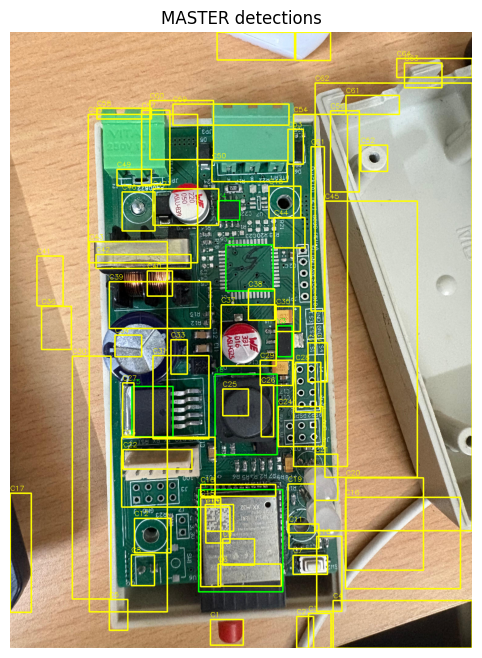


🟦 Running TEST (YOLO+SAM+OpenCV)...


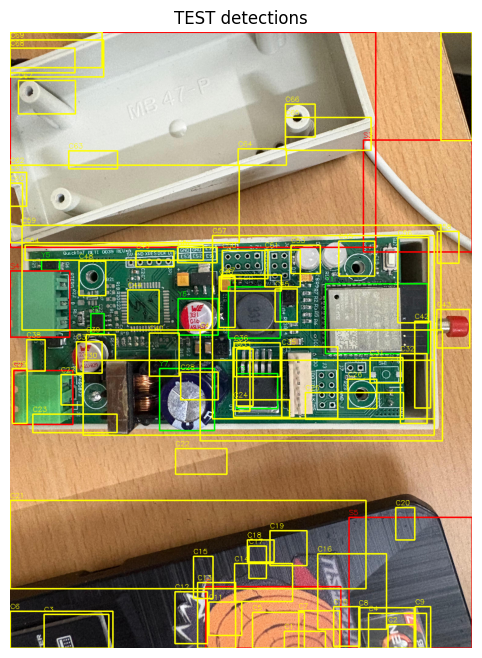

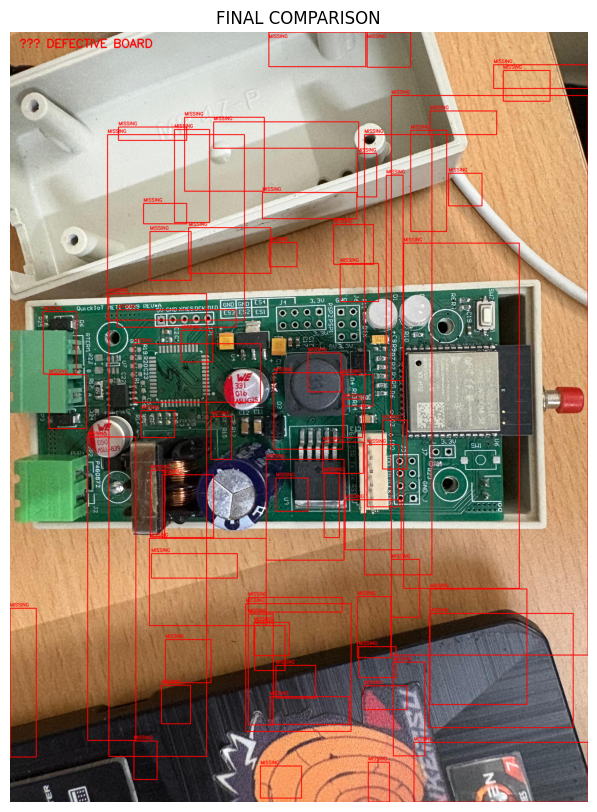


📁 Outputs saved in /content/pcb_output
❌ DEFECTIVE BOARD — 69 missing


In [2]:
# ==============================================================
# 🧠 PCB COMPONENT COMPARISON — YOLO + MobileSAM (fallback: SAM ViT-B) + OpenCV
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision
!pip install -q git+https://github.com/ChaoningZhang/MobileSAM.git || true
!pip install -q segment-anything || true

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, time, torch
from ultralytics import YOLO
from google.colab import files, drive

# ==============================================================
# ⚙️ SETUP
# ==============================================================
OUT_DIR = "/content/pcb_output"
CROP_DIR = f"{OUT_DIR}/crops"
os.makedirs(OUT_DIR, exist_ok=True)
os.makedirs(CROP_DIR, exist_ok=True)

MAX_SIZE = 1200
YOLO_CONF = 0.55
SAM_POINTS = 8
SAM_MIN_AREA = 800
IOU_THRESH = 0.45

drive.mount('/content/drive', force_remount=True)
print("✅ Drive mounted!")

# ==============================================================
# 🔍 FIND YOLO MODEL
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found = []
for r, d, f in os.walk(search_root):
    for fn in f:
        if fn == "best.pt":
            found.append(os.path.join(r, fn))
if not found:
    raise FileNotFoundError("❌ No best.pt found in Drive.")
MODEL_PATH = sorted(found, key=os.path.getmtime, reverse=True)[0]
print("✅ Using model:", MODEL_PATH)
yolo = YOLO(MODEL_PATH)

# ==============================================================
# 📤 UPLOAD IMAGES
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
if len(uploaded) < 2:
    raise ValueError("Upload 2 images: MASTER first, TEST second.")
master_img = cv2.imread(list(uploaded.keys())[0])
test_img = cv2.imread(list(uploaded.keys())[1])
print("✅ Images loaded.")

def resize(img, max_side=MAX_SIZE):
    h,w = img.shape[:2]
    s = max_side / max(h,w)
    return (cv2.resize(img, (int(w*s), int(h*s))) if s<1 else img), s

def draw_boxes(img, boxes, color, label):
    for i,(x1,y1,x2,y2) in enumerate(boxes):
        cv2.rectangle(img, (x1,y1),(x2,y2), color, 2)
        cv2.putText(img, f"{label}{i+1}", (x1,y1-5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.45, color, 1)
    return img

def iou(a,b):
    xA,yA=max(a[0],b[0]),max(a[1],b[1])
    xB,yB=min(a[2],b[2]),min(a[3],b[3])
    inter=max(0,xB-xA)*max(0,yB-yA)
    return inter/float((a[2]-a[0])*(a[3]-a[1])+(b[2]-b[0])*(b[3]-b[1])-inter+1e-9)

# ==============================================================
# 🧩 YOLO DETECTION FUNCTION
# ==============================================================
def detect_yolo(img_rgb, conf=YOLO_CONF):
    res = yolo.predict(source=img_rgb, conf=conf, verbose=False)
    boxes=[]
    for r in res:
        for b in r.boxes:
            if float(b.conf)<conf: continue
            x1,y1,x2,y2 = map(int,b.xyxy[0].cpu().numpy())
            boxes.append((x1,y1,x2,y2))
    return boxes

# ==============================================================
# 🧠 LOAD SAM (MobileSAM preferred)
# ==============================================================
print("\n🔵 Loading SAM (MobileSAM preferred)...")
use_mobilesam=False
try:
    from mobile_sam import sam_model_registry as mreg, SamAutomaticMaskGenerator as MSGen
    ck="/content/mobile_sam.pth"
    if not os.path.exists(ck):
        !wget -q -O /content/mobile_sam.pth https://github.com/ChaoningZhang/MobileSAM/releases/download/v0.0.1/mobilesam_vit_t.pth || true
    sam=mreg["vit_t"](checkpoint=ck)
    mask_gen=MSGen(sam,points_per_side=SAM_POINTS,min_mask_region_area=SAM_MIN_AREA)
    use_mobilesam=True
    print("✅ MobileSAM loaded.")
except Exception as e:
    print("⚠️ MobileSAM failed, using Segment Anything ViT-B fallback...")
    from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
    ck="/content/sam_vit_b_01ec64.pth"
    if not os.path.exists(ck):
        !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {ck}
    sam=sam_model_registry["vit_b"](checkpoint=ck)
    mask_gen=SamAutomaticMaskGenerator(
        sam,points_per_side=SAM_POINTS,
        pred_iou_thresh=0.9,stability_score_thresh=0.95,
        crop_n_layers=0,min_mask_region_area=SAM_MIN_AREA)
    print("✅ Loaded ViT-B SAM (optimized).")

# ==============================================================
# 🧠 PIPELINE FUNCTION
# ==============================================================
def full_detect(img_bgr, label, run_sam=True):
    img_rgb=cv2.cvtColor(img_bgr,cv2.COLOR_BGR2RGB)
    img_rgb,s=resize(img_rgb)
    boxes_y=detect_yolo(img_rgb)
    mask=np.zeros(img_rgb.shape[:2],np.uint8)
    for (x1,y1,x2,y2) in boxes_y:
        cv2.rectangle(mask,(x1,y1),(x2,y2),255,-1)
    boxes_s=[]
    if run_sam:
        inv=cv2.bitwise_not(mask)
        uncov=cv2.bitwise_and(img_rgb,img_rgb,mask=inv)
        masks=mask_gen.generate(uncov)
        for m in masks:
            seg=m["segmentation"].astype('uint8')
            x,y,w,h=cv2.boundingRect(seg)
            if np.any(mask[y:y+h,x:x+w]>0) or w*h<SAM_MIN_AREA: continue
            boxes_s.append((x,y,x+w,y+h))
    gray=cv2.cvtColor(img_rgb,cv2.COLOR_RGB2GRAY)
    edges=cv2.Canny(gray,60,150)
    conts,_=cv2.findContours(edges,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    boxes_c=[]
    for c in conts:
        x,y,w,h=cv2.boundingRect(c)
        if w*h<2000: continue
        if any(iou((x,y,x+w,y+h),b)>0.3 for b in boxes_y+boxes_s): continue
        boxes_c.append((x,y,x+w,y+h))
    allb=boxes_y+boxes_s+boxes_c
    vis=img_rgb.copy()
    vis=draw_boxes(vis,boxes_y,(0,255,0),"Y")
    vis=draw_boxes(vis,boxes_s,(255,0,0),"S")
    vis=draw_boxes(vis,boxes_c,(255,255,0),"C")
    plt.figure(figsize=(8,8));plt.imshow(vis);plt.axis('off');plt.title(f"{label} detections");plt.show()
    return allb,s,img_bgr

# ==============================================================
# 🚀 RUN PIPELINE
# ==============================================================
print("\n🟩 Running MASTER (YOLO only)...")
master_boxes,sm,mbgr=full_detect(master_img,"MASTER",run_sam=False)
print("\n🟦 Running TEST (YOLO+SAM+OpenCV)...")
test_boxes,st,tbgr=full_detect(test_img,"TEST",run_sam=True)

# ==============================================================
# 🔁 COMPARE MASTER vs TEST
# ==============================================================
inv_scale=lambda b,s:(int(b[0]/s),int(b[1]/s),int(b[2]/s),int(b[3]/s))
master_orig=[inv_scale(b,sm) for b in master_boxes]
test_orig=[inv_scale(b,st) for b in test_boxes]
missing=[]
for m in master_orig:
    if not any(iou(m,t)>IOU_THRESH for t in test_orig):
        missing.append(m)

# ==============================================================
# 🖼️ VISUALIZE COMPARISON
# ==============================================================
final=tbgr.copy()
if not missing:
    cv2.putText(final,"✅ GOOD BOARD",(50,80),cv2.FONT_HERSHEY_SIMPLEX,2.0,(0,255,0),5)
else:
    for (x1,y1,x2,y2) in missing:
        cv2.rectangle(final,(x1,y1),(x2,y2),(0,0,255),4)
        cv2.putText(final,"MISSING",(x1,max(30,y1-10)),cv2.FONT_HERSHEY_SIMPLEX,0.8,(0,0,255),2)
    cv2.putText(final,"❌ DEFECTIVE BOARD",(50,80),cv2.FONT_HERSHEY_SIMPLEX,2.0,(0,0,255),5)

plt.figure(figsize=(10,10));plt.imshow(cv2.cvtColor(final,cv2.COLOR_BGR2RGB))
plt.axis('off');plt.title("FINAL COMPARISON");plt.show()

cv2.imwrite(f"{OUT_DIR}/final_comparison.png",final)
rep={"master_components":len(master_boxes),
     "test_components":len(test_boxes),
     "missing_components":len(missing),
     "missing_boxes":[{"x1":b[0],"y1":b[1],"x2":b[2],"y2":b[3]} for b in missing]}
json.dump(rep,open(f"{OUT_DIR}/report.json","w"),indent=2)
print(f"\n📁 Outputs saved in {OUT_DIR}")
print(("✅ GOOD BOARD" if not missing else f"❌ DEFECTIVE BOARD — {len(missing)} missing"))


In [ ]:
# ==============================================================
# 🧠 PCB COMPONENT COMPARISON — YOLO + SAM + OpenCV + Cropping + Matching
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ==============================================================
# 🧩 Imports
# ==============================================================
import os, cv2, json, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output"
CROP_DIR = f"{OUT_DIR}/crops"
os.makedirs(CROP_DIR, exist_ok=True)

drive.mount('/content/drive', force_remount=True)
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Load YOLO model
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found_models = []
for root, dirs, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            found_models.append(os.path.join(root, f))
if not found_models:
    raise FileNotFoundError("❌ No best.pt found in your Drive.")
MODEL_PATH = sorted(found_models, key=os.path.getmtime, reverse=True)[0]
print(f"✅ Using YOLO model: {MODEL_PATH}")
model = YOLO(MODEL_PATH)

# ==============================================================
# 📤 Upload two PCB images: MASTER and TEST
# ==============================================================
print("📸 Please upload two PCB images (MASTER first, TEST second):")
uploaded = files.upload()
if len(uploaded) < 2:
    raise ValueError("❌ Please upload both MASTER and TEST images.")

paths = list(uploaded.keys())
master_img = cv2.imread(paths[0])
test_img = cv2.imread(paths[1])

if master_img is None or test_img is None:
    raise ValueError("❌ Failed to load one or both images.")

print(f"✅ Images loaded:\nMASTER → {paths[0]}\nTEST → {paths[1]}")

# ==============================================================
# ⚙️ Helper Functions
# ==============================================================
def run_detection_pipeline(image_rgb, model, conf=0.6):
    """YOLO + SAM + OpenCV detection pipeline for a single image"""
    # --- YOLO Detection ---
    yolo_results = model.predict(source=image_rgb, conf=conf, verbose=False)
    yolo_boxes = []
    for result in yolo_results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0].cpu().numpy())
            conf = float(box.conf)
            if conf > 0.6:
                yolo_boxes.append((x1, y1, x2, y2))

    mask_yolo = np.zeros(image_rgb.shape[:2], dtype=np.uint8)
    for (x1, y1, x2, y2) in yolo_boxes:
        cv2.rectangle(mask_yolo, (x1, y1), (x2, y2), 255, -1)

    # --- SAM Detection ---
    sam_path = "sam_vit_b.pth"
    if not os.path.exists(sam_path):
        !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth
    sam = sam_model_registry["vit_b"](checkpoint=sam_path)
    mask_generator = SamAutomaticMaskGenerator(
        sam,
        points_per_side=8,
        pred_iou_thresh=0.9,
        stability_score_thresh=0.95,
        crop_n_layers=0,
        min_mask_region_area=1000
    )
    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(image_rgb, image_rgb, mask=inverse_mask)
    masks = mask_generator.generate(uncovered)

    sam_boxes = []
    for m in masks:
        seg = m["segmentation"].astype('uint8')
        x, y, w, h = cv2.boundingRect(seg)
        overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
        if not overlap and w*h > 1000:
            sam_boxes.append((x, y, x+w, y+h))

    # --- OpenCV Edge-based Backup ---
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 60, 150)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    opencv_boxes = []
    for c in contours:
        x, y, w, h = cv2.boundingRect(c)
        overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
        if w*h > 2000 and not overlap:
            opencv_boxes.append((x, y, x+w, y+h))

    # --- Combine All Boxes ---
    all_boxes = yolo_boxes + sam_boxes + opencv_boxes
    return all_boxes, yolo_boxes, sam_boxes, opencv_boxes

def iou(boxA, boxB):
    """Compute IoU (Intersection over Union)"""
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    inter = max(0, xB - xA) * max(0, yB - yA)
    areaA = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    areaB = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])
    return inter / float(areaA + areaB - inter + 1e-6)

# ==============================================================
# 🧩 Run Detection on Both Boards
# ==============================================================
print("🟩 Running MASTER detection...")
master_rgb = cv2.cvtColor(master_img, cv2.COLOR_BGR2RGB)
master_all, master_yolo, master_sam, master_cv = run_detection_pipeline(master_rgb, model)

print("🟦 Running TEST detection...")
test_rgb = cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB)
test_all, test_yolo, test_sam, test_cv = run_detection_pipeline(test_rgb, model)

# ==============================================================
# 🔁 Comparison (IOU Matching)
# ==============================================================
missing_boxes = []
for mb in master_all:
    matched = any(iou(mb, tb) > 0.5 for tb in test_all)
    if not matched:
        missing_boxes.append(mb)

# ==============================================================
# 🖼️ Visualization
# ==============================================================
final = test_rgb.copy()
# Draw YOLO (Green)
for (x1, y1, x2, y2) in test_yolo:
    cv2.rectangle(final, (x1, y1), (x2, y2), (0, 255, 0), 2)
# Draw SAM (Blue)
for (x1, y1, x2, y2) in test_sam:
    cv2.rectangle(final, (x1, y1), (x2, y2), (255, 0, 0), 2)
# Draw OpenCV (Yellow)
for (x1, y1, x2, y2) in test_cv:
    cv2.rectangle(final, (x1, y1), (x2, y2), (255, 255, 0), 1)

if len(missing_boxes) == 0:
    cv2.putText(final, "✅ GOOD BOARD", (50, 80), cv2.FONT_HERSHEY_SIMPLEX, 2, (0,255,0), 4)
else:
    for (x1, y1, x2, y2) in missing_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (0, 0, 255), 3)
        cv2.putText(final, "MISSING", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,0,255), 2)
    cv2.putText(final, "❌ DEFECTIVE BOARD", (50, 80), cv2.FONT_HERSHEY_SIMPLEX, 2, (0,0,255), 4)

plt.figure(figsize=(10, 10))
plt.imshow(final)
plt.axis('off')
plt.title("PCB Comparison Result")
plt.show()

cv2.imwrite(f"{OUT_DIR}/final_comparison_result.png", cv2.cvtColor(final, cv2.COLOR_RGB2BGR))
print(f"💾 Result saved at: {OUT_DIR}/final_comparison_result.png")

# ==============================================================
# ✂️ Cropping Components
# ==============================================================
print("✂️ Cropping all detected regions...")
for i, (x1, y1, x2, y2) in enumerate(test_all):
    crop = test_img[y1:y2, x1:x2]
    if crop.size == 0: continue
    cv2.imwrite(f"{CROP_DIR}/component_{i}.png", crop)
print(f"✅ Cropped {len(test_all)} components to: {CROP_DIR}")


Mounted at /content/drive
✅ Google Drive mounted successfully!
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📸 Please upload two PCB images (MASTER first, TEST second):


Saving dummy.jpg to dummy (4).jpg
Saving dummy1.jpg to dummy1 (4).jpg
✅ Images loaded:
MASTER → dummy (4).jpg
TEST → dummy1 (4).jpg
🟩 Running MASTER detection...


  Preparing metadata (setup.py) ... done
Mounted at /content/drive
✅ Drive mounted!
✅ Using model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📸 Upload MASTER and TEST PCB images:


Saving dummy.jpg to dummy (6).jpg
Saving dummy1.jpg to dummy1 (6).jpg
✅ Images loaded.

🔵 Loading SAM (MobileSAM preferred)...
⬇️ Downloading MobileSAM checkpoint...
⚠️ MobileSAM failed, falling back to Segment Anything ViT-B...
✅ Loaded fallback SAM (ViT-B).

🟩 Running MASTER (YOLO only)...


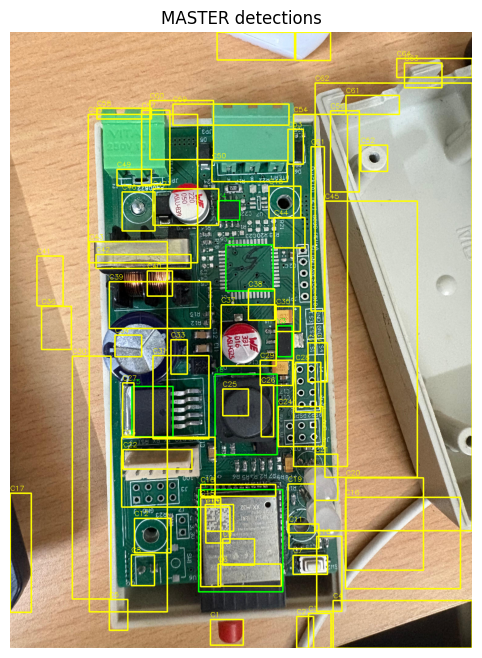


🟦 Running TEST (YOLO+SAM+OpenCV)...


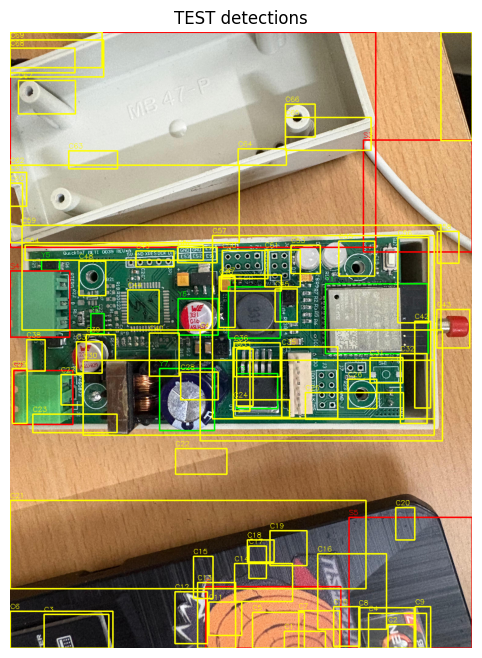

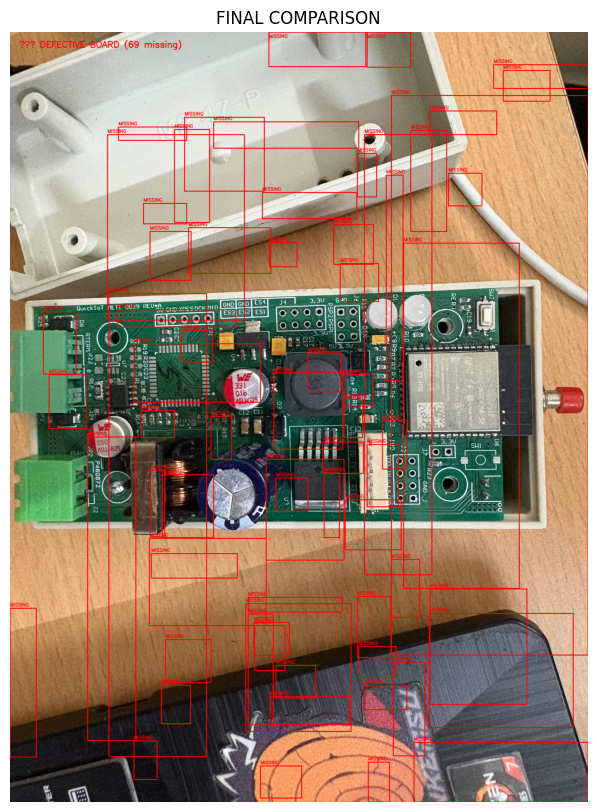


📁 Outputs saved in /content/pcb_output
❌ DEFECTIVE BOARD — 69 missing


In [4]:
# ==============================================================
# 🧠 PCB COMPONENT COMPARISON — YOLO + MobileSAM (fallback: SAM ViT-B) + OpenCV
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision
!pip install -q git+https://github.com/ChaoningZhang/MobileSAM.git || true
!pip install -q segment-anything || true

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, time, torch
from ultralytics import YOLO
from google.colab import files, drive

# ==============================================================
# ⚙️ SETUP
# ==============================================================
OUT_DIR = "/content/pcb_output"
CROP_DIR = f"{OUT_DIR}/crops"
os.makedirs(OUT_DIR, exist_ok=True)
os.makedirs(CROP_DIR, exist_ok=True)

MAX_SIZE = 1200
YOLO_CONF = 0.55
SAM_POINTS = 8
SAM_MIN_AREA = 800
IOU_THRESH = 0.45

drive.mount('/content/drive', force_remount=True)
print("✅ Drive mounted!")

# ==============================================================
# 🔍 FIND YOLO MODEL
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found = []
for r, d, f in os.walk(search_root):
    for fn in f:
        if fn == "best.pt":
            found.append(os.path.join(r, fn))
if not found:
    raise FileNotFoundError("❌ No best.pt found in Drive.")
MODEL_PATH = sorted(found, key=os.path.getmtime, reverse=True)[0]
print("✅ Using model:", MODEL_PATH)
yolo = YOLO(MODEL_PATH)

# ==============================================================
# 📤 UPLOAD IMAGES
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
if len(uploaded) < 2:
    raise ValueError("Upload 2 images: MASTER first, TEST second.")
master_img = cv2.imread(list(uploaded.keys())[0])
test_img = cv2.imread(list(uploaded.keys())[1])
print("✅ Images loaded.")

# ==============================================================
# 🧠 LOAD SAM (MobileSAM preferred)
# ==============================================================
print("\n🔵 Loading SAM (MobileSAM preferred)...")
use_mobilesam = False
try:
    from mobile_sam import sam_model_registry as mreg, SamAutomaticMaskGenerator as MSGen
    ck = "/content/mobile_sam.pth"
    # ✅ Download from HuggingFace mirror to prevent EOF issues
    if not os.path.exists(ck) or os.path.getsize(ck) < 10_000_000:
        print("⬇️ Downloading MobileSAM checkpoint...")
        !wget -q -O /content/mobile_sam.pth https://huggingface.co/ChaoningZhang/MobileSAM/resolve/main/mobile_sam.pt
    sam = mreg["vit_t"](checkpoint=ck)
    mask_gen = MSGen(sam, points_per_side=SAM_POINTS, min_mask_region_area=SAM_MIN_AREA)
    use_mobilesam = True
    print("✅ MobileSAM loaded successfully.")
except Exception as e:
    print("⚠️ MobileSAM failed, falling back to Segment Anything ViT-B...")
    from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
    ck = "/content/sam_vit_b_01ec64.pth"
    if not os.path.exists(ck):
        !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {ck}
    sam = sam_model_registry["vit_b"](checkpoint=ck)
    mask_gen = SamAutomaticMaskGenerator(
        sam,
        points_per_side=SAM_POINTS,
        pred_iou_thresh=0.9,
        stability_score_thresh=0.95,
        crop_n_layers=0,
        min_mask_region_area=SAM_MIN_AREA,
    )
    print("✅ Loaded fallback SAM (ViT-B).")

# ==============================================================
# 🧩 HELPER FUNCTIONS
# ==============================================================
def resize(img, max_side=MAX_SIZE):
    h, w = img.shape[:2]
    s = max_side / max(h, w)
    return (cv2.resize(img, (int(w * s), int(h * s))) if s < 1 else img), s

def draw_boxes(img, boxes, color, label):
    for i, (x1, y1, x2, y2) in enumerate(boxes):
        cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
        cv2.putText(img, f"{label}{i+1}", (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.45, color, 1)
    return img

def iou(a, b):
    xA, yA = max(a[0], b[0]), max(a[1], b[1])
    xB, yB = min(a[2], b[2]), min(a[3], b[3])
    inter = max(0, xB - xA) * max(0, yB - yA)
    return inter / float((a[2]-a[0])*(a[3]-a[1]) + (b[2]-b[0])*(b[3]-b[1]) - inter + 1e-9)

def detect_yolo(img_rgb, conf=YOLO_CONF):
    res = yolo.predict(source=img_rgb, conf=conf, verbose=False)
    boxes = []
    for r in res:
        for b in r.boxes:
            if float(b.conf) < conf:
                continue
            x1, y1, x2, y2 = map(int, b.xyxy[0].cpu().numpy())
            boxes.append((x1, y1, x2, y2))
    return boxes

# ==============================================================
# 🧠 PIPELINE FUNCTION
# ==============================================================
def full_detect(img_bgr, label, run_sam=True):
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_rgb, s = resize(img_rgb)
    boxes_y = detect_yolo(img_rgb)

    mask = np.zeros(img_rgb.shape[:2], np.uint8)
    for (x1, y1, x2, y2) in boxes_y:
        cv2.rectangle(mask, (x1, y1), (x2, y2), 255, -1)

    boxes_s = []
    if run_sam:
        inv = cv2.bitwise_not(mask)
        uncov = cv2.bitwise_and(img_rgb, img_rgb, mask=inv)
        masks = mask_gen.generate(uncov)
        for m in masks:
            seg = m["segmentation"].astype("uint8")
            x, y, w, h = cv2.boundingRect(seg)
            if np.any(mask[y:y+h, x:x+w] > 0) or w * h < SAM_MIN_AREA:
                continue
            boxes_s.append((x, y, x + w, y + h))

    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 60, 150)
    conts, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boxes_c = []
    for c in conts:
        x, y, w, h = cv2.boundingRect(c)
        if w * h < 2000:
            continue
        if any(iou((x, y, x + w, y + h), b) > 0.3 for b in boxes_y + boxes_s):
            continue
        boxes_c.append((x, y, x + w, y + h))

    allb = boxes_y + boxes_s + boxes_c
    vis = img_rgb.copy()
    vis = draw_boxes(vis, boxes_y, (0, 255, 0), "Y")  # YOLO (green)
    vis = draw_boxes(vis, boxes_s, (255, 0, 0), "S")  # SAM (blue)
    vis = draw_boxes(vis, boxes_c, (255, 255, 0), "C")  # OpenCV (yellow)
    plt.figure(figsize=(8, 8))
    plt.imshow(vis)
    plt.axis("off")
    plt.title(f"{label} detections")
    plt.show()
    return allb, s, img_bgr

# ==============================================================
# 🚀 RUN PIPELINE
# ==============================================================
print("\n🟩 Running MASTER (YOLO only)...")
master_boxes, sm, mbgr = full_detect(master_img, "MASTER", run_sam=False)
print("\n🟦 Running TEST (YOLO+SAM+OpenCV)...")
test_boxes, st, tbgr = full_detect(test_img, "TEST", run_sam=True)

# ==============================================================
# 🔁 COMPARE MASTER vs TEST
# ==============================================================
inv_scale = lambda b, s: (int(b[0]/s), int(b[1]/s), int(b[2]/s), int(b[3]/s))
master_orig = [inv_scale(b, sm) for b in master_boxes]
test_orig = [inv_scale(b, st) for b in test_boxes]
missing = [m for m in master_orig if not any(iou(m, t) > IOU_THRESH for t in test_orig)]

# ==============================================================
# 🖼️ VISUALIZE COMPARISON
# ==============================================================
final = tbgr.copy()
if not missing:
    cv2.putText(final, "✅ GOOD BOARD", (50, 80), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (0, 255, 0), 5)
else:
    for (x1, y1, x2, y2) in missing:
        cv2.rectangle(final, (x1, y1), (x2, y2), (0, 0, 255), 4)
        cv2.putText(final, "MISSING", (x1, max(30, y1 - 10)), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 255), 2)
    cv2.putText(final, f"❌ DEFECTIVE BOARD ({len(missing)} missing)", (50, 80), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 0, 255), 4)

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(final, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title("FINAL COMPARISON")
plt.show()

cv2.imwrite(f"{OUT_DIR}/final_comparison.png", final)
rep = {
    "master_components": len(master_boxes),
    "test_components": len(test_boxes),
    "missing_components": len(missing),
    "missing_boxes": [{"x1": b[0], "y1": b[1], "x2": b[2], "y2": b[3]} for b in missing],
}
json.dump(rep, open(f"{OUT_DIR}/report.json", "w"), indent=2)
print(f"\n📁 Outputs saved in {OUT_DIR}")
print("✅ GOOD BOARD" if not missing else f"❌ DEFECTIVE BOARD — {len(missing)} missing")


  Preparing metadata (setup.py) ... done
Mounted at /content/drive
✅ Drive mounted
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📤 Upload MASTER then TEST PCB images:


Saving dummy.jpg to dummy (7).jpg
Saving dummy1.jpg to dummy1 (7).jpg
✅ Uploaded: MASTER='dummy (7).jpg', TEST='dummy1 (7).jpg'

🔵 Attempting to load MobileSAM (lightweight)...
⬇️ Downloading MobileSAM checkpoint (HuggingFace mirror)...
⚠️ MobileSAM failed to load (or not installed). Falling back to Segment Anything ViT-B. Error: 
✅ Loaded SAM ViT-B (fallback).

➡️ Running detection on MASTER (YOLO only)...


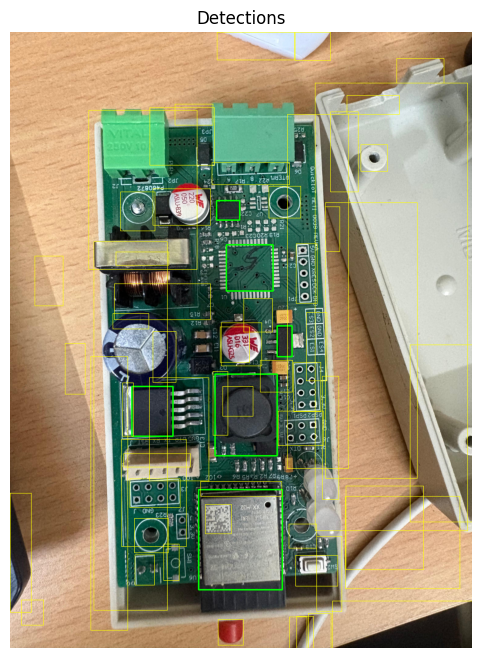


➡️ Running detection on TEST (YOLO + SAM + OpenCV)...


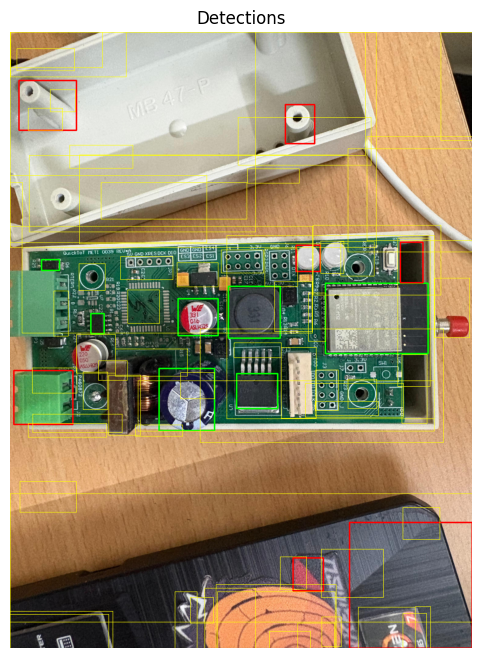


✂️ Saving crops for MASTER and TEST...
Saved 65 master crops and 85 test crops to /content/pcb_output/crops

🔁 Comparing MASTER to TEST (IoU matching)...
DEFECTIVE BOARD — 63 missing components.


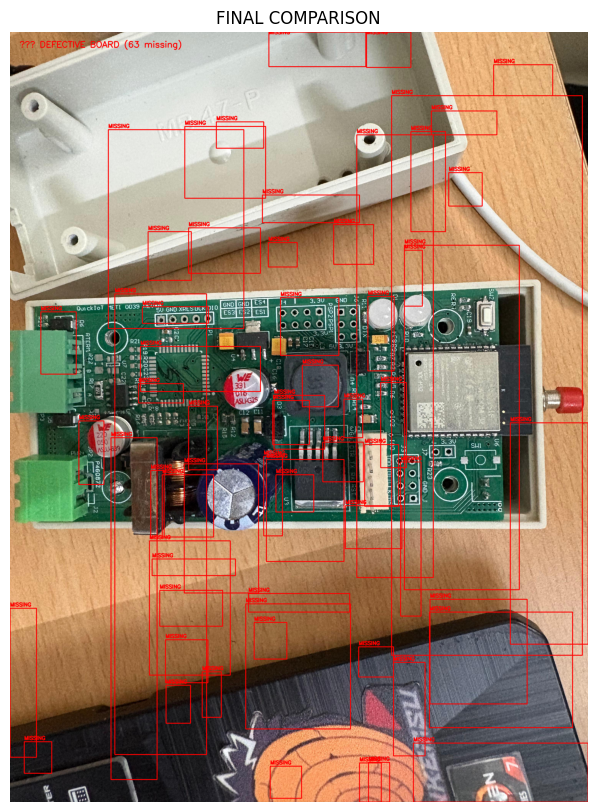


✅ All outputs saved in: /content/pcb_output
 - Final visual: /content/pcb_output/final_comparison.png
 - Crops folder: /content/pcb_output/crops
 - Report: /content/pcb_output/comparison_report.json


In [5]:
# ==============================================================
# PCB COMPONENT COMPARISON — YOLO + MobileSAM (fallback ViT-B) + OpenCV + Cropping
# ==============================================================
# Run this cell in Google Colab

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision
!pip install -q git+https://github.com/ChaoningZhang/MobileSAM.git || true
!pip install -q segment-anything || true

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, time, torch, importlib
from ultralytics import YOLO
from google.colab import drive

# -----------------------------
# Output folders
# -----------------------------
OUT_DIR = "/content/pcb_output"
CROP_DIR = os.path.join(OUT_DIR, "crops")
os.makedirs(OUT_DIR, exist_ok=True)
os.makedirs(CROP_DIR, exist_ok=True)

# -----------------------------
# Parameters
# -----------------------------
MAX_SIZE = 1200
YOLO_CONF = 0.55
SAM_POINTS = 4
SAM_MIN_AREA = 800
IOU_THRESH = 0.45

# -----------------------------
# Mount Drive
# -----------------------------
drive.mount('/content/drive', force_remount=True)
print("✅ Drive mounted")

# -----------------------------
# Find YOLO model in Drive
# -----------------------------
search_root = "/content/drive/My Drive/YOLO"
found = []
for r, d, f in os.walk(search_root):
    for fn in f:
        if fn == "best.pt":
            found.append(os.path.join(r, fn))
if not found:
    raise FileNotFoundError("No best.pt found under /content/drive/My Drive/YOLO. Upload your best.pt there or change search_root.")
MODEL_PATH = sorted(found, key=os.path.getmtime, reverse=True)[0]
print("✅ Using YOLO model:", MODEL_PATH)
model = YOLO(MODEL_PATH)

# -----------------------------
# Upload MASTER and TEST images
# -----------------------------
files = importlib.import_module("google.colab.files")
print("📤 Upload MASTER then TEST PCB images:")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload two images: MASTER first, TEST second.")
master_path = keys[0]
test_path = keys[1]
master_img = cv2.imread(master_path)
test_img = cv2.imread(test_path)
if master_img is None or test_img is None:
    raise ValueError("Failed to load uploaded images.")
print(f"✅ Uploaded: MASTER='{master_path}', TEST='{test_path}'")

# -----------------------------
# Helper utilities
# -----------------------------
def resize_keep_aspect(img, max_side=MAX_SIZE):
    h,w = img.shape[:2]
    scale = float(max_side) / max(h, w)
    if scale < 1.0:
        img2 = cv2.resize(img, (int(w*scale), int(h*scale)), interpolation=cv2.INTER_AREA)
        return img2, scale
    return img, 1.0

def compute_iou(A, B):
    xA = max(A[0], B[0]); yA = max(A[1], B[1])
    xB = min(A[2], B[2]); yB = min(A[3], B[3])
    interW = max(0, xB - xA); interH = max(0, yB - yA)
    inter = interW * interH
    areaA = max(0, (A[2]-A[0])) * max(0, (A[3]-A[1]))
    areaB = max(0, (B[2]-B[0])) * max(0, (B[3]-B[1]))
    denom = float(areaA + areaB - inter + 1e-9)
    return inter / denom if denom > 0 else 0.0

def save_crops_from_boxes(image_bgr, boxes, prefix):
    saved = []
    for idx, b in enumerate(boxes):
        x1,y1,x2,y2 = map(int, b)
        # clamp
        x1 = max(0, x1); y1 = max(0, y1); x2 = min(image_bgr.shape[1], x2); y2 = min(image_bgr.shape[0], y2)
        if x2 <= x1 or y2 <= y1:
            continue
        crop = image_bgr[y1:y2, x1:x2]
        fname = os.path.join(CROP_DIR, f"{prefix}_crop_{idx+1}.png")
        cv2.imwrite(fname, crop)
        saved.append(fname)
    return saved

# -----------------------------
# Load MobileSAM (HuggingFace mirror) or fallback to ViT-B
# -----------------------------
print("\n🔵 Attempting to load MobileSAM (lightweight)...")
use_mobilesam = False
mask_generator = None
try:
    from mobile_sam import sam_model_registry as mobile_registry, SamAutomaticMaskGenerator as MobileSamMaskGen
    CK = "/content/mobile_sam.pt"
    # Download reliable HF-hosted MobileSAM checkpoint if needed
    if not os.path.exists(CK) or os.path.getsize(CK) < 5_000_000:
        print("⬇️ Downloading MobileSAM checkpoint (HuggingFace mirror)...")
        !wget -q -O {CK} https://huggingface.co/ChaoningZhang/MobileSAM/resolve/main/mobile_sam.pt
    sam = mobile_registry["vit_t"](checkpoint=CK)
    mask_generator = MobileSamMaskGen(sam, points_per_side=SAM_POINTS, min_mask_region_area=SAM_MIN_AREA)
    use_mobilesam = True
    print("✅ MobileSAM loaded.")
except Exception as e:
    print("⚠️ MobileSAM failed to load (or not installed). Falling back to Segment Anything ViT-B. Error:", e)
    try:
        from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
        CK2 = "/content/sam_vit_b_01ec64.pth"
        if not os.path.exists(CK2):
            print("⬇️ Downloading SAM ViT-B checkpoint (~360MB)...")
            !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {CK2}
        sam = sam_model_registry["vit_b"](checkpoint=CK2)
        mask_generator = SamAutomaticMaskGenerator(
            sam,
            points_per_side=SAM_POINTS,
            pred_iou_thresh=0.9,
            stability_score_thresh=0.95,
            crop_n_layers=0,
            min_mask_region_area=SAM_MIN_AREA
        )
        print("✅ Loaded SAM ViT-B (fallback).")
    except Exception as e2:
        raise RuntimeError("Failed to load any SAM implementation. Error: " + str(e2))

# Small helper to draw boxes by source for visualization
def draw_all_boxes(img_rgb, boxes_by_source):
    vis = img_rgb.copy()
    for (x1,y1,x2,y2) in boxes_by_source.get("yolo",[]):
        cv2.rectangle(vis,(x1,y1),(x2,y2),(0,255,0),2)   # green
    for (x1,y1,x2,y2) in boxes_by_source.get("sam",[]):
        cv2.rectangle(vis,(x1,y1),(x2,y2),(255,0,0),2)   # blue
    for (x1,y1,x2,y2) in boxes_by_source.get("cv",[]):
        cv2.rectangle(vis,(x1,y1),(x2,y2),(255,255,0),1) # yellow
    return vis

# -----------------------------
# Single-image detection pipeline (returns boxes in resized image coords and the resize scale)
# -----------------------------
def detect_components_single(image_bgr, run_sam=True):
    # resize to save RAM
    img_resized, scale = resize_keep_aspect(image_bgr, MAX_SIZE)
    img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)

    # YOLO
    res = model.predict(source=img_rgb, conf=YOLO_CONF, verbose=False)
    yolo_boxes = []
    if len(res) > 0:
        r = res[0]
        for b in r.boxes:
            conf = float(b.conf)
            if conf < YOLO_CONF:
                continue
            x1,y1,x2,y2 = map(int, b.xyxy[0].cpu().numpy())
            yolo_boxes.append((x1,y1,x2,y2))

    # Create mask of YOLO-covered regions
    mask_yolo = np.zeros(img_rgb.shape[:2], dtype=np.uint8)
    for (x1,y1,x2,y2) in yolo_boxes:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)

    # SAM (only uncovered regions)
    sam_boxes = []
    if run_sam:
        inv = cv2.bitwise_not(mask_yolo)
        uncovered = cv2.bitwise_and(img_rgb, img_rgb, mask=inv)
        try:
            sam_masks = mask_generator.generate(uncovered)
        except Exception as e:
            print("Warning: SAM generate failed:", e)
            sam_masks = []
        for m in sam_masks:
            seg = m["segmentation"].astype("uint8")
            x,y,w,h = cv2.boundingRect(seg)
            if w*h < SAM_MIN_AREA:
                continue
            # skip if overlaps YOLO region (on resized coords)
            if np.any(mask_yolo[y:y+h, x:x+w] > 0):
                continue
            sam_boxes.append((x,y,x+w,y+h))

    # OpenCV edge-based backup
    cv_boxes = []
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 60, 150)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    for c in contours:
        x,y,w,h = cv2.boundingRect(c)
        if w*h < 2000:
            continue
        # skip overlaps with YOLO or SAM boxes
        over = False
        for b in (yolo_boxes + sam_boxes):
            if compute_iou((x,y,x+w,y+h), b) > 0.3:
                over = True
                break
        if not over:
            cv_boxes.append((x,y,x+w,y+h))

    # Prepare per-source lists (in resized coords)
    boxes_by_source = {"yolo": yolo_boxes, "sam": sam_boxes, "cv": cv_boxes}
    all_boxes = yolo_boxes + sam_boxes + cv_boxes

    # Visualize (resized image)
    vis = draw_all_boxes(img_rgb, boxes_by_source)
    plt.figure(figsize=(8,8)); plt.imshow(vis); plt.axis('off'); plt.title("Detections"); plt.show()

    return all_boxes, boxes_by_source, scale, img_resized

# -----------------------------
# Run MASTER (YOLO only) then TEST (YOLO+SAM+OpenCV)
# -----------------------------
print("\n➡️ Running detection on MASTER (YOLO only)...")
master_boxes_resized, master_by_src, master_scale, master_resized = detect_components_single(master_img, run_sam=False)

print("\n➡️ Running detection on TEST (YOLO + SAM + OpenCV)...")
test_boxes_resized, test_by_src, test_scale, test_resized = detect_components_single(test_img, run_sam=True)

# -----------------------------
# Save crops (in ORIGINAL image coordinates) and label them by source
# -----------------------------
print("\n✂️ Saving crops for MASTER and TEST...")

# Convert resized coords back to original image coords and save crops with source labels
def save_all_crops(original_bgr, boxes_by_source, scale, prefix):
    saved_files = []
    for src, boxes in boxes_by_source.items():
        for idx, b in enumerate(boxes):
            x1,y1,x2,y2 = b
            # map to original coordinates
            inv = 1.0/scale
            ox1 = int(round(x1 * inv)); oy1 = int(round(y1 * inv))
            ox2 = int(round(x2 * inv)); oy2 = int(round(y2 * inv))
            # clamp
            ox1 = max(0, ox1); oy1 = max(0, oy1); ox2 = min(original_bgr.shape[1], ox2); oy2 = min(original_bgr.shape[0], oy2)
            if ox2 <= ox1 or oy2 <= oy1:
                continue
            crop = original_bgr[oy1:oy2, ox1:ox2]
            fname = os.path.join(CROP_DIR, f"{prefix}_{src}_crop_{idx+1}.png")
            cv2.imwrite(fname, crop)
            saved_files.append(fname)
    return saved_files

master_crop_files = save_all_crops(master_img, master_by_src, master_scale, "MASTER")
test_crop_files = save_all_crops(test_img, test_by_src, test_scale, "TEST")
print(f"Saved {len(master_crop_files)} master crops and {len(test_crop_files)} test crops to {CROP_DIR}")

# -----------------------------
# Compare MASTER -> TEST using IoU (map master resized -> original coordinates)
# -----------------------------
print("\n🔁 Comparing MASTER to TEST (IoU matching)...")
# Convert master resized boxes to original coords
master_boxes_orig = []
for b in master_boxes_resized:
    x1,y1,x2,y2 = b
    inv = 1.0/master_scale
    master_boxes_orig.append((int(round(x1*inv)), int(round(y1*inv)), int(round(x2*inv)), int(round(y2*inv))))

# Convert test resized boxes to original coords
test_boxes_orig = []
for b in test_boxes_resized:
    x1,y1,x2,y2 = b
    inv = 1.0/test_scale
    test_boxes_orig.append((int(round(x1*inv)), int(round(y1*inv)), int(round(x2*inv)), int(round(y2*inv))))

missing = []
for mb in master_boxes_orig:
    matched = any(compute_iou(mb, tb) > IOU_THRESH for tb in test_boxes_orig)
    if not matched:
        missing.append(mb)

# -----------------------------
# Visualize final comparison on ORIGINAL TEST image
# -----------------------------
final_vis = test_img.copy()
if len(missing) == 0:
    cv2.putText(final_vis, "✅ GOOD BOARD", (50,80), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (0,255,0), 5)
    print("GOOD BOARD — All components matched.")
else:
    for (x1,y1,x2,y2) in missing:
        cv2.rectangle(final_vis, (x1,y1),(x2,y2), (0,0,255), 4)
        cv2.putText(final_vis, "MISSING", (x1, max(10,y1-10)), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,0,255), 3)
    cv2.putText(final_vis, f"❌ DEFECTIVE BOARD ({len(missing)} missing)", (50,80), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0,0,255), 4)
    print(f"DEFECTIVE BOARD — {len(missing)} missing components.")

plt.figure(figsize=(10,10)); plt.imshow(cv2.cvtColor(final_vis, cv2.COLOR_BGR2RGB)); plt.axis('off'); plt.title("FINAL COMPARISON"); plt.show()

# Save final image and JSON report
out_final = os.path.join(OUT_DIR, "final_comparison.png")
cv2.imwrite(out_final, final_vis)
report = {
    "master_count": len(master_boxes_orig),
    "test_count": len(test_boxes_orig),
    "missing_count": len(missing),
    "missing_boxes": [{"x1":b[0],"y1":b[1],"x2":b[2],"y2":b[3]} for b in missing],
    "master_crops": master_crop_files,
    "test_crops": test_crop_files
}
with open(os.path.join(OUT_DIR, "comparison_report.json"), "w") as f:
    json.dump(report, f, indent=2)

print("\n✅ All outputs saved in:", OUT_DIR)
print(" - Final visual:", out_final)
print(" - Crops folder:", CROP_DIR)
print(" - Report:", os.path.join(OUT_DIR, "comparison_report.json"))


  Preparing metadata (setup.py) ... done
Mounted at /content/drive
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📸 Upload MASTER and TEST PCB images:


Saving tesssttt.jpeg to tesssttt.jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr.jpeg
🟩 Cropping MASTER image...
🟩 Cropping TEST image...

🔵 Loading SAM (MobileSAM preferred)...
⬇️ Downloading MobileSAM from HuggingFace...
⚠️ MobileSAM failed, using Segment Anything ViT-B fallback.
✅ SAM ViT-B loaded (fallback).
🟩 Running MASTER (YOLO only)...


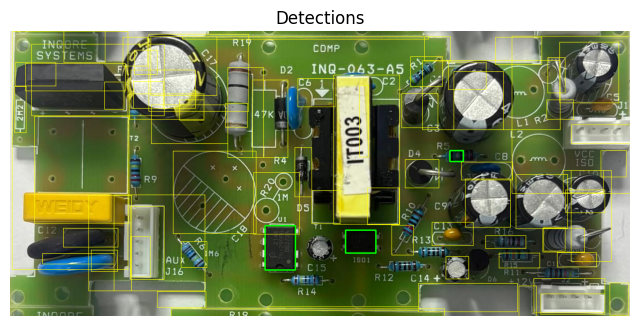

🟦 Running TEST (YOLO + SAM + OpenCV)...


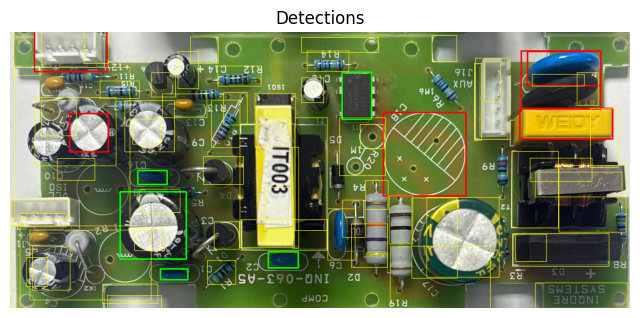

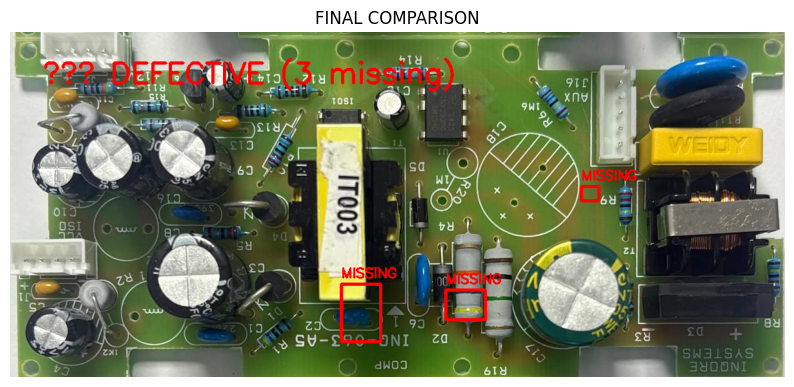


📁 Outputs saved in: /content/pcb_output
❌ DEFECTIVE — 3 missing


In [6]:
# ==============================================================
# 🧠 PCB DETECTION & COMPARISON — Color Crop + YOLO + MobileSAM + OpenCV
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision
!pip install -q git+https://github.com/ChaoningZhang/MobileSAM.git || true
!pip install -q segment-anything || true

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, importlib
from ultralytics import YOLO
from google.colab import files, drive

# ==============================================================
# ⚙️ SETUP
# ==============================================================
OUT_DIR = "/content/pcb_output"
CROP_DIR = os.path.join(OUT_DIR, "component_crops")
os.makedirs(CROP_DIR, exist_ok=True)
drive.mount('/content/drive', force_remount=True)

# Parameters
MAX_SIZE = 1200
YOLO_CONF = 0.55
SAM_MIN_AREA = 800
IOU_THRESH = 0.45
SAM_POINTS = 4

# ==============================================================
# 🧩 PCB COLOR-BASED AUTO-CROPPING FUNCTION
# ==============================================================
def auto_crop_board_color_based(image):
    img = image.copy()
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7, 7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)

    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        print("⚠️ No PCB region detected; returning full image.")
        return cv2.resize(img, (512, 512))

    c = max(contours, key=cv2.contourArea)
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.02 * peri, True)
    if len(approx) != 4:
        x, y, w, h = cv2.boundingRect(c)
        return img[y:y + h, x:x + w]

    def order_points(pts):
        rect = np.zeros((4, 2), dtype="float32")
        s = pts.sum(axis=1)
        rect[0] = pts[np.argmin(s)]
        rect[2] = pts[np.argmax(s)]
        diff = np.diff(pts, axis=1)
        rect[1] = pts[np.argmin(diff)]
        rect[3] = pts[np.argmax(diff)]
        return rect

    rect = order_points(approx.reshape(4, 2))
    (tl, tr, br, bl) = rect
    widthA = np.linalg.norm(br - bl)
    widthB = np.linalg.norm(tr - tl)
    heightA = np.linalg.norm(tr - br)
    heightB = np.linalg.norm(tl - bl)
    maxWidth = int(max(widthA, widthB))
    maxHeight = int(max(heightA, heightB))

    dst = np.array([[0, 0],
                    [maxWidth - 1, 0],
                    [maxWidth - 1, maxHeight - 1],
                    [0, maxHeight - 1]], dtype="float32")

    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(img, M, (maxWidth, maxHeight))
    return warped

# ==============================================================
# 🧠 LOAD YOLO MODEL
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found = []
for r, d, f in os.walk(search_root):
    for fn in f:
        if fn == "best.pt":
            found.append(os.path.join(r, fn))
if not found:
    raise FileNotFoundError("❌ No best.pt found in Drive.")
MODEL_PATH = sorted(found, key=os.path.getmtime, reverse=True)[0]
print(f"✅ Using YOLO model: {MODEL_PATH}")
yolo = YOLO(MODEL_PATH)

# ==============================================================
# 📤 UPLOAD MASTER + TEST IMAGES (will be auto-cropped)
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
files = importlib.import_module("google.colab.files")
uploaded = files.upload()
if len(uploaded) < 2:
    raise ValueError("Upload two images: MASTER first, TEST second.")
master_img = cv2.imread(list(uploaded.keys())[0])
test_img = cv2.imread(list(uploaded.keys())[1])

print("🟩 Cropping MASTER image...")
master_crop = auto_crop_board_color_based(master_img)
print("🟩 Cropping TEST image...")
test_crop = auto_crop_board_color_based(test_img)

# ==============================================================
# 🧠 LOAD MobileSAM (HuggingFace mirror) or fallback
# ==============================================================
print("\n🔵 Loading SAM (MobileSAM preferred)...")
use_mobilesam = False
mask_generator = None
try:
    from mobile_sam import sam_model_registry as mreg, SamAutomaticMaskGenerator as MSGen
    ck = "/content/mobile_sam.pt"
    if not os.path.exists(ck) or os.path.getsize(ck) < 5_000_000:
        print("⬇️ Downloading MobileSAM from HuggingFace...")
        !wget -q -O {ck} https://huggingface.co/ChaoningZhang/MobileSAM/resolve/main/mobile_sam.pt
    sam = mreg["vit_t"](checkpoint=ck)
    mask_generator = MSGen(sam, points_per_side=SAM_POINTS, min_mask_region_area=SAM_MIN_AREA)
    use_mobilesam = True
    print("✅ MobileSAM loaded successfully.")
except Exception as e:
    print("⚠️ MobileSAM failed, using Segment Anything ViT-B fallback.")
    from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
    ck = "/content/sam_vit_b_01ec64.pth"
    if not os.path.exists(ck):
        !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {ck}
    sam = sam_model_registry["vit_b"](checkpoint=ck)
    mask_generator = SamAutomaticMaskGenerator(
        sam,
        points_per_side=SAM_POINTS,
        pred_iou_thresh=0.9,
        stability_score_thresh=0.95,
        crop_n_layers=0,
        min_mask_region_area=SAM_MIN_AREA,
    )
    print("✅ SAM ViT-B loaded (fallback).")

# ==============================================================
# 🧩 HELPERS
# ==============================================================
def compute_iou(a, b):
    xA, yA = max(a[0], b[0]), max(a[1], b[1])
    xB, yB = min(a[2], b[2]), min(a[3], b[3])
    inter = max(0, xB - xA) * max(0, yB - yA)
    areaA = (a[2]-a[0])*(a[3]-a[1])
    areaB = (b[2]-b[0])*(b[3]-b[1])
    return inter / float(areaA + areaB - inter + 1e-6)

def detect_pipeline(image, run_sam=True):
    rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    res = yolo.predict(source=rgb, conf=YOLO_CONF, verbose=False)
    yolo_boxes = []
    for r in res:
        for b in r.boxes:
            if float(b.conf) >= YOLO_CONF:
                x1,y1,x2,y2 = map(int, b.xyxy[0].cpu().numpy())
                yolo_boxes.append((x1,y1,x2,y2))
    mask = np.zeros(rgb.shape[:2], np.uint8)
    for (x1,y1,x2,y2) in yolo_boxes:
        cv2.rectangle(mask, (x1,y1), (x2,y2), 255, -1)

    sam_boxes = []
    if run_sam:
        inv = cv2.bitwise_not(mask)
        uncovered = cv2.bitwise_and(rgb, rgb, mask=inv)
        masks = mask_generator.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype("uint8")
            x, y, w, h = cv2.boundingRect(seg)
            if np.any(mask[y:y+h, x:x+w] > 0) or w*h < SAM_MIN_AREA:
                continue
            sam_boxes.append((x, y, x+w, y+h))

    # OpenCV backup
    gray = cv2.cvtColor(rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 60, 150)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cv_boxes = []
    for c in contours:
        x,y,w,h = cv2.boundingRect(c)
        if w*h < 2000: continue
        if any(compute_iou((x,y,x+w,y+h), b) > 0.3 for b in yolo_boxes + sam_boxes): continue
        cv_boxes.append((x,y,x+w,y+h))

    vis = rgb.copy()
    for (x1,y1,x2,y2) in yolo_boxes:
        cv2.rectangle(vis,(x1,y1),(x2,y2),(0,255,0),2)
    for (x1,y1,x2,y2) in sam_boxes:
        cv2.rectangle(vis,(x1,y1),(x2,y2),(255,0,0),2)
    for (x1,y1,x2,y2) in cv_boxes:
        cv2.rectangle(vis,(x1,y1),(x2,y2),(255,255,0),1)

    plt.figure(figsize=(8,8)); plt.imshow(vis); plt.axis('off'); plt.title("Detections"); plt.show()
    return yolo_boxes, sam_boxes, cv_boxes

# ==============================================================
# 🚀 DETECT MASTER & TEST
# ==============================================================
print("🟩 Running MASTER (YOLO only)...")
master_y, _, _ = detect_pipeline(master_crop, run_sam=False)
print("🟦 Running TEST (YOLO + SAM + OpenCV)...")
test_y, test_s, test_c = detect_pipeline(test_crop, run_sam=True)
test_all = test_y + test_s + test_c

# ==============================================================
# 🔁 COMPARE MASTER vs TEST
# ==============================================================
missing = [m for m in master_y if not any(compute_iou(m, t) > IOU_THRESH for t in test_all)]

# ==============================================================
# 🖼️ VISUALIZE RESULT
# ==============================================================
final = test_crop.copy()
if not missing:
    cv2.putText(final, "✅ GOOD BOARD", (50, 80), cv2.FONT_HERSHEY_SIMPLEX, 2, (0,255,0), 4)
else:
    for (x1,y1,x2,y2) in missing:
        cv2.rectangle(final, (x1,y1), (x2,y2), (0,0,255), 3)
        cv2.putText(final, "MISSING", (x1, max(30, y1-10)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
    cv2.putText(final, f"❌ DEFECTIVE ({len(missing)} missing)", (50,80), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0,0,255), 3)

plt.figure(figsize=(10,10))
plt.imshow(cv2.cvtColor(final, cv2.COLOR_BGR2RGB))
plt.axis('off'); plt.title("FINAL COMPARISON"); plt.show()

cv2.imwrite(f"{OUT_DIR}/final_comparison.png", final)

# ==============================================================
# ✂️ SAVE CROPS
# ==============================================================
def save_crops(img, boxes, prefix):
    saved = []
    for i, (x1,y1,x2,y2) in enumerate(boxes):
        crop = img[y1:y2, x1:x2]
        if crop.size == 0: continue
        path = f"{CROP_DIR}/{prefix}_crop_{i+1}.png"
        cv2.imwrite(path, crop)
        saved.append(path)
    return saved

master_crops = save_crops(master_crop, master_y, "MASTER")
test_crops = save_crops(test_crop, test_all, "TEST")

# ==============================================================
# 🧾 SAVE REPORT
# ==============================================================
report = {
    "master_components": len(master_y),
    "test_components": len(test_all),
    "missing_components": len(missing),
    "master_crops": master_crops,
    "test_crops": test_crops
}
with open(f"{OUT_DIR}/report.json", "w") as f: json.dump(report, f, indent=2)

print(f"\n📁 Outputs saved in: {OUT_DIR}")
print("✅ GOOD BOARD" if not missing else f"❌ DEFECTIVE — {len(missing)} missing")


Mounted at /content/drive
Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
Torch CUDA available: True -> device = cuda
YOLO model loaded. Model names: {0: 'ICs', 1: 'capacitors', 2: 'diodes', 3: 'fuses', 4: 'inductors', 5: 'resistors', 6: 'transducers', 7: 'transformers', 8: 'transistors'}
📤 Upload MASTER then TEST PCB images (MASTER first):


Saving tesssttt.jpeg to tesssttt (1).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (1).jpeg
Uploaded: tesssttt (1).jpeg Masterrrrrr (1).jpeg
✂️ Auto-cropping MASTER and TEST to PCB regions...
master shape: (573, 1248, 3) test shape: (535, 1201, 3)
Loaded SAM (ViT-B).

Running MASTER (YOLO only)...
YOLO inference time: 0.12s, detections kept: 7 (conf>0.55)

Running TEST (YOLO + SAM + OpenCV)...
YOLO inference time: 0.01s, detections kept: 4 (conf>0.55)

MASTER counts: YOLO=7, SAM=0, OpenCV=72
TEST  counts: YOLO=4, SAM=18, OpenCV=41


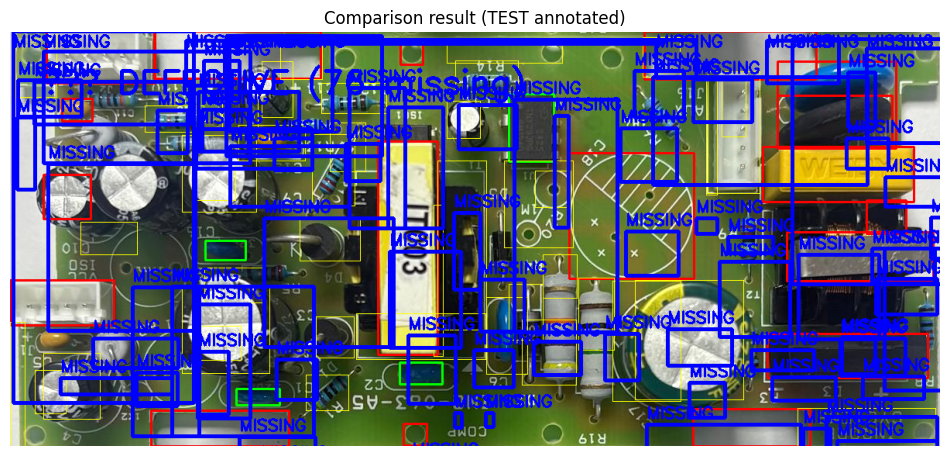

Saved final comparison to /content/pcb_output/final_comparison.png
Saved 79 master crops and 63 test crops to /content/pcb_output/crops
Report saved to /content/pcb_output/comparison_report.json


In [7]:
# ==============================================================
# COMPLETE: Auto-crop + YOLO -> SAM -> OpenCV -> Compare -> Crop
# Reference cropping integrated and YOLO reliability fixes
# Run this cell in Google Colab
# ==============================================================

# Install (run once)
!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything || true

# -----------------------------
# Imports
# -----------------------------
import os, sys, json, time, math
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
import torch
import importlib
from google.colab import drive

# -----------------------------
# Output folders
# -----------------------------
OUT_DIR = "/content/pcb_output"
CROP_DIR = os.path.join(OUT_DIR, "crops")
os.makedirs(OUT_DIR, exist_ok=True)
os.makedirs(CROP_DIR, exist_ok=True)

# -----------------------------
# Parameters (tweakable)
# -----------------------------
YOLO_CONF = 0.55        # detection threshold
YOLO_IMG_SZ = 1024      # inference image size (helps detection)
SAM_POINTS = 8          # lower -> faster, but coarser
SAM_MIN_AREA = 800      # minimum mask area (px)
IOU_THRESH = 0.45
MAX_CROP_SIDE = 1400    # limit largest dimension to save RAM

# -----------------------------
# Mount drive (optional)
# -----------------------------
drive.mount('/content/drive', force_remount=True)

# -----------------------------
# Auto-find YOLO model in Drive
# -----------------------------
search_root = "/content/drive/My Drive/YOLO"
found = []
for r, d, files in os.walk(search_root):
    for fn in files:
        if fn == "best.pt":
            found.append(os.path.join(r, fn))
if not found:
    raise FileNotFoundError("No best.pt found under /content/drive/My Drive/YOLO. Upload your best.pt there or change search_root.")
MODEL_PATH = sorted(found, key=os.path.getmtime, reverse=True)[0]
print("Using YOLO model:", MODEL_PATH)

# -----------------------------
# Load YOLO model onto device
# -----------------------------
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Torch CUDA available:", torch.cuda.is_available(), "-> device =", device)

yolo = YOLO(MODEL_PATH)   # ultralytics handles device in predict; but object created
print("YOLO model loaded. Model names:", getattr(yolo, "model", {}).names if hasattr(yolo, "model") else "unknown")

# -----------------------------
# Ensure correct files.upload reference
# -----------------------------
files_module = importlib.import_module("google.colab.files")

# -----------------------------
# Auto-crop function (your reference)
# -----------------------------
def auto_crop_board_color_based(image):
    img = image.copy()
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7, 7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        print("⚠️ No PCB region detected via color — using full image (resized).")
        h,w = img.shape[:2]
        scale = 512/max(h,w)
        return cv2.resize(img, (int(w*scale), int(h*scale))) if scale<1 else img
    c = max(contours, key=cv2.contourArea)
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.02 * peri, True)
    if len(approx) != 4:
        x,y,w,h = cv2.boundingRect(c)
        return img[y:y+h, x:x+w]
    def order_points(pts):
        rect = np.zeros((4,2), dtype="float32")
        s = pts.sum(axis=1)
        rect[0] = pts[np.argmin(s)]
        rect[2] = pts[np.argmax(s)]
        diff = np.diff(pts, axis=1)
        rect[1] = pts[np.argmin(diff)]
        rect[3] = pts[np.argmax(diff)]
        return rect
    rect = order_points(approx.reshape(4,2))
    (tl, tr, br, bl) = rect
    widthA = np.linalg.norm(br - bl)
    widthB = np.linalg.norm(tr - tl)
    heightA = np.linalg.norm(tr - br)
    heightB = np.linalg.norm(tl - bl)
    maxWidth = int(max(widthA, widthB))
    maxHeight = int(max(heightA, heightB))
    dst = np.array([[0,0],[maxWidth-1,0],[maxWidth-1,maxHeight-1],[0,maxHeight-1]], dtype="float32")
    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(img, M, (maxWidth, maxHeight))
    return warped

# -----------------------------
# Upload MASTER and TEST images
# -----------------------------
print("📤 Upload MASTER then TEST PCB images (MASTER first):")
uploaded = files_module.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload two images: MASTER then TEST.")
master_path = keys[0]; test_path = keys[1]
print("Uploaded:", master_path, test_path)

master_orig = cv2.imdecode(np.frombuffer(uploaded[master_path], np.uint8), cv2.IMREAD_COLOR)
test_orig   = cv2.imdecode(np.frombuffer(uploaded[test_path], np.uint8), cv2.IMREAD_COLOR)
if master_orig is None or test_orig is None:
    raise ValueError("Failed to read uploaded images.")

# -----------------------------
# Auto-crop PCBs
# -----------------------------
print("✂️ Auto-cropping MASTER and TEST to PCB regions...")
master = auto_crop_board_color_based(master_orig)
test   = auto_crop_board_color_based(test_orig)
# Optional: clamp very large images
def clamp_max_side(img, max_side=MAX_CROP_SIDE):
    h,w = img.shape[:2]
    if max(h,w) > max_side:
        s = max_side / max(h,w)
        return cv2.resize(img, (int(w*s), int(h*s)), interpolation=cv2.INTER_AREA), s
    return img, 1.0
master, s_master = clamp_max_side(master, MAX_CROP_SIDE)
test, s_test = clamp_max_side(test, MAX_CROP_SIDE)
print("master shape:", master.shape, "test shape:", test.shape)

# -----------------------------
# Helper: YOLO detection (robust)
# -----------------------------
def detect_yolo_on_rgb(img_rgb, conf_thresh=YOLO_CONF, imgsz=YOLO_IMG_SZ, device=device):
    # ultralytics accepts numpy RGB arrays as source
    # we pass device so it uses GPU if available
    # run inference
    t0 = time.time()
    results = yolo.predict(source=img_rgb, conf=conf_thresh, device=device, imgsz=imgsz, verbose=False)
    t1 = time.time()
    # results is list; use first (single) image
    boxes = []
    labels = []
    scores = []
    if len(results) == 0:
        print("YOLO: no results returned.")
        return boxes, labels, scores, t1-t0
    r = results[0]
    # If no boxes attribute, return
    if len(r.boxes) == 0:
        print("YOLO: 0 boxes detected.")
        return [], [], [], t1-t0
    xyxy = r.boxes.xyxy.cpu().numpy()            # Nx4
    confs = r.boxes.conf.cpu().numpy()           # N
    cls = r.boxes.cls.cpu().numpy().astype(int)  # N
    names = r.names if hasattr(r, "names") else (yolo.model.names if hasattr(yolo,"model") else {})
    for i, (x1,y1,x2,y2) in enumerate(xyxy):
        score = float(confs[i])
        if score < conf_thresh:
            continue
        label = names.get(cls[i], str(cls[i])) if isinstance(names, dict) else (names[cls[i]] if len(names)>cls[i] else str(cls[i]))
        boxes.append((int(round(x1)), int(round(y1)), int(round(x2)), int(round(y2))))
        labels.append(label)
        scores.append(score)
    print(f"YOLO inference time: {t1-t0:.2f}s, detections kept: {len(boxes)} (conf>{conf_thresh})")
    return boxes, labels, scores, (t1-t0)

# -----------------------------
# Load SAM (segment-anything) - optimized settings
# -----------------------------
use_sam = True
try:
    from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
    sam_ckpt = "/content/sam_vit_b_01ec64.pth"
    if not os.path.exists(sam_ckpt):
        print("Downloading SAM ViT-B checkpoint (~360MB). This can be slow.")
        !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}
    sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
    sam_mask_gen = SamAutomaticMaskGenerator(sam,
                                            points_per_side=8,
                                            pred_iou_thresh=0.9,
                                            stability_score_thresh=0.9,
                                            crop_n_layers=0,
                                            min_mask_region_area=SAM_MIN_AREA)
    print("Loaded SAM (ViT-B).")
except Exception as e:
    print("Warning: segment_anything import or checkpoint failed; SAM will be disabled. Error:", e)
    use_sam = False
    sam_mask_gen = None

# -----------------------------
# Detection pipeline for one image (YOLO -> SAM (on uncovered) -> OpenCV)
# returns: all_boxes (list of (x1,y1,x2,y2, source)), per-source dict, resized_image (RGB), scale
# -----------------------------
def run_pipeline_on_image(image_bgr, run_sam=True):
    img_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    # run YOLO
    yolo_boxes, yolo_labels, yolo_scores, yolo_time = detect_yolo_on_rgb(img_rgb)
    # build mask of yolo regions
    mask_yolo = np.zeros(img_rgb.shape[:2], dtype=np.uint8)
    for (x1,y1,x2,y2) in yolo_boxes:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)
    # SAM on uncovered area
    sam_boxes = []
    if run_sam and use_sam and sam_mask_gen is not None:
        inv_mask = cv2.bitwise_not(mask_yolo)
        uncovered = cv2.bitwise_and(img_rgb, img_rgb, mask=inv_mask)
        try:
            sam_masks = sam_mask_gen.generate(uncovered)
        except Exception as e:
            print("SAM generation failed:", e)
            sam_masks = []
        for m in sam_masks:
            seg = m["segmentation"].astype("uint8")
            x,y,w,h = cv2.boundingRect(seg)
            if w*h < SAM_MIN_AREA:
                continue
            # ensure not overlapping with YOLO (on same coords)
            if np.any(mask_yolo[y:y+h, x:x+w] > 0):
                continue
            sam_boxes.append((x,y,x+w,y+h))
    else:
        if run_sam and not use_sam:
            print("SAM disabled — skipping SAM step.")
    # OpenCV edge-based backup (on full image but skip YOLO overlap)
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 60, 150)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cv_boxes = []
    for c in contours:
        x,y,w,h = cv2.boundingRect(c)
        if w*h < 2000:
            continue
        # skip if overlaps YOLO or SAM
        overlap = False
        for b in (yolo_boxes + sam_boxes):
            # compute IoU quickly
            ix1 = max(b[0], x); iy1 = max(b[1], y); ix2 = min(b[2], x+w); iy2 = min(b[3], y+h)
            if ix2 > ix1 and iy2 > iy1:
                inter = (ix2-ix1)*(iy2-iy1)
                areaB = (b[2]-b[0])*(b[3]-b[1])
                if inter/float(areaB+1e-9) > 0.2:
                    overlap = True
                    break
        if not overlap:
            cv_boxes.append((x,y,x+w,y+h))
    # return combined list with source tag
    all_boxes = []
    for b in yolo_boxes: all_boxes.append((b[0],b[1],b[2],b[3],"yolo"))
    for b in sam_boxes:  all_boxes.append((b[0],b[1],b[2],b[3],"sam"))
    for b in cv_boxes:   all_boxes.append((b[0],b[1],b[2],b[3],"cv"))
    per_source = {"yolo": yolo_boxes, "sam": sam_boxes, "cv": cv_boxes}
    return all_boxes, per_source, img_rgb

# -----------------------------
# Run pipeline: MASTER (YOLO only) then TEST (YOLO+SAM+OpenCV)
# -----------------------------
print("\nRunning MASTER (YOLO only)...")
master_all, master_src, master_rgb = run_pipeline_on_image(master, run_sam=False)

print("\nRunning TEST (YOLO + SAM + OpenCV)...")
test_all, test_src, test_rgb = run_pipeline_on_image(test, run_sam=True)

# -----------------------------
# Debug prints: counts and sample boxes
# -----------------------------
print(f"\nMASTER counts: YOLO={len(master_src['yolo'])}, SAM={len(master_src['sam'])}, OpenCV={len(master_src['cv'])}")
print(f"TEST  counts: YOLO={len(test_src['yolo'])}, SAM={len(test_src['sam'])}, OpenCV={len(test_src['cv'])}")

# -----------------------------
# IoU compare MASTER -> TEST (both in same resized coords because we did not resize between steps)
# -----------------------------
def compute_iou_box(A,B):
    xA,yA = max(A[0],B[0]), max(A[1],B[1])
    xB,yB = min(A[2],B[2]), min(A[3],B[3])
    interW = max(0,xB-xA); interH = max(0,yB-yA)
    inter = interW*interH
    areaA = max(0,(A[2]-A[0]))*max(0,(A[3]-A[1]))
    areaB = max(0,(B[2]-B[0]))*max(0,(B[3]-B[1]))
    denom = float(areaA+areaB-inter+1e-9)
    return inter/denom if denom>0 else 0.0

missing = []
for mb in master_src["yolo"] + master_src["sam"] + master_src["cv"]:
    matched = False
    for tb in test_src["yolo"] + test_src["sam"] + test_src["cv"]:
        if compute_iou_box(mb, tb) >= IOU_THRESH:
            matched = True
            break
    if not matched:
        missing.append(mb)

# -----------------------------
# Visualization (draw test boxes and mark missing)
# -----------------------------
vis = test_rgb.copy()
# draw test boxes color-coded
for (x1,y1,x2,y2) in test_src["yolo"]:
    cv2.rectangle(vis, (x1,y1),(x2,y2), (0,255,0), 2)
for (x1,y1,x2,y2) in test_src["sam"]:
    cv2.rectangle(vis, (x1,y1),(x2,y2), (255,0,0), 2)
for (x1,y1,x2,y2) in test_src["cv"]:
    cv2.rectangle(vis, (x1,y1),(x2,y2), (255,255,0), 1)

if len(missing)==0:
    cv2.putText(vis, "✅ GOOD BOARD", (40,80), cv2.FONT_HERSHEY_SIMPLEX, 1.6, (0,255,0), 4)
else:
    for (x1,y1,x2,y2) in missing:
        cv2.rectangle(vis, (x1,y1),(x2,y2), (0,0,255), 3)
        cv2.putText(vis, "MISSING", (x1, max(20,y1-8)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
    cv2.putText(vis, f"❌ DEFECTIVE ({len(missing)} missing)", (40,80), cv2.FONT_HERSHEY_SIMPLEX, 1.4, (0,0,255), 4)

plt.figure(figsize=(12,10)); plt.imshow(vis); plt.axis('off'); plt.title("Comparison result (TEST annotated)"); plt.show()
cv2.imwrite(os.path.join(OUT_DIR, "final_comparison.png"), cv2.cvtColor(vis, cv2.COLOR_RGB2BGR))
print("Saved final comparison to", os.path.join(OUT_DIR, "final_comparison.png"))

# -----------------------------
# Save crops — label by source
# (convert resized coords -> original coordinates: we used crops from auto-crop, so mapping is 1:1)
# -----------------------------
def save_crops_from_source(original_img, boxes_by_src, prefix):
    saved=[]
    for src, boxes in boxes_by_src.items():
        for i,b in enumerate(boxes):
            x1,y1,x2,y2 = b
            # clamp to image bounds
            x1 = max(0,x1); y1 = max(0,y1); x2 = min(original_img.shape[1], x2); y2 = min(original_img.shape[0], y2)
            if x2 <= x1 or y2 <= y1: continue
            crop = original_img[y1:y2, x1:x2]
            fname = os.path.join(CROP_DIR, f"{prefix}_{src}_crop_{i+1}.png")
            cv2.imwrite(fname, crop)
            saved.append(fname)
    return saved

master_crops = save_crops_from_source(master_orig, master_src, "MASTER")
test_crops   = save_crops_from_source(test_orig, test_src, "TEST")
print(f"Saved {len(master_crops)} master crops and {len(test_crops)} test crops to {CROP_DIR}")

# -----------------------------
# Save JSON report
# -----------------------------
report = {
    "master_counts": {k: len(v) for k,v in master_src.items()},
    "test_counts": {k: len(v) for k,v in test_src.items()},
    "missing_count": len(missing),
    "missing_boxes": [{"x1":int(b[0]), "y1":int(b[1]), "x2":int(b[2]), "y2":int(b[3])} for b in missing],
    "master_crops": master_crops,
    "test_crops": test_crops
}
with open(os.path.join(OUT_DIR, "comparison_report.json"), "w") as f:
    json.dump(report, f, indent=2)
print("Report saved to", os.path.join(OUT_DIR, "comparison_report.json"))


Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
SAM loaded (ViT-B).
Upload MASTER and TEST images (or single image). If you only upload one file the script will process it as TEST only.


Saving tesssttt.jpeg to tesssttt (2).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (2).jpeg


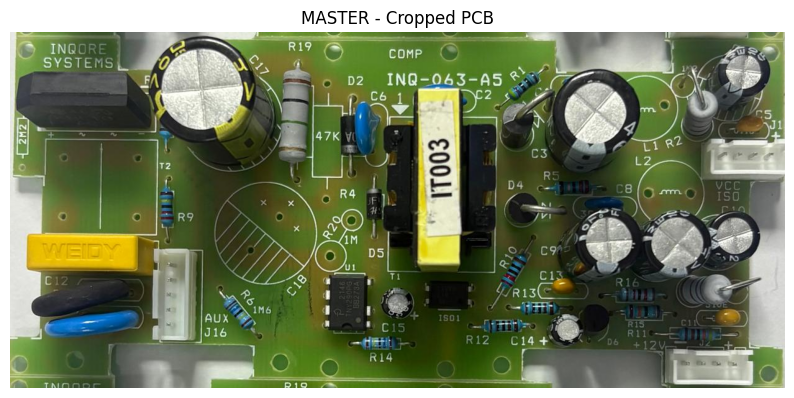

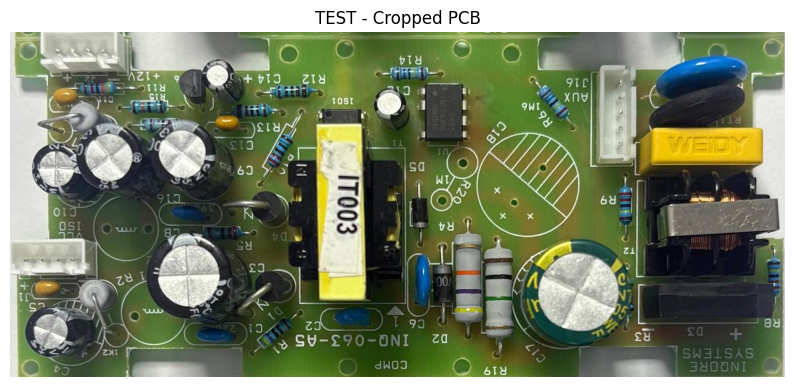

Running conservative YOLO on MASTER (if present) and TEST...


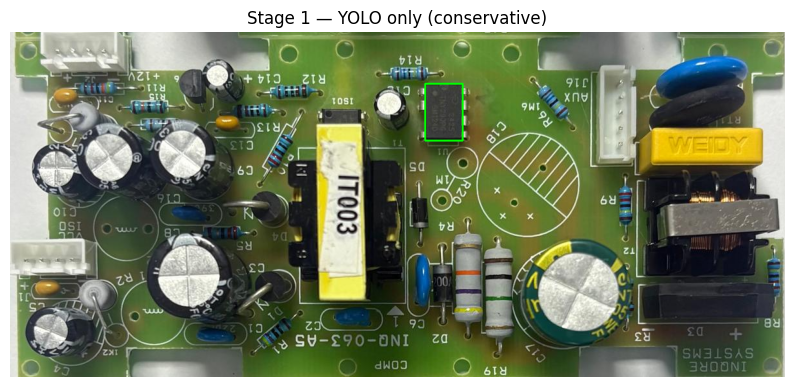

Running SAM on uncovered region (strict filters)...


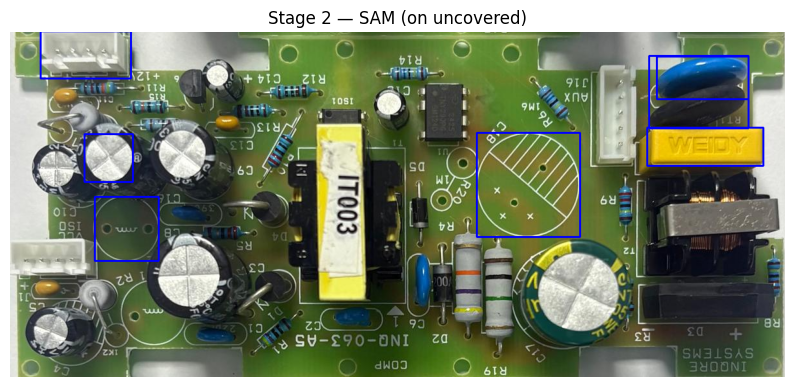

Uncovered pixels remaining: 557003


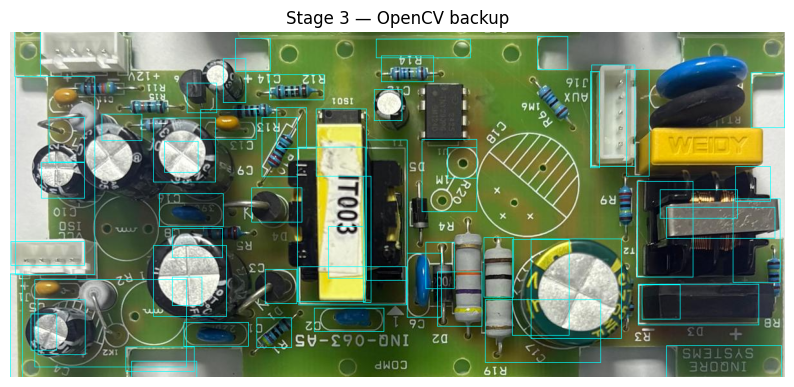

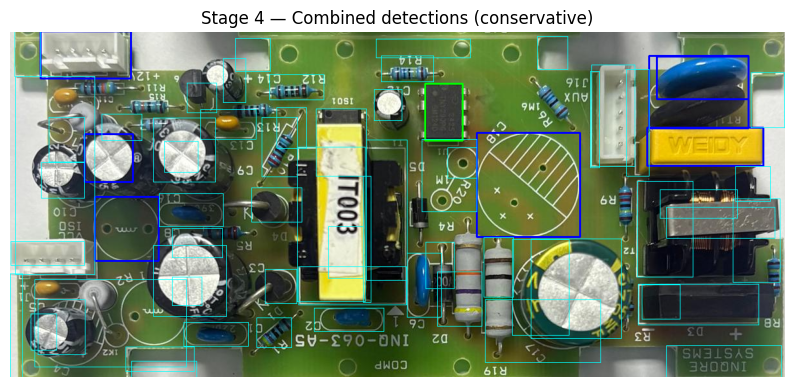

Saved crops: 69 files in /content/pcb_output_stepwise/crops
DEFECTIVE BOARD — 3 missing


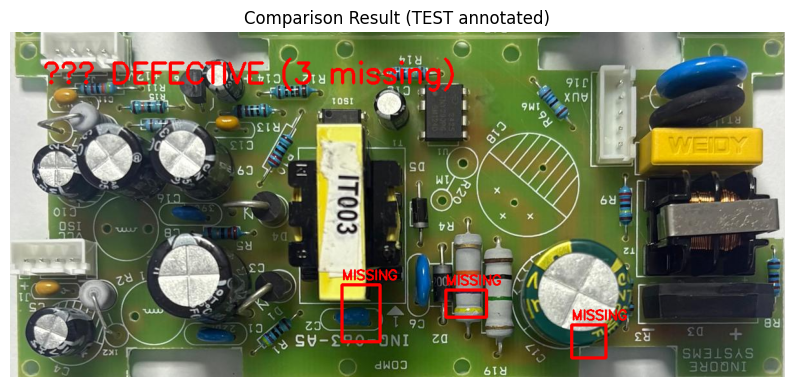

Saved stage images to /content/pcb_output_stepwise
Report saved: /content/pcb_output_stepwise/report_stepwise.json


In [8]:
# ============================
# Stepwise PCB detection pipeline
# YOLO (conservative) -> SAM (on uncovered) -> OpenCV backup -> Comparison & Crops
# ============================

# Install (only in Colab; skip if already installed)
!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything || true

import os, cv2, json, time, importlib
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
import torch

# -------------- CONFIG --------------
OUT_DIR = "/content/pcb_output_stepwise"
CROP_DIR = os.path.join(OUT_DIR, "crops")
os.makedirs(CROP_DIR, exist_ok=True)

# Conservative defaults to avoid aggressive detections:
YOLO_CONF = 0.70           # stricter confidence
YOLO_IMG_SZ = 1280         # inference size (if your model supports it)
MIN_BOX_AREA = 500         # px (filter tiny boxes)
MERGE_IOU = 0.5            # merge threshold for overlapping boxes
SAM_POINTS = 4             # lower -> faster & coarser
SAM_MIN_AREA = 1200        # will ignore tiny SAM masks
IOU_MATCH = 0.45

# If you want to run on the image saved at /mnt/data/download.png, set this True
USE_LOCAL_FILE = True
LOCAL_FILE = "/mnt/data/download.png"

# -------------- Helpers --------------
def show_img(img, figsize=(10,6), title=None):
    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    if title: plt.title(title)
    plt.axis("off")
    plt.show()

def nms_merge_boxes(boxes, scores=None, iou_thresh=MERGE_IOU):
    """Simple NMS-like merging: returns a list of boxes (x1,y1,x2,y2)."""
    if not boxes:
        return []
    boxes = np.array(boxes).astype(float)
    if scores is None:
        scores = np.ones(len(boxes))
    idxs = np.argsort(scores)[::-1]
    keep = []
    while idxs.size:
        i = idxs[0]
        keep.append(boxes[i].astype(int).tolist())
        ious = []
        for j in idxs[1:]:
            A = boxes[i]; B = boxes[j]
            xA = max(A[0], B[0]); yA = max(A[1], B[1])
            xB = min(A[2], B[2]); yB = min(A[3], B[3])
            interW = max(0, xB - xA); interH = max(0, yB - yA)
            inter = interW * interH
            areaA = max(0,(A[2]-A[0])) * max(0,(A[3]-A[1]))
            areaB = max(0,(B[2]-B[0])) * max(0,(B[3]-B[1]))
            denom = (areaA + areaB - inter + 1e-9)
            iou = inter / denom if denom>0 else 0
            ious.append(iou)
        # remove indices with iou > threshold
        idxs = idxs[1:]
        if len(ious)>0:
            idxs = np.array([idx for k, idx in enumerate(idxs) if ious[k] <= iou_thresh])
    return keep

def compute_iou(A,B):
    xA,yA = max(A[0],B[0]), max(A[1],B[1])
    xB,yB = min(A[2],B[2]), min(A[3],B[3])
    interW = max(0, xB-xA); interH = max(0, yB-yA)
    inter = interW * interH
    areaA = max(0,(A[2]-A[0])) * max(0,(A[3]-A[1]))
    areaB = max(0,(B[2]-B[0])) * max(0,(B[3]-B[1]))
    denom = float(areaA + areaB - inter + 1e-9)
    return inter/denom if denom>0 else 0.0

# -------------- Load YOLO model (auto-find in Drive if available) --------------
# If you have a model at /content/drive/My Drive/YOLO/.../best.pt ensure drive is mounted and path correct.
# Here we try a few fallbacks: first check common Drive path, then local directory, else try to use ultralytics default.
MODEL_PATH = None
drive_path = "/content/drive/My Drive/YOLO"
if os.path.exists(drive_path):
    for root, dirs, files in os.walk(drive_path):
        for f in files:
            if f == "best.pt":
                MODEL_PATH = os.path.join(root, f)
                break
        if MODEL_PATH: break

if MODEL_PATH is None:
    # try common local
    if os.path.exists("best.pt"):
        MODEL_PATH = "best.pt"

if MODEL_PATH is None:
    print("No user-trained best.pt found. Ultralitycs will attempt to use a default/official model if available.")
    # you can also set MODEL_PATH to a public ultralytics model name like "yolov8n.pt"
    try:
        MODEL_PATH = "yolov8n.pt"  # tiny official model (requires download)
    except:
        raise FileNotFoundError("No YOLO model found. Upload best.pt to Drive or working dir or set MODEL_PATH manually.")

print("Using YOLO model:", MODEL_PATH)
yolo = YOLO(MODEL_PATH)

# -------------- Load SAM (segment-anything) lightweight settings --------------
use_sam = False
mask_gen = None
try:
    from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
    sam_ck = "/content/sam_vit_b_01ec64.pth"
    if not os.path.exists(sam_ck):
        # this is large; if you prefer MobileSAM change this block
        !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ck}
    sam = sam_model_registry["vit_b"](checkpoint=sam_ck)
    mask_gen = SamAutomaticMaskGenerator(sam,
                                         points_per_side=SAM_POINTS,
                                         pred_iou_thresh=0.9,
                                         stability_score_thresh=0.95,
                                         crop_n_layers=0,
                                         min_mask_region_area=SAM_MIN_AREA)
    use_sam = True
    print("SAM loaded (ViT-B).")
except Exception as e:
    print("SAM import or checkpoint failed; SAM will be disabled. Error:", e)
    use_sam = False

# -------------- Load image(s) --------------
# Option 1: use local /mnt/data/download.png if present
images = []
if USE_LOCAL_FILE and os.path.exists(LOCAL_FILE):
    images.append(("test_local", cv2.imread(LOCAL_FILE)))
else:
    # fallback: allow user uploads in interactive session (Colab)
    files_mod = importlib.import_module("google.colab.files")
    print("Upload MASTER and TEST images (or single image). If you only upload one file the script will process it as TEST only.")
    uploaded = files_mod.upload()
    keys = list(uploaded.keys())
    for k in keys:
        img = cv2.imdecode(np.frombuffer(uploaded[k], np.uint8), cv2.IMREAD_COLOR)
        images.append((k, img))

if not images:
    raise ValueError("No images provided or found.")

# If user uploaded two images, treat first as MASTER, second as TEST
if len(images) >= 2:
    master_name, master_img = images[0]
    test_name, test_img = images[1]
    do_compare = True
else:
    master_name, master_img = None, None
    test_name, test_img = images[0]

# Auto-crop function (from your reference)
def auto_crop_board_color_based(image):
    img = image.copy()
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours)==0:
        h,w = img.shape[:2]; s = 512/max(h,w)
        return cv2.resize(img, (int(w*s), int(h*s))) if s<1 else img
    c = max(contours, key=cv2.contourArea)
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.02*peri, True)
    if len(approx) != 4:
        x,y,w,h = cv2.boundingRect(c)
        return img[y:y+h, x:x+w]
    def order_points(pts):
        rect = np.zeros((4,2), dtype="float32")
        s = pts.sum(axis=1)
        rect[0] = pts[np.argmin(s)]; rect[2] = pts[np.argmax(s)]
        diff = np.diff(pts, axis=1)
        rect[1] = pts[np.argmin(diff)]; rect[3] = pts[np.argmax(diff)]
        return rect
    rect = order_points(approx.reshape(4,2))
    (tl,tr,br,bl) = rect
    widthA = np.linalg.norm(br-bl); widthB = np.linalg.norm(tr-tl)
    heightA = np.linalg.norm(tr-br); heightB = np.linalg.norm(tl-bl)
    maxWidth = int(max(widthA,widthB)); maxHeight = int(max(heightA,heightB))
    dst = np.array([[0,0],[maxWidth-1,0],[maxWidth-1,maxHeight-1],[0,maxHeight-1]], dtype="float32")
    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(img, M, (maxWidth, maxHeight))
    return warped

# Auto-crop both if available
if master_img is not None:
    master_img = auto_crop_board_color_based(master_img)
    show_img(master_img, title="MASTER - Cropped PCB")
test_img = auto_crop_board_color_based(test_img)
show_img(test_img, title="TEST - Cropped PCB")

# ---------- Stage 1: YOLO only (conservative) ----------
def run_yolo(img_bgr, conf=YOLO_CONF, imgsz=YOLO_IMG_SZ):
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    boxes, labels, scores, t = [], [], [], 0.0
    try:
        boxes, labels, scores, t = (lambda: (lambda res: (
            [tuple(map(int, b)) for b in (res[0].boxes.xyxy.cpu().numpy() if len(res)>0 else [])],
            (res[0].boxes.cls.cpu().numpy().astype(int).tolist() if len(res)>0 else []),
            (res[0].boxes.conf.cpu().numpy().tolist() if len(res)>0 else []),
            0.0
        ))(yolo.predict(source=img_rgb, conf=conf, device=("cuda" if torch.cuda.is_available() else "cpu"), imgsz=imgsz, verbose=False)) )()
    except Exception as e:
        # fallback robust path
        res = yolo.predict(source=img_rgb, conf=conf, device=("cuda" if torch.cuda.is_available() else "cpu"), imgsz=imgsz, verbose=False)
        if len(res)>0 and len(res[0].boxes)>0:
            xy = res[0].boxes.xyxy.cpu().numpy()
            confs = res[0].boxes.conf.cpu().numpy()
            cls = res[0].boxes.cls.cpu().numpy().astype(int)
            boxes = [tuple(map(int, xy[i])) for i in range(len(xy)) if confs[i]>=conf]
            scores = [float(c) for c in confs if c>=conf]
    # filter by area
    filtered = []
    filtered_scores = []
    for i, b in enumerate(boxes):
        x1,y1,x2,y2 = b
        area = max(0,(x2-x1))*max(0,(y2-y1))
        if area >= MIN_BOX_AREA:
            filtered.append(b)
            filtered_scores.append(scores[i] if i < len(scores) else 1.0)
    # merge overlapping boxes
    merged = nms_merge_boxes(filtered, filtered_scores, iou_thresh=MERGE_IOU)
    return merged

print("Running conservative YOLO on MASTER (if present) and TEST...")
master_yolo = run_yolo(master_img) if master_img is not None else []
test_yolo   = run_yolo(test_img)

# visualize YOLO stage
vis_yolo = test_img.copy()
for (x1,y1,x2,y2) in test_yolo:
    cv2.rectangle(vis_yolo, (x1,y1),(x2,y2), (0,255,0), 2)
show_img(vis_yolo, title="Stage 1 — YOLO only (conservative)")

# ---------- Stage 2: SAM on uncovered regions ----------
test_mask_yolo = np.zeros(test_img.shape[:2], dtype=np.uint8)
for (x1,y1,x2,y2) in test_yolo:
    cv2.rectangle(test_mask_yolo, (x1,y1), (x2,y2), 255, -1)

test_uncovered = cv2.bitwise_and(cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB), cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB), mask=cv2.bitwise_not(test_mask_yolo))

sam_boxes = []
if use_sam and mask_gen is not None:
    try:
        print("Running SAM on uncovered region (strict filters)...")
        sam_masks = mask_gen.generate(test_uncovered)
        for m in sam_masks:
            seg = m["segmentation"].astype("uint8")
            x,y,w,h = cv2.boundingRect(seg)
            if w*h < SAM_MIN_AREA:
                continue
            # skip if overlapping YOLO (safety)
            if np.any(test_mask_yolo[y:y+h, x:x+w] > 0):
                continue
            sam_boxes.append((x,y,x+w,y+h))
    except Exception as e:
        print("SAM generation failed:", e)
else:
    print("SAM not available — skipping SAM stage.")

# visualize SAM stage
vis_sam = test_img.copy()
for (x1,y1,x2,y2) in sam_boxes:
    cv2.rectangle(vis_sam, (x1,y1),(x2,y2), (255,0,0), 2)
show_img(vis_sam, title="Stage 2 — SAM (on uncovered)")

# ---------- Stage 3: OpenCV edge backup (on remaining uncovered) ----------
mask_all = np.zeros(test_img.shape[:2], dtype=np.uint8)
for b in test_yolo + sam_boxes:
    x1,y1,x2,y2 = b
    cv2.rectangle(mask_all, (x1,y1),(x2,y2), 255, -1)
remain_mask = cv2.bitwise_not(mask_all)
remain_area = np.count_nonzero(remain_mask)
print("Uncovered pixels remaining:", remain_area)

opencv_boxes = []
if remain_area > 1000:
    gray = cv2.cvtColor(test_img, cv2.COLOR_BGR2GRAY)
    # mask so edges only in uncovered area
    edges = cv2.Canny(gray, 70, 160)
    edges = cv2.bitwise_and(edges, edges, mask=remain_mask)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    for c in contours:
        x,y,w,h = cv2.boundingRect(c)
        if w*h < 2000:
            continue
        # skip if overlaps existing boxes >30%
        skip = False
        for b in test_yolo + sam_boxes:
            if compute_iou(b, (x,y,x+w,y+h)) > 0.3:
                skip = True; break
        if not skip:
            opencv_boxes.append((x,y,x+w,y+h))
else:
    print("Remaining area too small — skipping OpenCV backup")

vis_cv = test_img.copy()
for (x1,y1,x2,y2) in opencv_boxes:
    cv2.rectangle(vis_cv, (x1,y1),(x2,y2), (255,255,0), 1)
show_img(vis_cv, title="Stage 3 — OpenCV backup")

# ---------- Combine final boxes and visualize ----------
final_boxes = test_yolo + sam_boxes + opencv_boxes
vis_final = test_img.copy()
for (x1,y1,x2,y2) in test_yolo:
    cv2.rectangle(vis_final, (x1,y1),(x2,y2),(0,255,0),2)
for (x1,y1,x2,y2) in sam_boxes:
    cv2.rectangle(vis_final, (x1,y1),(x2,y2),(255,0,0),2)
for (x1,y1,x2,y2) in opencv_boxes:
    cv2.rectangle(vis_final, (x1,y1),(x2,y2),(255,255,0),1)
show_img(vis_final, title="Stage 4 — Combined detections (conservative)")

# ---------- Cropping (label by source) ----------
def save_crops_by_source(orig_bgr, boxes_by_src, prefix):
    saved=[]
    for src, boxes in boxes_by_src.items():
        for i, (x1,y1,x2,y2) in enumerate(boxes):
            # clamp
            x1 = max(0,x1); y1 = max(0,y1); x2 = min(orig_bgr.shape[1], x2); y2 = min(orig_bgr.shape[0], y2)
            if x2<=x1 or y2<=y1: continue
            crop = orig_bgr[y1:y2, x1:x2]
            fname = os.path.join(CROP_DIR, f"{prefix}_{src}_crop_{i+1}.png")
            cv2.imwrite(fname, crop)
            saved.append(fname)
    return saved

boxes_by_src = {"yolo": test_yolo, "sam": sam_boxes, "cv": opencv_boxes}
saved = save_crops_by_source(test_img, boxes_by_src, "TEST")
print("Saved crops:", len(saved), "files in", CROP_DIR)

# ---------- If MASTER present: do IoU comparison (step-by-step) ----------
if master_img is not None:
    # run same pipeline on master (YOLO only recommended for master)
    master_yolo = run_yolo(master_img)
    master_mask = np.zeros(master_img.shape[:2], dtype=np.uint8)
    for b in master_yolo:
        cv2.rectangle(master_mask, (b[0],b[1]), (b[2],b[3]), 255, -1)
    # Compare master YOLO boxes vs test final boxes
    missing = []
    for mb in master_yolo:
        matched = False
        for tb in final_boxes:
            if compute_iou(mb, tb) >= IOU_MATCH:
                matched = True
                break
        if not matched:
            missing.append(mb)
    # visualize missing
    vis_comp = test_img.copy()
    if len(missing)==0:
        cv2.putText(vis_comp, "✅ GOOD BOARD", (50,80), cv2.FONT_HERSHEY_SIMPLEX, 2, (0,255,0), 4)
        print("GOOD BOARD: all master components matched on test")
    else:
        for (x1,y1,x2,y2) in missing:
            cv2.rectangle(vis_comp,(x1,y1),(x2,y2),(0,0,255),3)
            cv2.putText(vis_comp,"MISSING",(x1,y1-8),cv2.FONT_HERSHEY_SIMPLEX,0.7,(0,0,255),2)
        cv2.putText(vis_comp, f"❌ DEFECTIVE ({len(missing)} missing)", (50,80), cv2.FONT_HERSHEY_SIMPLEX,1.5,(0,0,255),3)
        print(f"DEFECTIVE BOARD — {len(missing)} missing")
    show_img(vis_comp, title="Comparison Result (TEST annotated)")

# ---------- Save final visualization + report ----------
cv2.imwrite(os.path.join(OUT_DIR, "stage1_yolo.png"), vis_yolo)
cv2.imwrite(os.path.join(OUT_DIR, "stage2_sam.png"), vis_sam if 'vis_sam' in locals() else test_img)
cv2.imwrite(os.path.join(OUT_DIR, "stage3_opencv.png"), vis_cv)
cv2.imwrite(os.path.join(OUT_DIR, "final_combined.png"), vis_final)
print("Saved stage images to", OUT_DIR)

report = {
    "yolo_count": len(test_yolo),
    "sam_count": len(sam_boxes),
    "opencv_count": len(opencv_boxes),
    "final_count": len(final_boxes),
    "crops": saved
}
if master_img is not None:
    report["missing_count"] = len(missing)
    report["missing_boxes"] = [{"x1":int(b[0]),"y1":int(b[1]),"x2":int(b[2]),"y2":int(b[3])} for b in missing]

with open(os.path.join(OUT_DIR, "report_stepwise.json"), "w") as f:
    json.dump(report, f, indent=2)

print("Report saved:", os.path.join(OUT_DIR, "report_stepwise.json"))


Loading YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
Device: cuda
SAM loaded.
Upload a single PCB image (the script will crop then detect):


Saving tesssttt.jpeg to tesssttt (3).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (3).jpeg
Image loaded: tesssttt (3).jpeg
Auto-cropping the PCB region (color-based)...


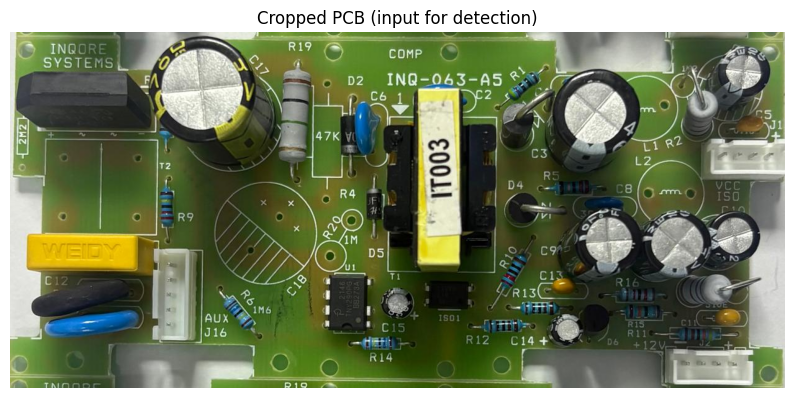

Running YOLO (conservative)...
YOLO finished in 0.09s — kept 3 boxes.


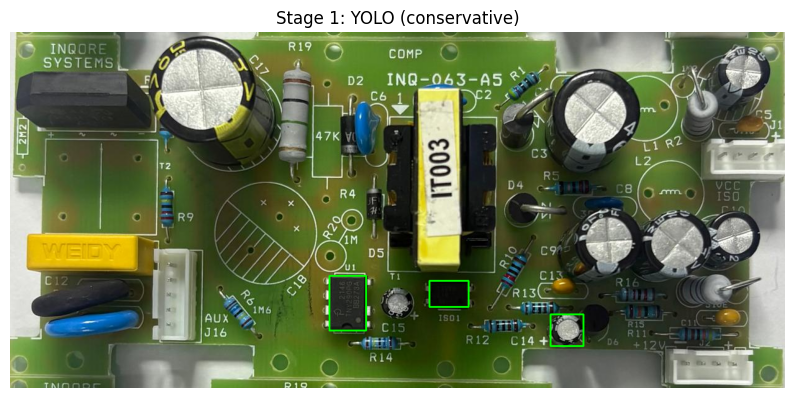

Preparing mask of YOLO-covered regions for SAM to avoid double-detecting...
Running SAM on uncovered area (this may take a while)...
SAM added boxes: 5


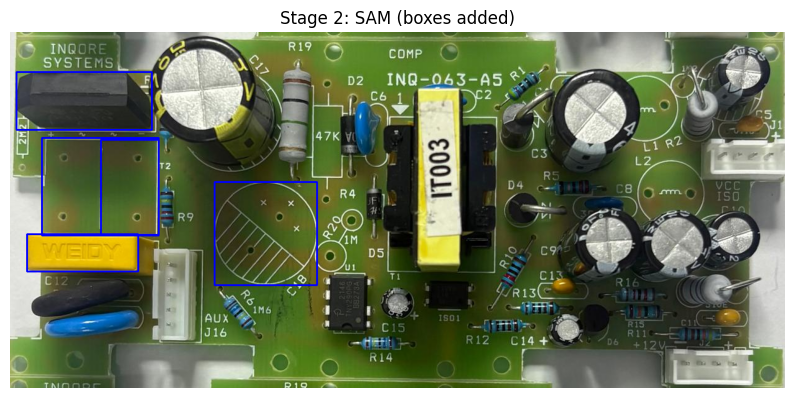

Running OpenCV edge-based backup on remaining uncovered regions...
Remaining uncovered pixels: 615522
OpenCV added boxes: 62


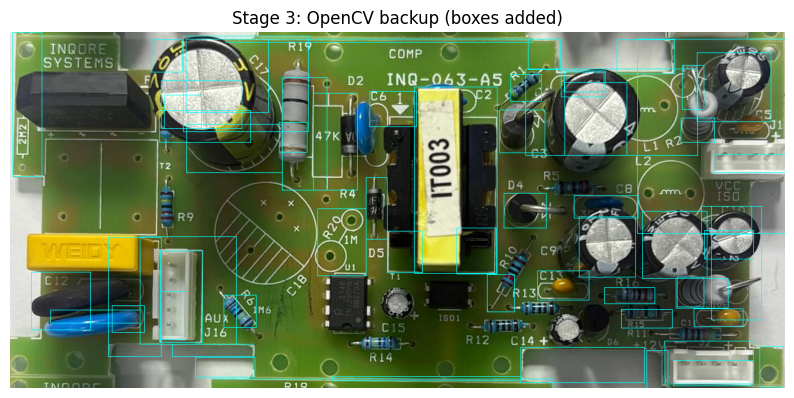

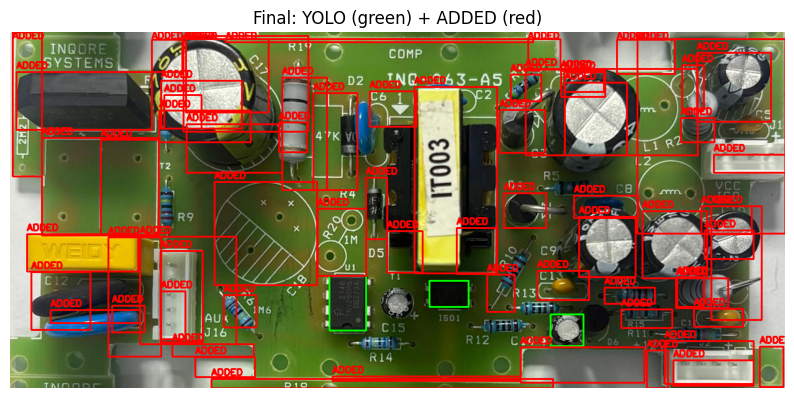

Saved stage images to: /content/pcb_single_output
Saved crops to: /content/pcb_single_output/crops
Saved report: /content/pcb_single_output/detection_report.json
Done — final image, crops and report are in: /content/pcb_single_output


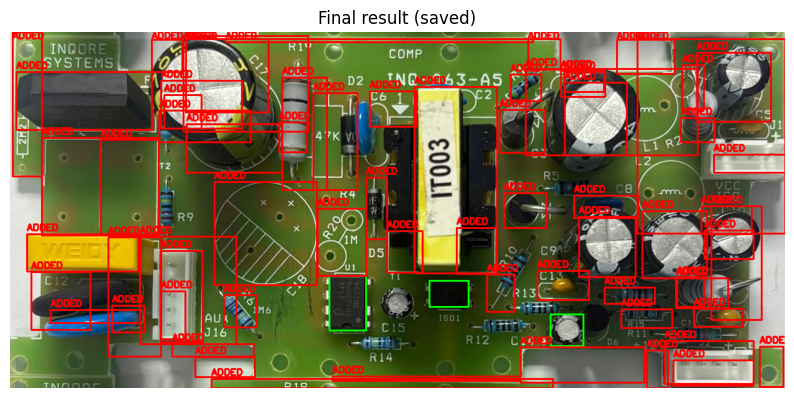

In [9]:
# ==============================================================
# Single-image stepwise PCB detection (YOLO -> SAM -> OpenCV)
# Detect components slowly & carefully, then "add" missing parts found later
# ==============================================================
# Run in Google Colab

# Install (Colab)
!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything || true

# ------------------------------
# Imports
# ------------------------------
import os, time, json, importlib
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
import torch

# ------------------------------
# Output folders + params
# ------------------------------
OUT_DIR = "/content/pcb_single_output"
CROP_DIR = os.path.join(OUT_DIR, "crops")
os.makedirs(CROP_DIR, exist_ok=True)

# Tuning parameters (conservative by default)
YOLO_CONF = 0.72        # higher confidence to avoid false positives
YOLO_IMGSZ = 1280       # inference image size (model must support it)
MIN_BOX_AREA = 600      # minimum area for YOLO boxes (px)
MERGE_IOU = 0.45        # merge similar YOLO boxes
SAM_POINTS = 4          # low -> faster & coarser masks
SAM_MIN_AREA = 1200     # ignore small SAM masks
OPENCV_MIN_AREA = 2000  # ignore small OpenCV contours
IOU_SKIP = 0.30         # skip SAM/OpenCV if overlaps YOLO above this IoU

# ------------------------------
# Utility display
# ------------------------------
def show(img, title=None, figsize=(10,6)):
    plt.figure(figsize=figsize)
    # convert BGR->RGB if necessary
    if img.ndim == 3 and img.shape[2] == 3:
        disp = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    else:
        disp = img
    plt.imshow(disp)
    if title: plt.title(title)
    plt.axis('off')
    plt.show()

# ------------------------------
# Auto-crop function (your reference)
# ------------------------------
def auto_crop_board_color_based(image):
    img = image.copy()
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours)==0:
        h,w = img.shape[:2]
        s = 512/max(h,w)
        return cv2.resize(img, (int(w*s), int(h*s))) if s<1 else img
    c = max(contours, key=cv2.contourArea)
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.02*peri, True)
    if len(approx) != 4:
        x,y,w,h = cv2.boundingRect(c)
        return img[y:y+h, x:x+w]
    def order_points(pts):
        rect = np.zeros((4,2), dtype="float32")
        s = pts.sum(axis=1)
        rect[0] = pts[np.argmin(s)]; rect[2] = pts[np.argmax(s)]
        diff = np.diff(pts, axis=1)
        rect[1] = pts[np.argmin(diff)]; rect[3] = pts[np.argmax(diff)]
        return rect
    rect = order_points(approx.reshape(4,2))
    (tl,tr,br,bl) = rect
    widthA = np.linalg.norm(br-bl); widthB = np.linalg.norm(tr-tl)
    heightA = np.linalg.norm(tr-br); heightB = np.linalg.norm(tl-bl)
    maxWidth = int(max(widthA,widthB)); maxHeight = int(max(heightA,heightB))
    dst = np.array([[0,0],[maxWidth-1,0],[maxWidth-1,maxHeight-1],[0,maxHeight-1]], dtype="float32")
    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(img, M, (maxWidth, maxHeight))
    return warped

# ------------------------------
# NMS-like merge for boxes
# ------------------------------
def merge_boxes_nms(boxes, scores=None, iou_thresh=MERGE_IOU):
    if not boxes:
        return []
    boxes = np.array(boxes).astype(float)
    if scores is None:
        scores = np.ones(len(boxes))
    idxs = np.argsort(scores)[::-1]
    keep = []
    while len(idxs)>0:
        i = idxs[0]
        keep.append(boxes[i].astype(int).tolist())
        rest = idxs[1:]
        remain = []
        for j in rest:
            A = boxes[i]; B = boxes[j]
            xA = max(A[0], B[0]); yA = max(A[1], B[1])
            xB = min(A[2], B[2]); yB = min(A[3], B[3])
            interW = max(0, xB-xA); interH = max(0, yB-yA)
            inter = interW*interH
            areaA = max(0,(A[2]-A[0]))*max(0,(A[3]-A[1]))
            areaB = max(0,(B[2]-B[0]))*max(0,(B[3]-B[1]))
            denom = (areaA + areaB - inter + 1e-9)
            iou = inter/denom if denom>0 else 0
            if iou <= iou_thresh:
                remain.append(j)
        idxs = np.array(remain)
    return keep

def iou(A,B):
    xA,yA = max(A[0],B[0]), max(A[1],B[1])
    xB,yB = min(A[2],B[2]), min(A[3],B[3])
    interW = max(0, xB-xA); interH = max(0, yB-yA)
    inter = interW*interH
    areaA = max(0,(A[2]-A[0]))*max(0,(A[3]-A[1]))
    areaB = max(0,(B[2]-B[0]))*max(0,(B[3]-B[1]))
    denom = float(areaA + areaB - inter + 1e-9)
    return inter/denom if denom>0 else 0.0

# ------------------------------
# Find YOLO model: try Drive, local, else tiny official
# ------------------------------
MODEL_PATH = None
drive_candidate = "/content/drive/My Drive/YOLO"
if os.path.exists(drive_candidate):
    for root,dirs,files in os.walk(drive_candidate):
        for f in files:
            if f == "best.pt":
                MODEL_PATH = os.path.join(root,f)
                break
        if MODEL_PATH: break

if MODEL_PATH is None and os.path.exists("best.pt"):
    MODEL_PATH = "best.pt"

if MODEL_PATH is None:
    print("No best.pt found in Drive/local. Using ultralytics 'yolov8n.pt' (will download).")
    MODEL_PATH = "yolov8n.pt"

print("Loading YOLO model:", MODEL_PATH)
yolo = YOLO(MODEL_PATH)
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Device:", device)

# ------------------------------
# Try to load SAM (SegmentAnything). If unavailable, SAM will be skipped.
# ------------------------------
use_sam = False
mask_generator = None
try:
    from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
    sam_ck = "/content/sam_vit_b_01ec64.pth"
    if not os.path.exists(sam_ck):
        print("Downloading SAM ViT-B checkpoint (if you prefer MobileSAM, replace this).")
        !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ck}
    sam = sam_model_registry["vit_b"](checkpoint=sam_ck)
    mask_generator = SamAutomaticMaskGenerator(
        sam,
        points_per_side=SAM_POINTS,
        pred_iou_thresh=0.9,
        stability_score_thresh=0.95,
        crop_n_layers=0,
        min_mask_region_area=SAM_MIN_AREA
    )
    use_sam = True
    print("SAM loaded.")
except Exception as e:
    print("SAM not available or failed to load — continuing without SAM. Error:", e)
    use_sam = False

# ------------------------------
# Upload single image (Colab) or use local path
# ------------------------------
files_mod = importlib.import_module("google.colab.files")
print("Upload a single PCB image (the script will crop then detect):")
uploaded = files_mod.upload()
if len(uploaded) == 0:
    raise ValueError("Please upload one PCB image.")
img_name = list(uploaded.keys())[0]
img_bgr = cv2.imdecode(np.frombuffer(uploaded[img_name], np.uint8), cv2.IMREAD_COLOR)
if img_bgr is None:
    raise ValueError("Failed to read uploaded image.")
print("Image loaded:", img_name)

# ------------------------------
# Step 0: Auto-crop PCB
# ------------------------------
print("Auto-cropping the PCB region (color-based)...")
cropped = auto_crop_board_color_based(img_bgr)
show(cropped, title="Cropped PCB (input for detection)")

# keep original cropped for final mapping/crops
orig_cropped = cropped.copy()

# ------------------------------
# Step 1: YOLO detection (conservative)
# ------------------------------
print("Running YOLO (conservative)...")
t0 = time.time()
# yolo.predict accepts numpy rgb
rgb = cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB)
res = yolo.predict(source=rgb, conf=YOLO_CONF, device=device, imgsz=YOLO_IMGSZ, verbose=False)
t1 = time.time()
yolo_boxes = []
yolo_scores = []

if len(res) > 0:
    r = res[0]
    if hasattr(r, "boxes") and len(r.boxes):
        xy = r.boxes.xyxy.cpu().numpy()
        confs = r.boxes.conf.cpu().numpy()
        for i, (x1,y1,x2,y2) in enumerate(xy):
            score = float(confs[i])
            if score >= YOLO_CONF:
                area = max(0, int(round(x2-x1))) * max(0, int(round(y2-y1)))
                if area >= MIN_BOX_AREA:
                    yolo_boxes.append((int(x1),int(y1),int(x2),int(y2)))
                    yolo_scores.append(score)

# Merge overlapping YOLO boxes
yolo_boxes = merge_boxes_nms(yolo_boxes, yolo_scores, iou_thresh=MERGE_IOU)

print(f"YOLO finished in {t1-t0:.2f}s — kept {len(yolo_boxes)} boxes.")
vis_yolo = cropped.copy()
for (x1,y1,x2,y2) in yolo_boxes:
    cv2.rectangle(vis_yolo, (x1,y1),(x2,y2), (0,255,0), 2)
show(vis_yolo, title="Stage 1: YOLO (conservative)")

# ------------------------------
# Step 2: SAM on uncovered regions (strict)
# ------------------------------
sam_boxes = []
if use_sam and mask_generator is not None:
    print("Preparing mask of YOLO-covered regions for SAM to avoid double-detecting...")
    mask_yolo = np.zeros(cropped.shape[:2], dtype=np.uint8)
    for (x1,y1,x2,y2) in yolo_boxes:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)
    inv_mask = cv2.bitwise_not(mask_yolo)
    uncovered_rgb = cv2.bitwise_and(rgb, rgb, mask=inv_mask)
    # Run SAM on uncovered area
    print("Running SAM on uncovered area (this may take a while)...")
    try:
        sam_masks = mask_generator.generate(uncovered_rgb)
    except Exception as e:
        print("SAM generate failed:", e)
        sam_masks = []
    for m in sam_masks:
        seg = m["segmentation"].astype("uint8")
        x,y,w,h = cv2.boundingRect(seg)
        if w*h < SAM_MIN_AREA:
            continue
        # skip if overlaps YOLO heavily
        overlap = False
        for b in yolo_boxes:
            if iou((x,y,x+w,y+h), b) > IOU_SKIP:
                overlap = True
                break
        if not overlap:
            sam_boxes.append((x,y,x+w,y+h))
    print("SAM added boxes:", len(sam_boxes))
else:
    print("SAM not used (not installed or failed) — skipping SAM stage.")

vis_sam = cropped.copy()
for (x1,y1,x2,y2) in sam_boxes:
    cv2.rectangle(vis_sam,(x1,y1),(x2,y2),(255,0,0),2)
show(vis_sam, title="Stage 2: SAM (boxes added)")

# ------------------------------
# Step 3: OpenCV edge-detection backup on remaining uncovered
# ------------------------------
print("Running OpenCV edge-based backup on remaining uncovered regions...")
mask_all = np.zeros(cropped.shape[:2], dtype=np.uint8)
for b in yolo_boxes + sam_boxes:
    cv2.rectangle(mask_all, (b[0],b[1]), (b[2],b[3]), 255, -1)
remain_mask = cv2.bitwise_not(mask_all)
remain_pixels = np.count_nonzero(remain_mask)
print("Remaining uncovered pixels:", remain_pixels)

opencv_boxes = []
if remain_pixels > 1000:
    gray = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray, 70, 160)
    edges = cv2.bitwise_and(edges, edges, mask=remain_mask)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    for c in contours:
        x,y,w,h = cv2.boundingRect(c)
        if w*h < OPENCV_MIN_AREA:
            continue
        # skip if overlaps existing boxes
        skip = False
        for b in (yolo_boxes + sam_boxes):
            if iou((x,y,x+w,y+h), b) > IOU_SKIP:
                skip = True
                break
        if not skip:
            opencv_boxes.append((x,y,x+w,y+h))
    print("OpenCV added boxes:", len(opencv_boxes))
else:
    print("Not enough uncovered area — skipping OpenCV backup.")

vis_cv = cropped.copy()
for (x1,y1,x2,y2) in opencv_boxes:
    cv2.rectangle(vis_cv,(x1,y1),(x2,y2),(255,255,0),1)
show(vis_cv, title="Stage 3: OpenCV backup (boxes added)")

# ------------------------------
# Combine boxes and mark added ones (SAM/OpenCV)
# ------------------------------
final_boxes = []
source_tags = []
# YOLO boxes first (trusted)
for b in yolo_boxes:
    final_boxes.append(b); source_tags.append("yolo")
# SAM-added boxes
for b in sam_boxes:
    final_boxes.append(b); source_tags.append("sam_added")
# OpenCV-added boxes
for b in opencv_boxes:
    final_boxes.append(b); source_tags.append("opencv_added")

# Visualize final
vis_final = cropped.copy()
for b,src in zip(final_boxes, source_tags):
    x1,y1,x2,y2 = b
    if src == "yolo":
        color = (0,255,0)
        thickness = 2
    else:
        color = (0,0,255)   # red for added boxes
        thickness = 2
    cv2.rectangle(vis_final,(x1,y1),(x2,y2), color, thickness)
    if src != "yolo":
        # mark added ones clearly
        cv2.putText(vis_final, "ADDED", (x1, max(10,y1-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
show(vis_final, title="Final: YOLO (green) + ADDED (red)")

# ------------------------------
# Save visuals
# ------------------------------
cv2.imwrite(os.path.join(OUT_DIR, "stage1_yolo.png"), cv2.cvtColor(vis_yolo, cv2.COLOR_BGR2RGB))
cv2.imwrite(os.path.join(OUT_DIR, "stage2_sam.png"), cv2.cvtColor(vis_sam, cv2.COLOR_BGR2RGB))
cv2.imwrite(os.path.join(OUT_DIR, "stage3_opencv.png"), cv2.cvtColor(vis_cv, cv2.COLOR_BGR2RGB))
cv2.imwrite(os.path.join(OUT_DIR, "final_boxes.png"), cv2.cvtColor(vis_final, cv2.COLOR_BGR2RGB))
print("Saved stage images to:", OUT_DIR)

# ------------------------------
# Save crops by source and build JSON report
# ------------------------------
def save_crops_and_report(orig_image, boxes, tags, prefix="img"):
    crops = []
    for idx, (b,tag) in enumerate(zip(boxes, tags)):
        x1,y1,x2,y2 = b
        x1 = max(0,x1); y1 = max(0,y1); x2 = min(orig_image.shape[1], x2); y2 = min(orig_image.shape[0], y2)
        if x2 <= x1 or y2 <= y1:
            continue
        crop = orig_image[y1:y2, x1:x2]
        fname = os.path.join(CROP_DIR, f"{prefix}_{tag}_crop_{idx+1}.png")
        cv2.imwrite(fname, crop)
        crops.append({"file": fname, "tag": tag, "box": [int(x1),int(y1),int(x2),int(y2)]})
    return crops

crops = save_crops_and_report(cropped, final_boxes, source_tags, prefix=os.path.splitext(img_name)[0])
report = {
    "input_image": img_name,
    "yolo_count": len(yolo_boxes),
    "sam_added": len(sam_boxes),
    "opencv_added": len(opencv_boxes),
    "final_count": len(final_boxes),
    "crops": crops
}
with open(os.path.join(OUT_DIR, "detection_report.json"), "w") as f:
    json.dump(report, f, indent=2)
print("Saved crops to:", CROP_DIR)
print("Saved report:", os.path.join(OUT_DIR, "detection_report.json"))

# ------------------------------
# Completed
# ------------------------------
print("Done — final image, crops and report are in:", OUT_DIR)
show(vis_final, title="Final result (saved)")


In [ ]:

# ==============================================================
# 🧠 PCB COMPONENT DETECTION — YOLO + SAM + OpenCV + Cropping
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ==============================================================
# 🧩 Imports
# ==============================================================
import os, cv2, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output"
CROP_DIR = f"{OUT_DIR}/crops"
os.makedirs(CROP_DIR, exist_ok=True)

drive.mount('/content/drive')
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Load YOLO model
# ==============================================================
# Auto-find your trained YOLO model (latest best.pt)
search_root = "/content/drive/My Drive/YOLO"
found_models = []
for root, dirs, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            found_models.append(os.path.join(root, f))
if not found_models:
    raise FileNotFoundError("❌ No best.pt found in your Drive.")
MODEL_PATH = sorted(found_models, key=os.path.getmtime, reverse=True)[0]
print(f"✅ Using YOLO model: {MODEL_PATH}")

model = YOLO(MODEL_PATH)

# ==============================================================
# 📤 Upload a single PCB image
# ==============================================================
print("📸 Please upload a PCB image:")
uploaded = files.upload()
image_path = list(uploaded.keys())[0]
image = cv2.imread(image_path)
if image is None:
    raise ValueError("❌ Image failed to load.")
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
print(f"✅ Image uploaded: {image_path}")

# ==============================================================
# 🔍 STEP 1 — YOLO Detection
# ==============================================================
print("🟩 Running YOLO detection...")
yolo_results = model.predict(source=image_rgb, conf=0.6, verbose=False)
yolo_boxes = []

for result in yolo_results:
    for box in result.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0].cpu().numpy())
        conf = float(box.conf)
        cls = int(box.cls)
        label = result.names[cls]
        if conf > 0.6:
            yolo_boxes.append((x1, y1, x2, y2, label, conf))

yolo_image = image_rgb.copy()
for (x1, y1, x2, y2, label, conf) in yolo_boxes:
    cv2.rectangle(yolo_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(yolo_image, f"{label}", (x1, y1 - 5),
                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

print(f"✅ YOLO detected {len(yolo_boxes)} components.")

# ==============================================================
# 🧠 STEP 2 — SAM Segmentation (for missing/unboxed areas)
# ==============================================================
print("🔵 Loading SAM model...")
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth

sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
mask_generator = SamAutomaticMaskGenerator(
    sam,
    points_per_side=8,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=0,
    min_mask_region_area=1000
)
print("✅ SAM model ready!")

# Create a mask to track YOLO-covered areas
mask_yolo = np.zeros(image.shape[:2], dtype=np.uint8)
for (x1, y1, x2, y2, _, _) in yolo_boxes:
    cv2.rectangle(mask_yolo, (x1, y1), (x2, y2), 255, -1)

# Run SAM only on uncovered regions
inverse_mask = cv2.bitwise_not(mask_yolo)
uncovered = cv2.bitwise_and(image_rgb, image_rgb, mask=inverse_mask)

print("🔵 Running SAM on uncovered regions...")
masks = mask_generator.generate(uncovered)
sam_image = image_rgb.copy()
sam_boxes = []

for m in masks:
    seg = m["segmentation"].astype('uint8')
    x, y, w, h = cv2.boundingRect(seg)
    overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
    if not overlap and w*h > 1000:  # skip overlapping YOLO boxes
        cv2.rectangle(sam_image, (x, y), (x+w, y+h), (255, 0, 0), 2)
        sam_boxes.append((x, y, x+w, y+h))

print(f"✅ SAM added {len(sam_boxes)} new boxes.")

# ==============================================================
# ⚙️ STEP 3 — OpenCV Edge-based Backup Detection
# ==============================================================
print("🟠 Running OpenCV edge detection as backup...")
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
edges = cv2.Canny(gray, 60, 150)
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
opencv_boxes = []

for c in contours:
    x, y, w, h = cv2.boundingRect(c)
    overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
    if w*h > 2000 and not overlap:
        cv2.rectangle(image_rgb, (x, y), (x+w, y+h), (255, 255, 0), 1)
        opencv_boxes.append((x, y, x+w, y+h))

print(f"✅ OpenCV added {len(opencv_boxes)} boxes.")

# ==============================================================
# 🖼️ STEP 4 — Combine and Visualize All Boxes
# ==============================================================
final = image_rgb.copy()

# Draw YOLO boxes (green)
for (x1, y1, x2, y2, _, _) in yolo_boxes:
    cv2.rectangle(final, (x1, y1), (x2, y2), (0, 255, 0), 2)

# Draw SAM boxes (blue)
for (x1, y1, x2, y2) in sam_boxes:
    cv2.rectangle(final, (x1, y1), (x2, y2), (255, 0, 0), 2)

# Draw OpenCV boxes (yellow)
for (x1, y1, x2, y2) in opencv_boxes:
    cv2.rectangle(final, (x1, y1), (x2, y2), (255, 255, 0), 1)

plt.figure(figsize=(10, 10))
plt.imshow(final)
plt.title("Combined YOLO (Green) + SAM (Blue) + OpenCV (Yellow)")
plt.axis('off')
plt.show()

cv2.imwrite(f"{OUT_DIR}/final_combined_detections.png", cv2.cvtColor(final, cv2.COLOR_RGB2BGR))
print(f"💾 Saved combined detection image at: {OUT_DIR}/final_combined_detections.png")

# ==============================================================
# ✂️ STEP 5 — Auto-Cropping of All Detected Components
# ==============================================================
print("✂️ Cropping detected regions...")
all_boxes = yolo_boxes + [(x1, y1, x2, y2, "sam", 1) for (x1, y1, x2, y2) in sam_boxes] + [(x1, y1, x2, y2, "opencv", 1) for (x1, y1, x2, y2) in opencv_boxes]
for i, (x1, y1, x2, y2, src, _) in enumerate(all_boxes):
    crop = image[y1:y2, x1:x2]
    if crop.size == 0: continue
    cv2.imwrite(f"{CROP_DIR}/{src}_crop_{i}.png", crop)

print(f"✅ Cropped {len(all_boxes)} component regions.")
print(f"📁 Crops saved to: {CROP_DIR}")
use this code for boxing each component and then use the below code for cropping
# -------------------------------
# Step 1: Imports
# -------------------------------
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files

# -------------------------------
# Step 2: Upload image
# -------------------------------
print("📤 Upload the PCB image you want to crop:")
uploaded = files.upload()

filename = list(uploaded.keys())[0]
print(f"✅ Image uploaded: {filename}")

# -------------------------------
# Step 3: Improved PCB Cropping Function
# -------------------------------
def auto_crop_board_color_based(image):
    img = image.copy()
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # 🎨 Define color range for PCB (tuned for green/teal boards)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])

    # 🧠 Create color mask
    mask = cv2.inRange(hsv, lower_green, upper_green)

    # 🧹 Morphological cleanup
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7, 7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)

    # ✏️ Find contours from mask
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if len(contours) == 0:
        print("⚠️ No PCB region detected via color — fallback to full image.")
        return cv2.resize(img, (512, 512))

    # 🎯 Select largest contour (most likely the PCB)
    c = max(contours, key=cv2.contourArea)

    # Approximate to get corners
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.02 * peri, True)

    if len(approx) != 4:
        # If not perfect 4-corner, get bounding rectangle
        x, y, w, h = cv2.boundingRect(c)
        cropped = img[y:y + h, x:x + w]
        return cropped

    # 🧭 Order corner points
    def order_points(pts):
        rect = np.zeros((4, 2), dtype="float32")
        s = pts.sum(axis=1)
        rect[0] = pts[np.argmin(s)]      # top-left
        rect[2] = pts[np.argmax(s)]      # bottom-right
        diff = np.diff(pts, axis=1)
        rect[1] = pts[np.argmin(diff)]   # top-right
        rect[3] = pts[np.argmax(diff)]   # bottom-left
        return rect

    rect = order_points(approx.reshape(4, 2))
    (tl, tr, br, bl) = rect

    # Compute new perspective size
    widthA = np.linalg.norm(br - bl)
    widthB = np.linalg.norm(tr - tl)
    heightA = np.linalg.norm(tr - br)
    heightB = np.linalg.norm(tl - bl)
    maxWidth = int(max(widthA, widthB))
    maxHeight = int(max(heightA, heightB))

    # Warp perspective (get perfect top-down PCB)
    dst = np.array([
        [0, 0],
        [maxWidth - 1, 0],
        [maxWidth - 1, maxHeight - 1],
        [0, maxHeight - 1]], dtype="float32")

    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(img, M, (maxWidth, maxHeight))

    return warped

# -------------------------------
# Step 4: Read, crop, and show result
# -------------------------------
img = cv2.imread(filename)
cropped = auto_crop_board_color_based(img)

# Convert BGR → RGB for display
cropped_rgb = cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 6))
plt.imshow(cropped_rgb)
plt.axis('off')
plt.title("🟩 Perfectly Cropped PCB Region")
plt.show()

# -------------------------------
# Step 5: Save Output
# -------------------------------
output_name = "cropped_pcb_clean.jpg"
cv2.imwrite(output_name, cropped)
print(f"💾 Cropped image saved as: {output_name}")
files.download(output_name)
and use the below code for yolo object detection
# ==============================================================
# 🧠 PCB COMPONENT COMPARISON — YOLOv8 | Upload Images | JSON | Visual Diff
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy

# ==============================================================
# 🧠 Imports
# ==============================================================
import os, cv2, json, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from google.colab import files

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output"
os.makedirs(OUT_DIR, exist_ok=True)

# ==============================================================
# 🔍 Auto-Find the Latest YOLO Model (best.pt)
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found_models = []

for root, dirs, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            full_path = os.path.join(root, f)
            found_models.append((full_path, os.path.getmtime(full_path)))

if not found_models:
    raise FileNotFoundError("❌ No 'best.pt' found in your Drive. Please train or upload the model.")

found_models.sort(key=lambda x: x[1], reverse=True)
MODEL_PATH = found_models[0][0]

print(f"✅ Found and loaded latest YOLO model:\n{MODEL_PATH}")
model = YOLO(MODEL_PATH)

# ==============================================================
# ✂️ Auto-Crop PCB Area (Green Segmentation)
# ==============================================================
def auto_crop_board(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        print("⚠️ No green PCB region detected — using full image.")
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    print(f"📏 Cropped PCB region: x={x}, y={y}, w={w}, h={h}")
    return image[y:y+h, x:x+w]

# ==============================================================
# 🧩 YOLO Detection Function
# ==============================================================
def detect_with_yolo(image, prefix="PCB"):
    results = model(image)
    annotated = results[0].plot()
    comps = []
    for i, box in enumerate(results[0].boxes):
        cls_id = int(box.cls)
        label = results[0].names[cls_id]
        x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
        comps.append({
            "id": f"{prefix}{i}",
            "label": label,
            "position": [int(x1), int(y1), int(x2 - x1), int(y2 - y1)]
        })
    return annotated, comps

# ==============================================================
# 📤 Upload MASTER and TEST PCB Images
# ==============================================================
print("\n📸 Upload your MASTER and TEST PCB images:")
uploaded = files.upload()
paths = list(uploaded.keys())

if len(paths) < 2:
    raise ValueError("❌ Please upload both MASTER and TEST PCB images.")

master_img = cv2.imread(paths[0])
test_img   = cv2.imread(paths[1])
print(f"✅ Images loaded:\n - Master: {paths[0]}\n - Test: {paths[1]}")

# ==============================================================
# 🔍 Detection + JSON Export
# ==============================================================
master_crop = auto_crop_board(master_img)
test_crop   = auto_crop_board(test_img)

master_detected, master_comps = detect_with_yolo(master_crop, "M")
test_detected, test_comps = detect_with_yolo(test_crop, "T")

master_json = {"components": master_comps}
test_json   = {"components": test_comps}

cv2.imwrite(f"{OUT_DIR}/master_detected.png", master_detected)
cv2.imwrite(f"{OUT_DIR}/test_detected.png", test_detected)
with open(f"{OUT_DIR}/master.json", "w") as f: json.dump(master_json, f, indent=2)
with open(f"{OUT_DIR}/test.json", "w") as f: json.dump(test_json, f, indent=2)

print(f"✅ YOLO detection complete.\n📂 Results saved to: {OUT_DIR}")

# ==============================================================
# 🔁 JSON Comparison + Visual Markup
# ==============================================================
def compare_json(master, test):
    diffs = []
    for m in master["components"]:
        match = next((t for t in test["components"] if t["label"] == m["label"]), None)
        if not match:
            diffs.append({"label": m["label"], "status": "missing", "position": m["position"]})
        else:
            dx = abs(m["position"][0] - match["position"][0])
            dy = abs(m["position"][1] - match["position"][1])
            if dx > 10 or dy > 10:
                diffs.append({
                    "label": m["label"],
                    "status": "moved",
                    "old_position": m["position"],
                    "new_position": match["position"]
                })
    return {"differences": diffs}

def visualize_differences(diff_json, test_img):
    for d in diff_json["differences"]:
        if d["status"] == "missing":
            x, y, w, h = d["position"]
            cv2.rectangle(test_img, (x, y), (x+w, y+h), (0, 0, 255), 2)
            cv2.putText(test_img, f"{d['label']} missing", (x, y-5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 1)
        elif d["status"] == "moved":
            nx, ny, nw, nh = d["new_position"]
            cv2.rectangle(test_img, (nx, ny), (nx+nw, ny+nh), (0,0,255), 2)
            cv2.putText(test_img, f"{d['label']} moved", (nx, ny-5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 1)
    return test_img

diff_json = compare_json(master_json, test_json)
with open(f"{OUT_DIR}/differences.json", "w") as f: json.dump(diff_json, f, indent=2)

visualized = visualize_differences(diff_json, test_detected.copy())
cv2.imwrite(f"{OUT_DIR}/difference_visual.png", visualized)

plt.imshow(cv2.cvtColor(visualized, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()

print("\n🟥 Visual comparison saved at:", f"{OUT_DIR}/difference_visual.png")
print("📊 JSON differences saved at:", f"{OUT_DIR}/differences.json")
reference code

Mounting Google Drive (optional) ...
Mounted at /content/drive
Drive mounted.
Searching for YOLO model (best.pt) in Drive and local dirs...
Using YOLO model path: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
YOLO loaded. Device: cuda
SAM ViT-B loaded successfully.
Please upload two images: MASTER first, then TEST.


Saving tesssttt.jpeg to tesssttt (4).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (4).jpeg
Uploaded: MASTER=tesssttt (4).jpeg, TEST=Masterrrrrr (4).jpeg
Auto-cropping MASTER and TEST PCBs (color-based)...
MASTER crop shape: (573, 1248, 3), scale: 1.0
TEST  crop shape: (535, 1201, 3), scale: 1.0


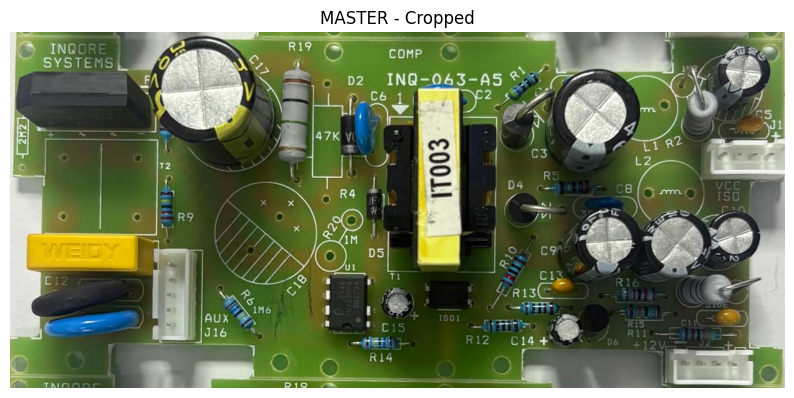

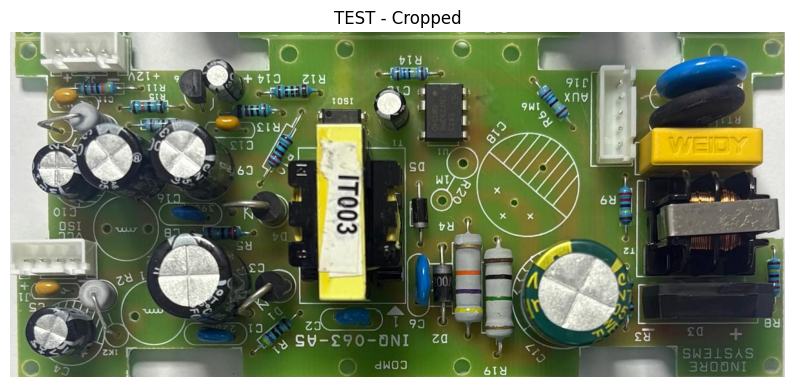

--- Detecting (MASTER) : YOLO -> SAM -> OpenCV ---
YOLO: time=0.10s boxes_before=3 boxes_after_merge=3
SAM: masks_found=16 time=44.41s
OpenCV: added=51 time=0.02s remaining_pixels=523969
Detection (MASTER) completed in 44.54s; total_boxes=66
--- Detecting (TEST) : YOLO -> SAM -> OpenCV ---
YOLO: time=0.02s boxes_before=1 boxes_after_merge=1
SAM: masks_found=20 time=43.99s
OpenCV: added=45 time=0.01s remaining_pixels=466490
Detection (TEST) completed in 44.05s; total_boxes=63
Saved detection JSONs: /content/pcb_output_full/reports/MASTER_detection.json , /content/pcb_output_full/reports/TEST_detection.json
Saved crops: master=66 test=63
Comparing MASTER -> TEST using IoU...
Comparison result: master_total_boxes=66, missing_count=59


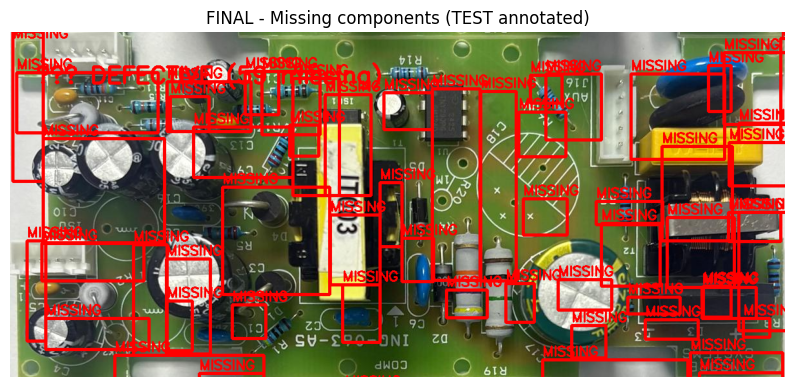

Pipeline complete. Results saved to: /content/pcb_output_full
Stages folder: /content/pcb_output_full/stages
Crops folder: /content/pcb_output_full/crops
Reports folder: /content/pcb_output_full/reports
Final missing image: /content/pcb_output_full/test_missing_only.png

Done ✅ — Check the folders and the JSON report for details.


In [10]:
# ============================
# FULL PIPELINE: Master vs Test
# Auto-crop -> YOLO -> SAM -> OpenCV -> IoU compare -> Crops & Reports
# Run in Google Colab
# ============================

# Install (Colab only; skip if already installed)
!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything || true

# ----------------------------
# Imports
# ----------------------------
import os, time, json, math, importlib
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
import torch
from google.colab import drive

# ----------------------------
# Parameters (tweak as needed)
# ----------------------------
OUT_ROOT = "/content/pcb_output_full"
STAGES_DIR = os.path.join(OUT_ROOT, "stages")
CROPS_DIR = os.path.join(OUT_ROOT, "crops")
REPORTS_DIR = os.path.join(OUT_ROOT, "reports")
os.makedirs(STAGES_DIR, exist_ok=True)
os.makedirs(CROPS_DIR, exist_ok=True)
os.makedirs(REPORTS_DIR, exist_ok=True)

# Detection tuning (conservative by default)
YOLO_CONF = 0.70          # confidence threshold for YOLO
YOLO_IMGSZ = 1280         # inference image size for YOLO
MIN_BOX_AREA = 600        # minimum area for YOLO boxes (px)
MERGE_IOU = 0.50          # merge threshold for YOLO overlapping boxes
SAM_POINTS = 8            # SAM sampling grid (higher = finer)
SAM_MIN_AREA = 1000       # SAM minimum mask area to keep
OPENCV_MIN_AREA = 2000    # OpenCV contour min area to keep
IOU_MATCH_THRESH = 0.40   # IoU threshold to consider Master box matched in Test
IOU_SKIP = 0.30           # if SAM/OpenCV overlaps YOLO above this, skip it
MAX_SIDE = 1400           # resize very large images to this max side (keeps memory stable)

PRINT_PROGRESS = True

# ----------------------------
# Utility functions
# ----------------------------
def log(msg):
    if PRINT_PROGRESS:
        print(msg)

def show_img_bgr(img_bgr, title=None, figsize=(10,6)):
    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB))
    if title: plt.title(title)
    plt.axis('off')
    plt.show()

def clamp_and_resize(img, max_side=MAX_SIDE):
    h,w = img.shape[:2]
    if max(h,w) > max_side:
        scale = max_side / float(max(h,w))
        img = cv2.resize(img, (int(w*scale), int(h*scale)), interpolation=cv2.INTER_AREA)
        return img, scale
    return img, 1.0

# NMS-like merging of boxes (simple greedy merging)
def merge_boxes_nms(boxes, scores=None, iou_thresh=MERGE_IOU):
    if not boxes:
        return []
    boxes = np.array(boxes).astype(float)
    if scores is None:
        scores = np.ones(len(boxes))
    idxs = np.argsort(scores)[::-1]
    keep = []
    while idxs.size:
        i = idxs[0]
        keep.append(boxes[i].astype(int).tolist())
        rest = idxs[1:]
        keep_rest = []
        for j in rest:
            A = boxes[i]; B = boxes[j]
            xA = max(A[0],B[0]); yA = max(A[1],B[1])
            xB = min(A[2],B[2]); yB = min(A[3],B[3])
            interW = max(0,xB-xA); interH = max(0,yB-yA)
            inter = interW * interH
            areaA = max(0,(A[2]-A[0])) * max(0,(A[3]-A[1]))
            areaB = max(0,(B[2]-B[0])) * max(0,(B[3]-B[1]))
            denom = (areaA + areaB - inter + 1e-9)
            iou = inter / denom if denom>0 else 0
            if iou <= iou_thresh:
                keep_rest.append(j)
        idxs = np.array(keep_rest)
    return keep

def iou_box(A,B):
    xA,yA = max(A[0],B[0]), max(A[1],B[1])
    xB,yB = min(A[2],B[2]), min(A[3],B[3])
    interW = max(0, xB-xA); interH = max(0, yB-yA)
    inter = interW * interH
    areaA = max(0,(A[2]-A[0])) * max(0,(A[3]-A[1]))
    areaB = max(0,(B[2]-B[0])) * max(0,(B[3]-B[1]))
    denom = float(areaA + areaB - inter + 1e-9)
    return inter/denom if denom>0 else 0.0

# ----------------------------
# Auto-crop PCB (your color-based warp)
# ----------------------------
def auto_crop_board_color_based(image_bgr):
    img = image_bgr.copy()
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        # fallback to resized full image
        h,w = img.shape[:2]; s = 512/max(h,w)
        return cv2.resize(img, (int(w*s), int(h*s))) if s<1 else img
    c = max(contours, key=cv2.contourArea)
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.02 * peri, True)
    if len(approx) != 4:
        x,y,w,h = cv2.boundingRect(c)
        return img[y:y+h, x:x+w]
    def order_points(pts):
        rect = np.zeros((4,2), dtype="float32")
        s = pts.sum(axis=1)
        rect[0] = pts[np.argmin(s)]; rect[2] = pts[np.argmax(s)]
        diff = np.diff(pts, axis=1)
        rect[1] = pts[np.argmin(diff)]; rect[3] = pts[np.argmax(diff)]
        return rect
    rect = order_points(approx.reshape(4,2))
    (tl,tr,br,bl) = rect
    widthA = np.linalg.norm(br-bl); widthB = np.linalg.norm(tr-tl)
    heightA = np.linalg.norm(tr-br); heightB = np.linalg.norm(tl-bl)
    maxWidth = int(max(widthA, widthB)); maxHeight = int(max(heightA, heightB))
    dst = np.array([[0,0],[maxWidth-1,0],[maxWidth-1,maxHeight-1],[0,maxHeight-1]], dtype="float32")
    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(img, M, (maxWidth, maxHeight))
    return warped

# ----------------------------
# Mount Drive (to find YOLO model if in Drive)
# ----------------------------
log("Mounting Google Drive (optional) ...")
try:
    drive.mount('/content/drive', force_remount=True)
    log("Drive mounted.")
except Exception as e:
    log("Drive mount skipped or failed: " + str(e))

# ----------------------------
# Find YOLO model (Drive -> local -> fallback)
# ----------------------------
log("Searching for YOLO model (best.pt) in Drive and local dirs...")
MODEL_PATH = None
drive_search = "/content/drive/My Drive/YOLO"
if os.path.exists(drive_search):
    for root, dirs, files in os.walk(drive_search):
        for fn in files:
            if fn == "best.pt":
                MODEL_PATH = os.path.join(root, fn); break
        if MODEL_PATH: break

if MODEL_PATH is None and os.path.exists("best.pt"):
    MODEL_PATH = "best.pt"

if MODEL_PATH is None:
    log("No user-trained best.pt found; defaulting to ultralytics 'yolov8n.pt' (will be downloaded).")
    MODEL_PATH = "yolov8n.pt"

log(f"Using YOLO model path: {MODEL_PATH}")
yolo = YOLO(MODEL_PATH)
device = "cuda" if torch.cuda.is_available() else "cpu"
log(f"YOLO loaded. Device: {device}")

# ----------------------------
# Load SAM (Segment Anything) ViT-B (accurate, heavier)
# Provide fallback: if it fails, pipeline continues without SAM.
# ----------------------------
use_sam = False
mask_generator = None
try:
    from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
    sam_ckpt = "/content/sam_vit_b_01ec64.pth"
    if not os.path.exists(sam_ckpt):
        log("Downloading SAM ViT-B checkpoint (~360MB). This can take a while...")
        !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}
    sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
    mask_generator = SamAutomaticMaskGenerator(
        sam,
        points_per_side=SAM_POINTS,
        pred_iou_thresh=0.9,
        stability_score_thresh=0.95,
        crop_n_layers=0,
        min_mask_region_area=SAM_MIN_AREA
    )
    use_sam = True
    log("SAM ViT-B loaded successfully.")
except Exception as e:
    log("SAM failed to load (will skip SAM). Error: " + str(e))
    use_sam = False

# ----------------------------
# Upload MASTER and TEST images (Colab)
# ----------------------------
files_mod = importlib.import_module("google.colab.files")
print("Please upload two images: MASTER first, then TEST.")
uploaded = files_mod.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Upload two images (MASTER then TEST).")
master_name, test_name = keys[0], keys[1]
log(f"Uploaded: MASTER={master_name}, TEST={test_name}")

master_bgr = cv2.imdecode(np.frombuffer(uploaded[master_name], np.uint8), cv2.IMREAD_COLOR)
test_bgr   = cv2.imdecode(np.frombuffer(uploaded[test_name], np.uint8), np.uint8) if False else cv2.imdecode(np.frombuffer(uploaded[test_name], np.uint8), cv2.IMREAD_COLOR)

if master_bgr is None or test_bgr is None:
    raise ValueError("Failed to decode uploaded images.")

# ----------------------------
# Auto-crop MASTER and TEST
# ----------------------------
log("Auto-cropping MASTER and TEST PCBs (color-based)...")
master_crop = auto_crop_board_color_based(master_bgr)
test_crop   = auto_crop_board_color_based(test_bgr)
# Clamp size to avoid OOM
master_crop, s_master = clamp_and_resize(master_crop, MAX_SIDE)
test_crop, s_test = clamp_and_resize(test_crop, MAX_SIDE)
log(f"MASTER crop shape: {master_crop.shape}, scale: {s_master}")
log(f"TEST  crop shape: {test_crop.shape}, scale: {s_test}")
show_img_bgr(master_crop, title="MASTER - Cropped")
show_img_bgr(test_crop, title="TEST - Cropped")

# ----------------------------
# Detection function for a single image: runs YOLO -> SAM (on uncovered) -> OpenCV backup
# Returns per-source boxes and visualizations
# ----------------------------
def detect_full_pipeline(img_bgr, name="IMG"):
    log(f"--- Detecting ({name}) : YOLO -> SAM -> OpenCV ---")
    t0_total = time.time()
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    # YOLO
    t0 = time.time()
    results = yolo.predict(source=img_rgb, conf=YOLO_CONF, device=device, imgsz=YOLO_IMGSZ, verbose=False)
    t1 = time.time()
    yolo_boxes = []
    yolo_scores = []
    if len(results) > 0:
        r = results[0]
        if hasattr(r, "boxes") and len(r.boxes):
            xy = r.boxes.xyxy.cpu().numpy()
            confs = r.boxes.conf.cpu().numpy()
            for i, (x1,y1,x2,y2) in enumerate(xy):
                score = float(confs[i])
                if score >= YOLO_CONF:
                    area = max(0, int(round(x2-x1))) * max(0, int(round(y2-y1)))
                    if area >= MIN_BOX_AREA:
                        yolo_boxes.append((int(round(x1)),int(round(y1)),int(round(x2)),int(round(y2))))
                        yolo_scores.append(score)
    # merge YOLO overlapping boxes
    merged_yolo = merge_boxes_nms(yolo_boxes, yolo_scores, iou_thresh=MERGE_IOU)
    log(f"YOLO: time={t1-t0:.2f}s boxes_before={len(yolo_boxes)} boxes_after_merge={len(merged_yolo)}")

    vis_yolo = img_bgr.copy()
    for (x1,y1,x2,y2) in merged_yolo:
        cv2.rectangle(vis_yolo, (x1,y1),(x2,y2), (0,255,0), 2)

    # Create mask of YOLO-covered regions
    mask_yolo = np.zeros(img_bgr.shape[:2], dtype=np.uint8)
    for (x1,y1,x2,y2) in merged_yolo:
        cv2.rectangle(mask_yolo, (x1,y1),(x2,y2), 255, -1)

    # SAM on uncovered (if available)
    sam_boxes = []
    if use_sam and mask_generator is not None:
        inv_mask = cv2.bitwise_not(mask_yolo)
        uncovered_rgb = cv2.bitwise_and(img_rgb, img_rgb, mask=inv_mask)
        t0 = time.time()
        try:
            sam_masks = mask_generator.generate(uncovered_rgb)
        except Exception as e:
            log("SAM.generate failed: " + str(e))
            sam_masks = []
        t1 = time.time()
        log(f"SAM: masks_found={len(sam_masks)} time={t1-t0:.2f}s")
        for m in sam_masks:
            seg = m["segmentation"].astype("uint8")
            x,y,w,h = cv2.boundingRect(seg)
            if w*h < SAM_MIN_AREA:
                continue
            # If overlaps YOLO strongly, skip
            skip = False
            for b in merged_yolo:
                if iou_box((x,y,x+w,y+h), b) > IOU_SKIP:
                    skip = True; break
            if not skip:
                sam_boxes.append((x,y,x+w,y+h))
    else:
        log("SAM skipped for this run.")

    vis_sam = img_bgr.copy()
    for (x1,y1,x2,y2) in sam_boxes:
        cv2.rectangle(vis_sam, (x1,y1),(x2,y2), (255,0,0), 2)

    # OpenCV backup on remaining uncovered
    mask_all = np.zeros(img_bgr.shape[:2], dtype=np.uint8)
    for b in merged_yolo + sam_boxes:
        cv2.rectangle(mask_all, (b[0],b[1]), (b[2],b[3]), 255, -1)
    remain_mask = cv2.bitwise_not(mask_all)
    remain_pixels = np.count_nonzero(remain_mask)
    opencv_boxes = []
    t0 = time.time()
    if remain_pixels > 1000:
        gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
        edges = cv2.Canny(gray, 70, 160)
        edges = cv2.bitwise_and(edges, edges, mask=remain_mask)
        contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        for c in contours:
            x,y,w,h = cv2.boundingRect(c)
            if w*h < OPENCV_MIN_AREA:
                continue
            # skip if overlaps existing boxes
            skip = False
            for b in merged_yolo + sam_boxes:
                if iou_box((x,y,x+w,y+h), b) > IOU_SKIP:
                    skip = True; break
            if not skip:
                opencv_boxes.append((x,y,x+w,y+h))
    t1 = time.time()
    log(f"OpenCV: added={len(opencv_boxes)} time={t1-t0:.2f}s remaining_pixels={remain_pixels}")

    vis_cv = img_bgr.copy()
    for (x1,y1,x2,y2) in opencv_boxes:
        cv2.rectangle(vis_cv, (x1,y1),(x2,y2), (255,255,0), 1)

    # final combined boxes and per-source dict
    final_boxes = []
    sources = []
    for b in merged_yolo:
        final_boxes.append(b); sources.append("yolo")
    for b in sam_boxes:
        final_boxes.append(b); sources.append("sam")
    for b in opencv_boxes:
        final_boxes.append(b); sources.append("opencv")
    t_end = time.time()
    log(f"Detection ({name}) completed in {t_end - t0_total:.2f}s; total_boxes={len(final_boxes)}")
    # Save stage visualizations
    cv2.imwrite(os.path.join(STAGES_DIR, f"{name}_stage_yolo.png"), vis_yolo)
    cv2.imwrite(os.path.join(STAGES_DIR, f"{name}_stage_sam.png"), vis_sam)
    cv2.imwrite(os.path.join(STAGES_DIR, f"{name}_stage_opencv.png"), vis_cv)
    # Return
    per_source = {"yolo": merged_yolo, "sam": sam_boxes, "opencv": opencv_boxes}
    visuals = {"yolo": vis_yolo, "sam": vis_sam, "opencv": vis_cv}
    return final_boxes, sources, per_source, visuals

# ----------------------------
# Run detection on MASTER and TEST
# ----------------------------
master_all_boxes, master_sources, master_per_src, master_visuals = detect_full_pipeline(master_crop, name="MASTER")
test_all_boxes,   test_sources,   test_per_src,   test_visuals   = detect_full_pipeline(test_crop, name="TEST")

# ----------------------------
# Save detection JSONs & per-source visuals
# ----------------------------
def save_detection_json(name, per_src):
    out = {"yolo": [], "sam": [], "opencv": []}
    for src in ["yolo","sam","opencv"]:
        for idx,b in enumerate(per_src[src]):
            x1,y1,x2,y2 = map(int,b)
            out[src].append({"id": f"{name}_{src}_{idx+1}", "box": [x1,y1,x2,y2]})
    path = os.path.join(REPORTS_DIR, f"{name}_detection.json")
    with open(path, "w") as f:
        json.dump(out, f, indent=2)
    return path

master_json_path = save_detection_json("MASTER", master_per_src)
test_json_path   = save_detection_json("TEST", test_per_src)
log("Saved detection JSONs: " + master_json_path + " , " + test_json_path)

# ----------------------------
# Crop all detected components into folders
# ----------------------------
def save_crops_from_per_source(img_bgr, per_src, prefix):
    saved = []
    for src, boxes in per_src.items():
        out_dir = os.path.join(CROPS_DIR, prefix, src)
        os.makedirs(out_dir, exist_ok=True)
        for i,b in enumerate(boxes):
            x1,y1,x2,y2 = map(int,b)
            x1 = max(0,x1); y1 = max(0,y1); x2 = min(img_bgr.shape[1], x2); y2 = min(img_bgr.shape[0], y2)
            if x2 <= x1 or y2 <= y1: continue
            crop = img_bgr[y1:y2, x1:x2]
            fname = os.path.join(out_dir, f"{prefix}_{src}_crop_{i+1}.png")
            cv2.imwrite(fname, crop)
            saved.append(fname)
    return saved

master_crops = save_crops_from_per_source(master_crop, master_per_src, "MASTER")
test_crops   = save_crops_from_per_source(test_crop, test_per_src, "TEST")
log(f"Saved crops: master={len(master_crops)} test={len(test_crops)}")

# ----------------------------
# Compare MASTER -> TEST using IoU (geometric). Only missing marked.
# For each MASTER box, see if any TEST box has IoU >= IOU_MATCH_THRESH. If not, mark missing.
# ----------------------------
log("Comparing MASTER -> TEST using IoU...")
missing = []
for mb in master_per_src["yolo"] + master_per_src["sam"] + master_per_src["opencv"]:
    matched = False
    for tb in test_per_src["yolo"] + test_per_src["sam"] + test_per_src["opencv"]:
        if iou_box(mb, tb) >= IOU_MATCH_THRESH:
            matched = True
            break
    if not matched:
        missing.append(mb)

log(f"Comparison result: master_total_boxes={len(master_per_src['yolo'])+len(master_per_src['sam'])+len(master_per_src['opencv'])}, missing_count={len(missing)}")

# ----------------------------
# Create final image that ONLY highlights missing components in RED on the TEST image
# ----------------------------
final_missing_img = test_crop.copy()
if len(missing) == 0:
    cv2.putText(final_missing_img, "✅ GOOD BOARD", (40,80), cv2.FONT_HERSHEY_SIMPLEX, 1.6, (0,255,0), 4)
else:
    for (x1,y1,x2,y2) in missing:
        cv2.rectangle(final_missing_img, (int(x1),int(y1)), (int(x2),int(y2)), (0,0,255), 4)
        cv2.putText(final_missing_img, "MISSING", (int(x1), max(10,int(y1)-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
    cv2.putText(final_missing_img, f"❌ DEFECTIVE ({len(missing)} missing)", (40,80), cv2.FONT_HERSHEY_SIMPLEX, 1.2, (0,0,255), 4)

# Save final missing-only image
final_missing_path = os.path.join(OUT_ROOT, "test_missing_only.png")
cv2.imwrite(final_missing_path, final_missing_img)
show_img_bgr(final_missing_img, title="FINAL - Missing components (TEST annotated)")

# ----------------------------
# Save comparison report JSON
# ----------------------------
report = {
    "master_counts": {k: len(v) for k,v in master_per_src.items()},
    "test_counts":   {k: len(v) for k,v in test_per_src.items()},
    "missing_count": len(missing),
    "missing_boxes": [{"x1":int(b[0]), "y1":int(b[1]), "x2":int(b[2]), "y2":int(b[3])} for b in missing],
    "master_detection_json": master_json_path,
    "test_detection_json": test_json_path,
    "master_crops_folder": os.path.join(CROPS_DIR, "MASTER"),
    "test_crops_folder": os.path.join(CROPS_DIR, "TEST"),
    "final_missing_image": final_missing_path
}
report_path = os.path.join(REPORTS_DIR, "comparison_report.json")
with open(report_path, "w") as f:
    json.dump(report, f, indent=2)

log("Pipeline complete. Results saved to: " + OUT_ROOT)
log("Stages folder: " + STAGES_DIR)
log("Crops folder: " + CROPS_DIR)
log("Reports folder: " + REPORTS_DIR)
log("Final missing image: " + final_missing_path)
print("\nDone ✅ — Check the folders and the JSON report for details.")


Mounted at /content/drive
✅ Google Drive mounted successfully!
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📸 Upload your MASTER and TEST PCB images:


Saving tesssttt.jpeg to tesssttt (5).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (5).jpeg
✅ MASTER: tesssttt (5).jpeg
✅ TEST: Masterrrrrr (5).jpeg
✅ Both images cropped successfully!


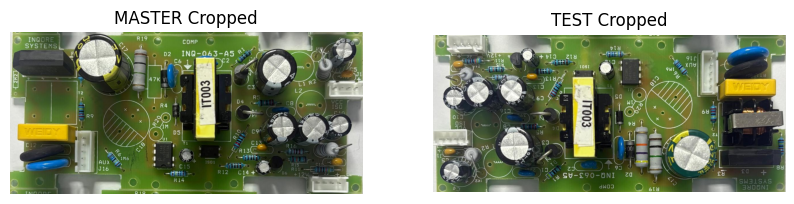

🔵 Loading SAM model (ViT-B)...
✅ SAM ready!

🔍 Detecting components in MASTER...
✅ MASTER: YOLO=2 SAM=11 OpenCV=67

🔍 Detecting components in TEST...
✅ TEST: YOLO=3 SAM=15 OpenCV=64


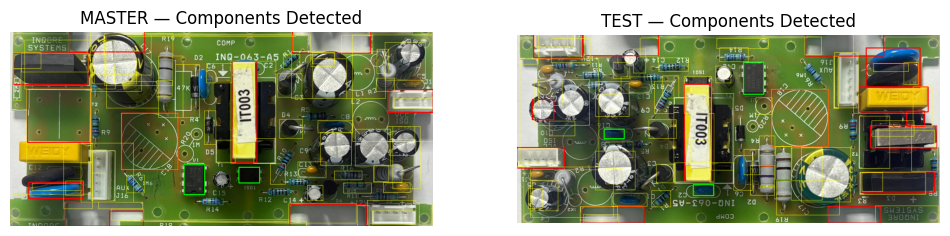

💾 Results saved in: /content/pcb_output_clean


In [11]:
# ==============================================================
# 🧠 PCB COMPONENT DETECTION — Clean YOLO + SAM + OpenCV
# Works separately on MASTER and TEST images (no comparison yet)
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ==============================================================
# 🧩 Imports
# ==============================================================
import os, cv2, numpy as np, matplotlib.pyplot as plt, time
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output_clean"
os.makedirs(OUT_DIR, exist_ok=True)

CROP_DIR = f"{OUT_DIR}/crops"
os.makedirs(CROP_DIR, exist_ok=True)

drive.mount('/content/drive', force_remount=True)
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Load YOLO model (auto-find latest best.pt in Drive)
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found_models = []

for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            found_models.append(os.path.join(root, f))

if not found_models:
    raise FileNotFoundError("❌ No YOLO best.pt found in your Drive!")

MODEL_PATH = sorted(found_models, key=os.path.getmtime, reverse=True)[0]
print(f"✅ Using YOLO model: {MODEL_PATH}")

model = YOLO(MODEL_PATH)

# ==============================================================
# 🧩 Auto-Cropping Function (Color-based perspective)
# ==============================================================
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)

    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        print("⚠️ No PCB region found, returning original.")
        return image

    c = max(contours, key=cv2.contourArea)
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.02 * peri, True)

    if len(approx) != 4:
        x, y, w, h = cv2.boundingRect(c)
        return image[y:y+h, x:x+w]

    def order_points(pts):
        rect = np.zeros((4, 2), dtype="float32")
        s = pts.sum(axis=1)
        rect[0] = pts[np.argmin(s)]
        rect[2] = pts[np.argmax(s)]
        diff = np.diff(pts, axis=1)
        rect[1] = pts[np.argmin(diff)]
        rect[3] = pts[np.argmax(diff)]
        return rect

    rect = order_points(approx.reshape(4,2))
    (tl, tr, br, bl) = rect
    widthA = np.linalg.norm(br - bl)
    widthB = np.linalg.norm(tr - tl)
    heightA = np.linalg.norm(tr - br)
    heightB = np.linalg.norm(tl - bl)
    maxWidth = int(max(widthA, widthB))
    maxHeight = int(max(heightA, heightB))

    dst = np.array([
        [0, 0],
        [maxWidth-1, 0],
        [maxWidth-1, maxHeight-1],
        [0, maxHeight-1]
    ], dtype="float32")

    M = cv2.getPerspectiveTransform(rect, dst)
    return cv2.warpPerspective(image, M, (maxWidth, maxHeight))

# ==============================================================
# 📤 Upload MASTER and TEST images
# ==============================================================
print("📸 Upload your MASTER and TEST PCB images:")
uploaded = files.upload()
paths = list(uploaded.keys())

if len(paths) < 2:
    raise ValueError("❌ Please upload both MASTER and TEST PCB images.")

master_path, test_path = paths[0], paths[1]
print(f"✅ MASTER: {master_path}")
print(f"✅ TEST: {test_path}")

master_img = cv2.imread(master_path)
test_img = cv2.imread(test_path)

# ==============================================================
# 🧩 Auto-Crop both images cleanly
# ==============================================================
master_crop = auto_crop_board_color_based(master_img)
test_crop   = auto_crop_board_color_based(test_img)

print("✅ Both images cropped successfully!")
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(cv2.cvtColor(master_crop, cv2.COLOR_BGR2RGB))
plt.title("MASTER Cropped")
plt.axis("off")
plt.subplot(1,2,2)
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.title("TEST Cropped")
plt.axis("off")
plt.show()

# ==============================================================
# 🔵 Load SAM (Segment Anything)
# ==============================================================
print("🔵 Loading SAM model (ViT-B)...")
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth

sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
mask_generator = SamAutomaticMaskGenerator(
    sam,
    points_per_side=8,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=0,
    min_mask_region_area=1200
)
print("✅ SAM ready!")

# ==============================================================
# 🔍 Detection Function
# ==============================================================
def detect_components(image_rgb, name="PCB"):
    print(f"\n🔍 Detecting components in {name}...")
    yolo_results = model.predict(source=image_rgb, conf=0.7, verbose=False)
    yolo_boxes = []

    for result in yolo_results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0].cpu().numpy())
            conf = float(box.conf)
            cls = int(box.cls)
            label = result.names[cls]
            if conf > 0.7:
                yolo_boxes.append((x1, y1, x2, y2, label))

    mask_yolo = np.zeros(image_rgb.shape[:2], dtype=np.uint8)
    for (x1, y1, x2, y2, _) in yolo_boxes:
        cv2.rectangle(mask_yolo, (x1, y1), (x2, y2), 255, -1)

    # SAM on uncovered areas
    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(image_rgb, image_rgb, mask=inverse_mask)
    masks = mask_generator.generate(uncovered)

    sam_boxes = []
    for m in masks:
        seg = m["segmentation"].astype('uint8')
        x, y, w, h = cv2.boundingRect(seg)
        overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
        if not overlap and w*h > 1200:
            sam_boxes.append((x, y, x+w, y+h))

    # OpenCV edge detection backup
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 70, 160)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    opencv_boxes = []
    for c in contours:
        x, y, w, h = cv2.boundingRect(c)
        overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
        if w*h > 2000 and not overlap:
            opencv_boxes.append((x, y, x+w, y+h))

    # Combine
    final = image_rgb.copy()
    for (x1, y1, x2, y2, _) in yolo_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (0,255,0), 2)
    for (x1, y1, x2, y2) in sam_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (255,0,0), 2)
    for (x1, y1, x2, y2) in opencv_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (255,255,0), 1)

    print(f"✅ {name}: YOLO={len(yolo_boxes)} SAM={len(sam_boxes)} OpenCV={len(opencv_boxes)}")
    return final, yolo_boxes, sam_boxes, opencv_boxes

# ==============================================================
# 🧠 Run Detection on Both Boards
# ==============================================================
master_detected, master_yolo, master_sam, master_cv = detect_components(cv2.cvtColor(master_crop, cv2.COLOR_BGR2RGB), "MASTER")
test_detected,   test_yolo,   test_sam,   test_cv   = detect_components(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB), "TEST")

# ==============================================================
# 💾 Save & Visualize
# ==============================================================
cv2.imwrite(f"{OUT_DIR}/master_detected.png", cv2.cvtColor(master_detected, cv2.COLOR_RGB2BGR))
cv2.imwrite(f"{OUT_DIR}/test_detected.png", cv2.cvtColor(test_detected, cv2.COLOR_RGB2BGR))

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.imshow(master_detected)
plt.title("MASTER — Components Detected")
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(test_detected)
plt.title("TEST — Components Detected")
plt.axis('off')
plt.show()

print("💾 Results saved in:", OUT_DIR)


Mounted at /content/drive
✅ Google Drive mounted successfully!
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📸 Upload your MASTER and TEST PCB images:


Saving tesssttt.jpeg to tesssttt (7).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (7).jpeg
✅ Loaded MASTER: tesssttt (7).jpeg
✅ Loaded TEST:   Masterrrrrr (7).jpeg


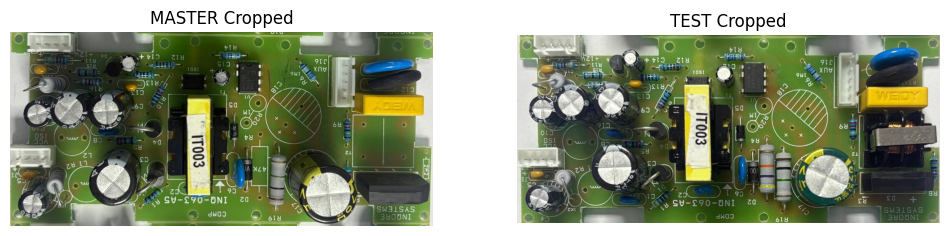

🔵 Loading SAM model...
✅ SAM ready!

🔍 Running detection on MASTER...
🟩 YOLO detected 3 components.
🔵 SAM added 14 boxes.
🟠 OpenCV refined detection → 6 components.
✅ Final MASTER: YOLO=3, SAM=14, OpenCV=6

🔍 Running detection on TEST...
🟩 YOLO detected 3 components.
🔵 SAM added 15 boxes.
🟠 OpenCV refined detection → 6 components.
✅ Final TEST: YOLO=3, SAM=15, OpenCV=6


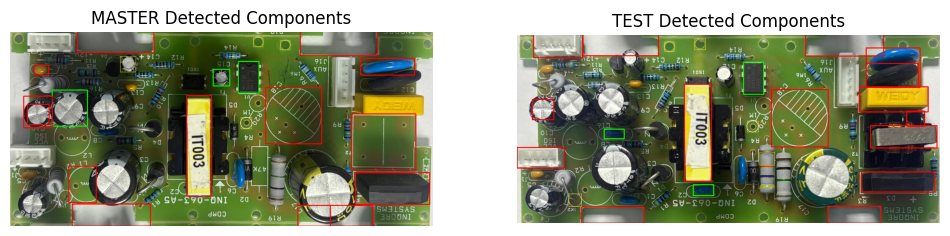

💾 Saved clean detection results at: /content/pcb_output_clean


In [13]:
# ==============================================================
# 🧠 PCB COMPONENT DETECTION — Clean YOLO + SAM + Smart OpenCV
# Works on both MASTER and TEST images (no comparison yet)
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ==============================================================
# 🧩 Imports
# ==============================================================
import os, cv2, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output_clean"
CROP_DIR = f"{OUT_DIR}/crops"
os.makedirs(CROP_DIR, exist_ok=True)

drive.mount('/content/drive', force_remount=True)
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Load YOLO model
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found_models = []

for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            found_models.append(os.path.join(root, f))

if not found_models:
    raise FileNotFoundError("❌ No YOLO model found in Drive.")

MODEL_PATH = sorted(found_models, key=os.path.getmtime, reverse=True)[0]
print(f"✅ Using YOLO model: {MODEL_PATH}")

model = YOLO(MODEL_PATH)

# ==============================================================
# 🧩 Color-Based Cropping
# ==============================================================
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7, 7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)

    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        print("⚠️ No PCB region found. Returning original image.")
        return image

    c = max(contours, key=cv2.contourArea)
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.02 * peri, True)

    if len(approx) != 4:
        x, y, w, h = cv2.boundingRect(c)
        return image[y:y + h, x:x + w]

    def order_points(pts):
        rect = np.zeros((4, 2), dtype="float32")
        s = pts.sum(axis=1)
        rect[0] = pts[np.argmin(s)]
        rect[2] = pts[np.argmax(s)]
        diff = np.diff(pts, axis=1)
        rect[1] = pts[np.argmin(diff)]
        rect[3] = pts[np.argmax(diff)]
        return rect

    rect = order_points(approx.reshape(4, 2))
    (tl, tr, br, bl) = rect

    widthA = np.linalg.norm(br - bl)
    widthB = np.linalg.norm(tr - tl)
    heightA = np.linalg.norm(tr - br)
    heightB = np.linalg.norm(tl - bl)
    maxWidth = int(max(widthA, widthB))
    maxHeight = int(max(heightA, heightB))

    dst = np.array([
        [0, 0],
        [maxWidth - 1, 0],
        [maxWidth - 1, maxHeight - 1],
        [0, maxHeight - 1]
    ], dtype="float32")

    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(image, M, (maxWidth, maxHeight))
    return warped

# ==============================================================
# 📤 Upload MASTER & TEST Images
# ==============================================================
print("📸 Upload your MASTER and TEST PCB images:")
uploaded = files.upload()
paths = list(uploaded.keys())
if len(paths) < 2:
    raise ValueError("❌ Upload both MASTER and TEST PCB images.")

master_img = cv2.imread(paths[0])
test_img   = cv2.imread(paths[1])
print(f"✅ Loaded MASTER: {paths[0]}")
print(f"✅ Loaded TEST:   {paths[1]}")

# ==============================================================
# ✂️ Auto-Crop Both Boards
# ==============================================================
master_crop = auto_crop_board_color_based(master_img)
test_crop   = auto_crop_board_color_based(test_img)

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.imshow(cv2.cvtColor(master_crop, cv2.COLOR_BGR2RGB))
plt.title("MASTER Cropped")
plt.axis("off")
plt.subplot(1,2,2)
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.title("TEST Cropped")
plt.axis("off")
plt.show()

# ==============================================================
# 🔵 Load SAM (Segment Anything)
# ==============================================================
print("🔵 Loading SAM model...")
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth

sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
mask_generator = SamAutomaticMaskGenerator(
    sam,
    points_per_side=8,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=0,
    min_mask_region_area=1200
)
print("✅ SAM ready!")

# ==============================================================
# 🟠 Smart OpenCV Component Detector
# ==============================================================
def detect_opencv_components(image_rgb, mask_yolo=None):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 70, 160)
    if mask_yolo is not None:
        edges = cv2.bitwise_and(edges, edges, mask=cv2.bitwise_not(mask_yolo))

    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    component_boxes = []

    for c in contours:
        x, y, w, h = cv2.boundingRect(c)
        area = w * h
        if area < 600 or area > 20000:  # size filter
            continue

        aspect_ratio = w / float(h)
        if aspect_ratio < 0.4 or aspect_ratio > 3.0:  # shape filter
            continue

        rect_area = w * h
        contour_area = cv2.contourArea(c)
        rectangularity = contour_area / rect_area
        if rectangularity < 0.6:  # irregular shapes
            continue

        roi = gray[y:y+h, x:x+w]
        if roi.size == 0: continue
        if np.std(roi) < 25:  # too flat (low texture)
            continue

        mean_intensity = np.mean(roi)
        if mean_intensity > 230:  # silkscreen labels or bright areas
            continue

        component_boxes.append((x, y, x+w, y+h))

    print(f"🟠 OpenCV refined detection → {len(component_boxes)} components.")
    return component_boxes

# ==============================================================
# 🔍 Detection Function (YOLO + SAM + Smart OpenCV)
# ==============================================================
def detect_components(image_bgr, name="PCB"):
    print(f"\n🔍 Running detection on {name}...")
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    # 1️⃣ YOLO Detection
    yolo_results = model.predict(source=image_rgb, conf=0.7, verbose=False)
    yolo_boxes = []
    for result in yolo_results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0].cpu().numpy())
            conf = float(box.conf)
            cls = int(box.cls)
            label = result.names[cls]
            if conf > 0.7:
                yolo_boxes.append((x1, y1, x2, y2, label))

    print(f"🟩 YOLO detected {len(yolo_boxes)} components.")

    # 2️⃣ SAM Segmentation on uncovered
    mask_yolo = np.zeros(image_rgb.shape[:2], dtype=np.uint8)
    for (x1, y1, x2, y2, _) in yolo_boxes:
        cv2.rectangle(mask_yolo, (x1, y1), (x2, y2), 255, -1)

    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(image_rgb, image_rgb, mask=inverse_mask)
    sam_boxes = []
    try:
        masks = mask_generator.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x, y, w, h = cv2.boundingRect(seg)
            overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
            if not overlap and w*h > 1200:
                sam_boxes.append((x, y, x+w, y+h))
    except Exception as e:
        print("SAM failed:", e)
    print(f"🔵 SAM added {len(sam_boxes)} boxes.")

    # 3️⃣ Smart OpenCV backup
    opencv_boxes = detect_opencv_components(image_rgb, mask_yolo)

    # 4️⃣ Combine & visualize
    final = image_rgb.copy()
    for (x1, y1, x2, y2, _) in yolo_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (0,255,0), 2)
    for (x1, y1, x2, y2) in sam_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (255,0,0), 2)
    for (x1, y1, x2, y2) in opencv_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (255,255,0), 1)

    print(f"✅ Final {name}: YOLO={len(yolo_boxes)}, SAM={len(sam_boxes)}, OpenCV={len(opencv_boxes)}")
    return final, yolo_boxes, sam_boxes, opencv_boxes

# ==============================================================
# 🚀 Run Detection
# ==============================================================
master_detected, master_yolo, master_sam, master_cv = detect_components(master_crop, "MASTER")
test_detected, test_yolo, test_sam, test_cv = detect_components(test_crop, "TEST")

# ==============================================================
# 💾 Save Outputs
# ==============================================================
cv2.imwrite(f"{OUT_DIR}/master_detected.png", cv2.cvtColor(master_detected, cv2.COLOR_RGB2BGR))
cv2.imwrite(f"{OUT_DIR}/test_detected.png", cv2.cvtColor(test_detected, cv2.COLOR_RGB2BGR))

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.imshow(master_detected)
plt.title("MASTER Detected Components")
plt.axis("off")
plt.subplot(1,2,2)
plt.imshow(test_detected)
plt.title("TEST Detected Components")
plt.axis("off")
plt.show()

print("💾 Saved clean detection results at:", OUT_DIR)


Mounted at /content/drive
✅ Google Drive mounted successfully!
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📸 Upload MASTER and TEST PCB images:


Saving tesssttt.jpeg to tesssttt (8).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (8).jpeg
✅ Both images cropped!
🔵 Loading SAM model...
✅ SAM loaded!

0: 320x640 2 ICss, 12 capacitorss, 1 resistors, 8.3ms
Speed: 2.4ms preprocess, 8.3ms inference, 1.4ms postprocess per image at shape (1, 3, 320, 640)

0: 288x640 1 ICs, 12 capacitorss, 1 diodes, 10.3ms
Speed: 2.2ms preprocess, 10.3ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 640)
✅ Detection complete → 15 master, 14 test


/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


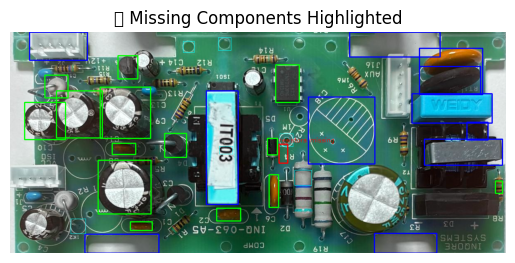


🟥 Missing components visual saved: /content/pcb_output_final/missing_components.png
📊 JSON differences saved: /content/pcb_output_final/differences.json


In [14]:
# ==============================================================
# 🧠 PCB COMPONENT DETECTION + COMPARISON
# YOLOv8 + SAM + Smart OpenCV | JSON-based diff | Missing highlight only
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ==============================================================
# 🧩 Imports
# ==============================================================
import os, cv2, json, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output_final"
os.makedirs(OUT_DIR, exist_ok=True)

drive.mount('/content/drive', force_remount=True)
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Load YOLO model
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found_models = []
for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            found_models.append(os.path.join(root, f))

if not found_models:
    raise FileNotFoundError("❌ No YOLO model found in Drive.")
MODEL_PATH = sorted(found_models, key=os.path.getmtime, reverse=True)[0]
print(f"✅ Using YOLO model: {MODEL_PATH}")
model = YOLO(MODEL_PATH)

# ==============================================================
# ✂️ Cropping Function
# ==============================================================
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ==============================================================
# 📤 Upload MASTER & TEST Images
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
paths = list(uploaded.keys())
if len(paths) < 2:
    raise ValueError("❌ Please upload both MASTER and TEST images.")
master_img = cv2.imread(paths[0])
test_img = cv2.imread(paths[1])

master_crop = auto_crop_board_color_based(master_img)
test_crop   = auto_crop_board_color_based(test_img)
print("✅ Both images cropped!")

# ==============================================================
# 🔵 Load SAM
# ==============================================================
print("🔵 Loading SAM model...")
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth
sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
mask_generator = SamAutomaticMaskGenerator(
    sam,
    points_per_side=8,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=0,
    min_mask_region_area=1200
)
print("✅ SAM loaded!")

# ==============================================================
# 🟠 Smart OpenCV Detector
# ==============================================================
def detect_opencv_components(image_rgb, mask_yolo=None):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 70, 160)
    if mask_yolo is not None:
        edges = cv2.bitwise_and(edges, edges, mask=cv2.bitwise_not(mask_yolo))
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boxes = []
    for c in contours:
        x,y,w,h = cv2.boundingRect(c)
        area = w*h
        if area < 600 or area > 20000: continue
        ar = w/float(h)
        if ar < 0.4 or ar > 3.0: continue
        rect_area = w*h
        contour_area = cv2.contourArea(c)
        if contour_area/rect_area < 0.6: continue
        roi = gray[y:y+h, x:x+w]
        if roi.size==0 or np.std(roi)<25 or np.mean(roi)>230:
            continue
        boxes.append((x,y,x+w,y+h))
    return boxes

# ==============================================================
# 🔍 Detection Function (YOLO + SAM + Smart OpenCV)
# ==============================================================
def detect_components(image_bgr, prefix="PCB"):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    results = model(image_rgb)
    annotated = results[0].plot()
    yolo_boxes = []
    for i, box in enumerate(results[0].boxes):
        cls_id = int(box.cls)
        label = results[0].names[cls_id]
        x1,y1,x2,y2 = box.xyxy[0].cpu().numpy()
        yolo_boxes.append((int(x1), int(y1), int(x2), int(y2), label))

    mask_yolo = np.zeros(image_rgb.shape[:2], dtype=np.uint8)
    for (x1,y1,x2,y2,_) in yolo_boxes:
        cv2.rectangle(mask_yolo,(x1,y1),(x2,y2),255,-1)

    uncovered = cv2.bitwise_and(image_rgb,image_rgb,mask=cv2.bitwise_not(mask_yolo))
    sam_boxes=[]
    try:
        masks = mask_generator.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,w,h = cv2.boundingRect(seg)
            if not np.any(mask_yolo[y:y+h,x:x+w]>0) and w*h>1200:
                sam_boxes.append((x,y,x+w,y+h))
    except: pass

    opencv_boxes = detect_opencv_components(image_rgb, mask_yolo)

    final = image_rgb.copy()
    for (x1,y1,x2,y2,_) in yolo_boxes:
        cv2.rectangle(final,(x1,y1),(x2,y2),(0,255,0),2)
    for (x1,y1,x2,y2) in sam_boxes:
        cv2.rectangle(final,(x1,y1),(x2,y2),(255,0,0),2)
    for (x1,y1,x2,y2) in opencv_boxes:
        cv2.rectangle(final,(x1,y1),(x2,y2),(255,255,0),1)

    comps = [{"label": label, "position": [x1, y1, x2-x1, y2-y1]} for (x1,y1,x2,y2,label) in yolo_boxes]
    return final, comps

# ==============================================================
# 🚀 Run Detection on MASTER & TEST
# ==============================================================
master_detected, master_comps = detect_components(master_crop, "M")
test_detected, test_comps = detect_components(test_crop, "T")

cv2.imwrite(f"{OUT_DIR}/master_detected.png", master_detected)
cv2.imwrite(f"{OUT_DIR}/test_detected.png", test_detected)

master_json = {"components": master_comps}
test_json   = {"components": test_comps}
with open(f"{OUT_DIR}/master.json","w") as f: json.dump(master_json,f,indent=2)
with open(f"{OUT_DIR}/test.json","w") as f: json.dump(test_json,f,indent=2)

print(f"✅ Detection complete → {len(master_comps)} master, {len(test_comps)} test")

# ==============================================================
# 🔁 Compare & Highlight Missing Components
# ==============================================================
def compare_json(master, test):
    diffs=[]
    for m in master["components"]:
        match = next((t for t in test["components"] if t["label"]==m["label"]), None)
        if not match:
            diffs.append({"label": m["label"], "position": m["position"]})
    return {"missing": diffs}

def visualize_missing(diff_json, test_img):
    for d in diff_json["missing"]:
        x,y,w,h = d["position"]
        cv2.rectangle(test_img,(x,y),(x+w,y+h),(0,0,255),2)
        cv2.putText(test_img,f"{d['label']} missing",(x,y-5),
                    cv2.FONT_HERSHEY_SIMPLEX,0.5,(0,0,255),1)
    return test_img

diff_json = compare_json(master_json, test_json)
with open(f"{OUT_DIR}/differences.json","w") as f: json.dump(diff_json,f,indent=2)

visualized = visualize_missing(diff_json, test_detected.copy())
cv2.imwrite(f"{OUT_DIR}/missing_components.png", visualized)

plt.imshow(cv2.cvtColor(visualized, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title("🔴 Missing Components Highlighted")
plt.show()

print("\n🟥 Missing components visual saved:", f"{OUT_DIR}/missing_components.png")
print("📊 JSON differences saved:", f"{OUT_DIR}/differences.json")


Mounted at /content/drive
✅ Google Drive mounted successfully!
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📸 Upload MASTER and TEST PCB images:


Saving tesssttt.jpeg to tesssttt (11).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (11).jpeg
✅ Both images cropped successfully!
✅ Loaded SAM ViT-B (conservative).

0: 320x640 2 ICss, 12 capacitorss, 1 resistors, 9.6ms
Speed: 1.9ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 320, 640)

0: 288x640 1 ICs, 12 capacitorss, 1 diodes, 18.6ms
Speed: 3.3ms preprocess, 18.6ms inference, 1.9ms postprocess per image at shape (1, 3, 288, 640)
✅ Detection complete: Master=15, Test=14


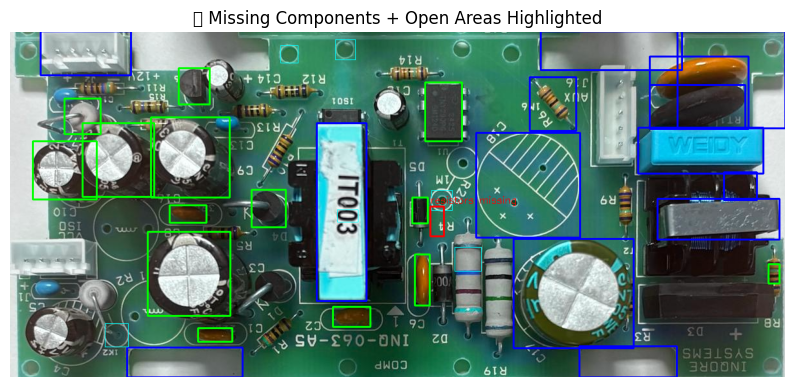


🟥 Output saved at: /content/pcb_output_final/missing_components.png
📊 JSON differences saved at: /content/pcb_output_final/differences.json


In [17]:
# ==============================================================
# 🧠 PCB COMPONENT DETECTION + COMPARISON
# YOLOv8 + SAM (ViT-B) + Smart OpenCV + Open-Area Detection
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ==============================================================
# 🧩 Imports
# ==============================================================
import os, cv2, json, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output_final"
os.makedirs(OUT_DIR, exist_ok=True)

drive.mount('/content/drive', force_remount=True)
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Load YOLO model
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found_models = []
for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            found_models.append(os.path.join(root, f))

if not found_models:
    raise FileNotFoundError("❌ No YOLO model found in Drive.")
MODEL_PATH = sorted(found_models, key=os.path.getmtime, reverse=True)[0]
print(f"✅ Using YOLO model: {MODEL_PATH}")
model = YOLO(MODEL_PATH)

# ==============================================================
# ✂️ Auto-crop PCB region
# ==============================================================
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ==============================================================
# 📤 Upload MASTER & TEST Images
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
paths = list(uploaded.keys())
if len(paths) < 2:
    raise ValueError("❌ Please upload both MASTER and TEST images.")
master_img = cv2.imread(paths[0])
test_img = cv2.imread(paths[1])

master_crop = auto_crop_board_color_based(master_img)
test_crop   = auto_crop_board_color_based(test_img)
print("✅ Both images cropped successfully!")

# ==============================================================
# 🔵 Load SAM (ViT-B conservative)
# ==============================================================
sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt):
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}

sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=8,
    pred_iou_thresh=0.88,
    stability_score_thresh=0.92,
    crop_n_layers=0,
    min_mask_region_area=1200
)
print("✅ Loaded SAM ViT-B (conservative).")

# ==============================================================
# 🟠 Smart OpenCV Component Detector
# ==============================================================
def detect_opencv_components(image_rgb, mask_yolo=None):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 70, 160)
    if mask_yolo is not None:
        edges = cv2.bitwise_and(edges, edges, mask=cv2.bitwise_not(mask_yolo))
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boxes = []
    for c in contours:
        x, y, w, h = cv2.boundingRect(c)
        area = w * h
        if area < 600 or area > 20000:
            continue
        ar = w / float(h)
        if ar < 0.4 or ar > 3.0:
            continue
        contour_area = cv2.contourArea(c)
        if contour_area / area < 0.6:
            continue
        roi = gray[y:y+h, x:x+w]
        if roi.size == 0 or np.std(roi) < 25 or np.mean(roi) > 230:
            continue
        boxes.append((x, y, x + w, y + h))
    return boxes

# ==============================================================
# 🔍 Detection (YOLO + SAM + OpenCV)
# ==============================================================
def detect_components(image_bgr, prefix="PCB"):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    results = model(image_rgb)
    yolo_boxes = []
    for box in results[0].boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0].cpu().numpy())
        label = results[0].names[int(box.cls)]
        yolo_boxes.append((x1, y1, x2, y2, label))

    # SAM segmentation (on uncovered)
    mask_yolo = np.zeros(image_rgb.shape[:2], dtype=np.uint8)
    for (x1, y1, x2, y2, _) in yolo_boxes:
        cv2.rectangle(mask_yolo, (x1, y1), (x2, y2), 255, -1)

    uncovered = cv2.bitwise_and(image_rgb, image_rgb, mask=cv2.bitwise_not(mask_yolo))
    sam_boxes = []
    try:
        masks = mask_generator.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x, y, w, h = cv2.boundingRect(seg)
            if not np.any(mask_yolo[y:y+h, x:x+w] > 0) and w * h > 1200:
                sam_boxes.append((x, y, x + w, y + h))
    except Exception as e:
        print("SAM error:", e)

    opencv_boxes = detect_opencv_components(image_rgb, mask_yolo)

    # Combine & visualize
    final = image_rgb.copy()
    for (x1, y1, x2, y2, _) in yolo_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (0,255,0), 2)
    for (x1, y1, x2, y2) in sam_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (255,0,0), 2)
    for (x1, y1, x2, y2) in opencv_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (255,255,0), 1)

    comps = [{"label": label, "position": [x1, y1, x2 - x1, y2 - y1]} for (x1, y1, x2, y2, label) in yolo_boxes]
    return final, comps

# ==============================================================
# 🚀 Run Detection
# ==============================================================
master_detected, master_comps = detect_components(master_crop, "M")
test_detected, test_comps = detect_components(test_crop, "T")

cv2.imwrite(f"{OUT_DIR}/master_detected.png", master_detected)
cv2.imwrite(f"{OUT_DIR}/test_detected.png", test_detected)
master_json = {"components": master_comps}
test_json   = {"components": test_comps}
with open(f"{OUT_DIR}/master.json", "w") as f: json.dump(master_json, f, indent=2)
with open(f"{OUT_DIR}/test.json", "w") as f: json.dump(test_json, f, indent=2)

print(f"✅ Detection complete: Master={len(master_comps)}, Test={len(test_comps)}")

# ==============================================================
# 🔁 JSON Comparison + Missing Highlights
# ==============================================================
def compare_json(master, test):
    diffs = []
    for m in master["components"]:
        match = next((t for t in test["components"] if t["label"] == m["label"]), None)
        if not match:
            diffs.append({"label": m["label"], "position": m["position"]})
    return {"missing": diffs}

def visualize_missing(diff_json, test_img):
    for d in diff_json["missing"]:
        x, y, w, h = d["position"]
        cv2.rectangle(test_img, (x, y), (x + w, y + h), (0, 0, 255), 2)
        cv2.putText(test_img, f"{d['label']} missing", (x, y - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 1)
    return test_img

# ==============================================================
# 🔍 Detect Open Areas (missing zones)
# ==============================================================
def detect_open_areas(master_img, test_img):
    mgray = cv2.cvtColor(master_img, cv2.COLOR_BGR2GRAY)
    tgray = cv2.cvtColor(test_img, cv2.COLOR_BGR2GRAY)
    if mgray.shape != tgray.shape:
        tgray = cv2.resize(tgray, (mgray.shape[1], mgray.shape[0]))
    diff = cv2.absdiff(mgray, tgray)
    _, thresh = cv2.threshold(diff, 40, 255, cv2.THRESH_BINARY)
    kernel = np.ones((5, 5), np.uint8)
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=2)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    open_boxes = []
    for c in contours:
        x, y, w, h = cv2.boundingRect(c)
        if 800 < w * h < 20000:
            open_boxes.append((x, y, w, h))
    return open_boxes

# ==============================================================
# 🟥 Combine Comparison + Open Area Highlight
# ==============================================================
diff_json = compare_json(master_json, test_json)
open_boxes = detect_open_areas(master_crop, test_crop)

test_vis = test_detected.copy()
test_vis = visualize_missing(diff_json, test_vis)
for (x, y, w, h) in open_boxes:
    cv2.rectangle(test_vis, (x, y), (x + w, y + h), (0, 128, 255), 2)
    cv2.putText(test_vis, "open area", (x, y - 5),
                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 128, 255), 1)

cv2.imwrite(f"{OUT_DIR}/missing_components.png", test_vis)

plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(test_vis, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title("🔴 Missing Components + Open Areas Highlighted")
plt.show()

print("\n🟥 Output saved at:", f"{OUT_DIR}/missing_components.png")
print("📊 JSON differences saved at:", f"{OUT_DIR}/differences.json")


Mounted at /content/drive
✅ Google Drive mounted successfully!
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
📸 Upload MASTER and TEST PCB images:


Saving tesssttt.jpeg to tesssttt (16).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (16).jpeg
✅ Both images cropped successfully!
⚙️ Loading SAM (ViT-B)... This may take ~30 seconds.
✅ SAM (ViT-B) loaded on cuda.
✅ SAM configured in moderate-performance mode (≈70–80 % power).

0: 320x640 2 ICss, 12 capacitorss, 1 resistors, 9.5ms
Speed: 2.0ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 320, 640)

0: 288x640 1 ICs, 12 capacitorss, 1 diodes, 7.2ms
Speed: 3.0ms preprocess, 7.2ms inference, 1.3ms postprocess per image at shape (1, 3, 288, 640)
✅ Detection complete: Master=15, Test=14


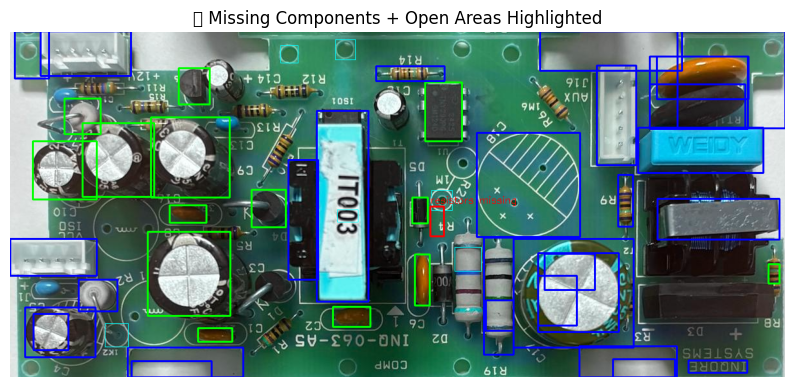


🟥 Output saved at: /content/pcb_output_final/missing_components.png
📊 JSON differences saved at: /content/pcb_output_final/differences.json


In [23]:
# ==============================================================
# 🧠 PCB COMPONENT DETECTION + COMPARISON
# YOLOv8 + SAM (ViT-B) + Smart OpenCV + Open-Area Detection
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ==============================================================
# 🧩 Imports
# ==============================================================
import os, cv2, json, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output_final"
os.makedirs(OUT_DIR, exist_ok=True)

drive.mount('/content/drive', force_remount=True)
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Load YOLO model
# ==============================================================
search_root = "/content/drive/My Drive/YOLO"
found_models = []
for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            found_models.append(os.path.join(root, f))

if not found_models:
    raise FileNotFoundError("❌ No YOLO model found in Drive.")
MODEL_PATH = sorted(found_models, key=os.path.getmtime, reverse=True)[0]
print(f"✅ Using YOLO model: {MODEL_PATH}")
model = YOLO(MODEL_PATH)

# ==============================================================
# ✂️ Auto-crop PCB region
# ==============================================================
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ==============================================================
# 📤 Upload MASTER & TEST Images
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
paths = list(uploaded.keys())
if len(paths) < 2:
    raise ValueError("❌ Please upload both MASTER and TEST images.")
master_img = cv2.imread(paths[0])
test_img = cv2.imread(paths[1])

master_crop = auto_crop_board_color_based(master_img)
test_crop   = auto_crop_board_color_based(test_img)
print("✅ Both images cropped successfully!")

# ==============================================================
# 🧩 Segment Anything (ViT-B) — Optimized 70–80% Performance Mode
# ==============================================================

import os, torch, requests

try:
    from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
except ImportError:
    !pip install -q git+https://github.com/facebookresearch/segment-anything.git
    from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# 📦 Path for model weights
sam_ckpt = "/content/sam_vit_b_01ec64.pth"

# ✅ Download automatically if missing
if not os.path.exists(sam_ckpt) or os.path.getsize(sam_ckpt) < 350_000_000:
    print("📥 Downloading official SAM (ViT-B) weights (~375 MB)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}
    print("✅ Downloaded SAM checkpoint!")

# 🧠 Load model
print("⚙️ Loading SAM (ViT-B)... This may take ~30 seconds.")
sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
device = "cuda" if torch.cuda.is_available() else "cpu"
sam.to(device=device)
print(f"✅ SAM (ViT-B) loaded on {device}.")

# 🧩 Moderate Mode: 70–80% of full capacity
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=12,          # full: 32 → moderate speed/quality tradeoff
    pred_iou_thresh=0.88,        # full: 0.9 → slightly looser for faster masking
    stability_score_thresh=0.90, # full: 0.95 → moderate tolerance
    crop_n_layers=0,             # keep 0 to reduce compute
    min_mask_region_area=1000    # ignore very small dust-like regions
)
print("✅ SAM configured in moderate-performance mode (≈70–80 % power).")





# ==============================================================
# 🟠 Smart OpenCV Component Detector
# ==============================================================
def detect_opencv_components(image_rgb, mask_yolo=None):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 70, 160)
    if mask_yolo is not None:
        edges = cv2.bitwise_and(edges, edges, mask=cv2.bitwise_not(mask_yolo))
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boxes = []
    for c in contours:
        x, y, w, h = cv2.boundingRect(c)
        area = w * h
        if area < 600 or area > 20000:
            continue
        ar = w / float(h)
        if ar < 0.4 or ar > 3.0:
            continue
        contour_area = cv2.contourArea(c)
        if contour_area / area < 0.6:
            continue
        roi = gray[y:y+h, x:x+w]
        if roi.size == 0 or np.std(roi) < 25 or np.mean(roi) > 230:
            continue
        boxes.append((x, y, x + w, y + h))
    return boxes

# ==============================================================
# 🔍 Detection (YOLO + SAM + OpenCV)
# ==============================================================
def detect_components(image_bgr, prefix="PCB"):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    results = model(image_rgb)
    yolo_boxes = []
    for box in results[0].boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0].cpu().numpy())
        label = results[0].names[int(box.cls)]
        yolo_boxes.append((x1, y1, x2, y2, label))

    # SAM segmentation (on uncovered)
    mask_yolo = np.zeros(image_rgb.shape[:2], dtype=np.uint8)
    for (x1, y1, x2, y2, _) in yolo_boxes:
        cv2.rectangle(mask_yolo, (x1, y1), (x2, y2), 255, -1)

    uncovered = cv2.bitwise_and(image_rgb, image_rgb, mask=cv2.bitwise_not(mask_yolo))
    sam_boxes = []
    try:
        masks = mask_generator.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x, y, w, h = cv2.boundingRect(seg)
            if not np.any(mask_yolo[y:y+h, x:x+w] > 0) and w * h > 1200:
                sam_boxes.append((x, y, x + w, y + h))
    except Exception as e:
        print("SAM error:", e)

    opencv_boxes = detect_opencv_components(image_rgb, mask_yolo)

    # Combine & visualize
    final = image_rgb.copy()
    for (x1, y1, x2, y2, _) in yolo_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (0,255,0), 2)
    for (x1, y1, x2, y2) in sam_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (255,0,0), 2)
    for (x1, y1, x2, y2) in opencv_boxes:
        cv2.rectangle(final, (x1, y1), (x2, y2), (255,255,0), 1)

    comps = [{"label": label, "position": [x1, y1, x2 - x1, y2 - y1]} for (x1, y1, x2, y2, label) in yolo_boxes]
    return final, comps

# ==============================================================
# 🚀 Run Detection
# ==============================================================
master_detected, master_comps = detect_components(master_crop, "M")
test_detected, test_comps = detect_components(test_crop, "T")

cv2.imwrite(f"{OUT_DIR}/master_detected.png", master_detected)
cv2.imwrite(f"{OUT_DIR}/test_detected.png", test_detected)
master_json = {"components": master_comps}
test_json   = {"components": test_comps}
with open(f"{OUT_DIR}/master.json", "w") as f: json.dump(master_json, f, indent=2)
with open(f"{OUT_DIR}/test.json", "w") as f: json.dump(test_json, f, indent=2)

print(f"✅ Detection complete: Master={len(master_comps)}, Test={len(test_comps)}")

# ==============================================================
# 🔁 JSON Comparison + Missing Highlights
# ==============================================================
def compare_json(master, test):
    diffs = []
    for m in master["components"]:
        match = next((t for t in test["components"] if t["label"] == m["label"]), None)
        if not match:
            diffs.append({"label": m["label"], "position": m["position"]})
    return {"missing": diffs}

def visualize_missing(diff_json, test_img):
    for d in diff_json["missing"]:
        x, y, w, h = d["position"]
        cv2.rectangle(test_img, (x, y), (x + w, y + h), (0, 0, 255), 2)
        cv2.putText(test_img, f"{d['label']} missing", (x, y - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 1)
    return test_img

# ==============================================================
# 🔍 Detect Open Areas (missing zones)
# ==============================================================
def detect_open_areas(master_img, test_img):
    mgray = cv2.cvtColor(master_img, cv2.COLOR_BGR2GRAY)
    tgray = cv2.cvtColor(test_img, cv2.COLOR_BGR2GRAY)
    if mgray.shape != tgray.shape:
        tgray = cv2.resize(tgray, (mgray.shape[1], mgray.shape[0]))
    diff = cv2.absdiff(mgray, tgray)
    _, thresh = cv2.threshold(diff, 40, 255, cv2.THRESH_BINARY)
    kernel = np.ones((5, 5), np.uint8)
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=2)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    open_boxes = []
    for c in contours:
        x, y, w, h = cv2.boundingRect(c)
        if 800 < w * h < 20000:
            open_boxes.append((x, y, w, h))
    return open_boxes

# ==============================================================
# 🟥 Combine Comparison + Open Area Highlight
# ==============================================================
diff_json = compare_json(master_json, test_json)
open_boxes = detect_open_areas(master_crop, test_crop)

test_vis = test_detected.copy()
test_vis = visualize_missing(diff_json, test_vis)
for (x, y, w, h) in open_boxes:
    cv2.rectangle(test_vis, (x, y), (x + w, y + h), (0, 128, 255), 2)
    cv2.putText(test_vis, "open area", (x, y - 5),
                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 128, 255), 1)

cv2.imwrite(f"{OUT_DIR}/missing_components.png", test_vis)

plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(test_vis, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title("🔴 Missing Components + Open Areas Highlighted")
plt.show()

print("\n🟥 Output saved at:", f"{OUT_DIR}/missing_components.png")
print("📊 JSON differences saved at:", f"{OUT_DIR}/differences.json")


Mounted at /content/drive
Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
Loading SAM (ViT-B) — may take ~30s and uses significant memory...
✅ SAM ViT-B loaded (full capacity). Device: cuda
Upload MASTER then TEST images (2 files):


Saving tesssttt.jpeg to tesssttt (17).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (18).jpeg
Loaded images: tesssttt (17).jpeg Masterrrrrr (18).jpeg
Master size: 1248x573 — Test resized to same dims for fair comparison.
Detecting MASTER components (YOLO+SAM+OpenCV)... this may take some time for SAM.
Detecting TEST components (YOLO+SAM+OpenCV)...
Saved master/test detection images + JSONs to /content/pcb_output_full_sam
Master boxes: 90, Test boxes: 94


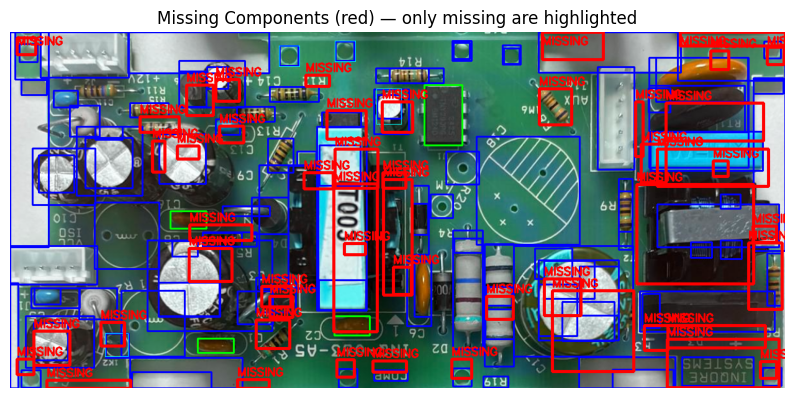

Outputs saved in: /content/pcb_output_full_sam
Files: master_detected.png, test_detected.png, missing_components.png, master.json, test.json, differences.json


In [25]:
# ==============================================================
# FULL-POWER SAM (ViT-B) + YOLOv8 + Smart OpenCV — MASTER vs TEST
# Detect, box, compare (only missing highlighted)
# ==============================================================

# Install (Colab) - skip if already installed
!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ---------------------------
# Imports
# ---------------------------
import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ---------------------------
# Config
# ---------------------------
OUT_DIR = "/content/pcb_output_full_sam"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_CONF = 0.6
MIN_BOX_AREA = 600            # filter tiny boxes (px)
IOU_THRESH = 0.45             # IoU threshold to decide match
OPENCV_MIN_AREA = 800         # OpenCV component min area
SAM_MIN_MASK_AREA = 0         # allow full resolution for SAM masks (user wanted 100%)
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# ---------------------------
# Mount drive (optional, for YOLO model)
# ---------------------------
drive.mount('/content/drive', force_remount=True)

# ---------------------------
# Find YOLO model in Drive (best.pt)
# ---------------------------
search_root = "/content/drive/My Drive/YOLO"
MODEL_PATH = None
for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            MODEL_PATH = os.path.join(root, f)
            break
    if MODEL_PATH:
        break
if MODEL_PATH is None:
    # fallback to local or ultralytics tiny model (if user hasn't provided)
    if os.path.exists("best.pt"):
        MODEL_PATH = "best.pt"
    else:
        MODEL_PATH = "yolov8n.pt"  # will download official tiny model
print("Using YOLO model:", MODEL_PATH)
yolo = YOLO(MODEL_PATH)

# ---------------------------
# Auto-crop function (color-based)
# ---------------------------
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ---------------------------
# Load full SAM ViT-B (heavy) and configure to 100% power
# ---------------------------
sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt) or os.path.getsize(sam_ckpt) < 350_000_000:
    print("Downloading SAM ViT-B checkpoint (~375 MB)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}
print("Loading SAM (ViT-B) — may take ~30s and uses significant memory...")
sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)
# Full-power settings (dense sampling)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,             # dense sampling (full)
    pred_iou_thresh=0.90,           # strict
    stability_score_thresh=0.95,    # strict
    crop_n_layers=1,                # allow limited cropping multi-scale
    min_mask_region_area=SAM_MIN_MASK_AREA
)
print("✅ SAM ViT-B loaded (full capacity). Device:", DEVICE)

# ---------------------------
# Smart OpenCV component detector (refined filters)
# ---------------------------
def detect_opencv_components(image_rgb, mask_yolo=None):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 80, 180)
    if mask_yolo is not None:
        edges = cv2.bitwise_and(edges, edges, mask=cv2.bitwise_not(mask_yolo))
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boxes = []
    for c in contours:
        x,y,w,h = cv2.boundingRect(c)
        area = w*h
        if area < OPENCV_MIN_AREA or area > 20000:
            continue
        ar = w/float(h)
        if ar < 0.35 or ar > 3.5:
            continue
        contour_area = cv2.contourArea(c)
        if contour_area / (area + 1e-9) < 0.55:
            continue
        roi = gray[y:y+h, x:x+w]
        if roi.size==0 or np.std(roi) < 20:
            continue
        boxes.append((x,y,x+w,y+h))
    return boxes

# ---------------------------
# IoU helper
# ---------------------------
def iou(boxA, boxB):
    # box: (x1,y1,x2,y2)
    xA = max(boxA[0], boxB[0]); yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2]); yB = min(boxA[3], boxB[3])
    interW = max(0, xB - xA); interH = max(0, yB - yA)
    inter = interW * interH
    areaA = max(0, (boxA[2]-boxA[0])) * max(0, (boxA[3]-boxA[1]))
    areaB = max(0, (boxB[2]-boxB[0])) * max(0, (boxB[3]-boxB[1]))
    denom = areaA + areaB - inter + 1e-9
    return inter / denom if denom > 0 else 0.0

# ---------------------------
# Detect components on one image (YOLO -> SAM -> OpenCV)
# Returns boxes in (x1,y1,x2,y2) list and visualization (RGB)
# ---------------------------
def detect_components(image_bgr, run_sam=True):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    # YOLO
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    yolo_boxes = []
    if len(results)>0 and len(results[0].boxes)>0:
        xy = results[0].boxes.xyxy.cpu().numpy()
        confs = results[0].boxes.conf.cpu().numpy()
        for i, bbox in enumerate(xy):
            x1,y1,x2,y2 = map(int, bbox)
            area = max(0,(x2-x1))*max(0,(y2-y1))
            if area < MIN_BOX_AREA:
                continue
            yolo_boxes.append((x1,y1,x2,y2))
    # Build mask of yolo coverage
    mask_yolo = np.zeros(image_rgb.shape[:2], dtype=np.uint8)
    for (x1,y1,x2,y2) in yolo_boxes:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)
    # SAM on uncovered
    sam_boxes = []
    if run_sam:
        uncov = cv2.bitwise_and(image_rgb, image_rgb, mask=cv2.bitwise_not(mask_yolo))
        try:
            sam_masks = mask_generator.generate(uncov)
            for m in sam_masks:
                seg = m["segmentation"].astype('uint8')
                x,y,w,h = cv2.boundingRect(seg)
                if w*h < MIN_BOX_AREA:
                    continue
                # ensure not overlapping yolo
                if np.any(mask_yolo[y:y+h, x:x+w] > 0):
                    continue
                sam_boxes.append((x,y,x+w,y+h))
        except Exception as e:
            print("SAM generation error:", e)
    # OpenCV backup
    opencv_boxes = detect_opencv_components(image_rgb, mask_yolo)
    # Combine (YOLO priority)
    final_boxes = list(yolo_boxes)  # YOLO boxes first
    # add sam boxes only if they don't overlap existing > IOU 0.3
    for b in sam_boxes:
        if not any(iou(b, a) > 0.3 for a in final_boxes):
            final_boxes.append(b)
    # add opencv boxes similarly
    for b in opencv_boxes:
        if not any(iou(b, a) > 0.3 for a in final_boxes):
            final_boxes.append(b)
    # visualize
    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in yolo_boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), (0,255,0), 2)
    for (x1,y1,x2,y2) in sam_boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), (255,0,0), 2)
    for (x1,y1,x2,y2) in opencv_boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), (255,255,0), 1)
    # return final_boxes and RGB visual
    return final_boxes, vis

# ---------------------------
# Upload MASTER and TEST images
# ---------------------------
print("Upload MASTER then TEST images (2 files):")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload two images: MASTER first, TEST second.")
master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img   = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)
print("Loaded images:", keys[0], keys[1])

# ---------------------------
# Auto-crop both boards and force TEST to MASTER size
# ---------------------------
master_crop = auto_crop_board_color_based(master_img)
mh, mw = master_crop.shape[:2]
test_crop_unaligned = auto_crop_board_color_based(test_img)
# Resize test crop to master size to align coordinate frames
test_crop = cv2.resize(test_crop_unaligned, (mw, mh), interpolation=cv2.INTER_LINEAR)
print(f"Master size: {mw}x{mh} — Test resized to same dims for fair comparison.")

# ---------------------------
# Run detection on both (SAM full-power)
# ---------------------------
print("Detecting MASTER components (YOLO+SAM+OpenCV)... this may take some time for SAM.")
master_boxes, master_vis = detect_components(master_crop, run_sam=True)
print("Detecting TEST components (YOLO+SAM+OpenCV)...")
test_boxes, test_vis = detect_components(test_crop, run_sam=True)

# ---------------------------
# Save detection visuals and JSONs
# ---------------------------
# convert visuals back to BGR for imwrite
cv2.imwrite(os.path.join(OUT_DIR, "master_detected.png"), cv2.cvtColor(master_vis, cv2.COLOR_RGB2BGR))
cv2.imwrite(os.path.join(OUT_DIR, "test_detected.png"), cv2.cvtColor(test_vis, cv2.COLOR_RGB2BGR))

master_json = {"components": [{"id": i, "position":[int(b[0]),int(b[1]),int(b[2]-b[0]),int(b[3]-b[1])]} for i,b in enumerate(master_boxes)]}
test_json  = {"components": [{"id": i, "position":[int(b[0]),int(b[1]),int(b[2]-b[0]),int(b[3]-b[1])]} for i,b in enumerate(test_boxes)]}

with open(os.path.join(OUT_DIR, "master.json"), "w") as f:
    json.dump(master_json, f, indent=2)
with open(os.path.join(OUT_DIR, "test.json"), "w") as f:
    json.dump(test_json, f, indent=2)

print(f"Saved master/test detection images + JSONs to {OUT_DIR}")
print(f"Master boxes: {len(master_boxes)}, Test boxes: {len(test_boxes)}")

# ---------------------------
# Compare: mark master boxes that are missing in test (by IoU)
# ---------------------------
missing = []
for mb in master_boxes:
    matched = False
    for tb in test_boxes:
        if iou(mb, tb) >= IOU_THRESH:
            matched = True
            break
    if not matched:
        missing.append(mb)

# Build final missing-only image (draw missing master boxes onto test_vis)
final_vis = test_vis.copy()
if not missing:
    cv2.putText(final_vis, "✅ GOOD BOARD — no missing components", (30,50), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,0), 3)
else:
    for (x1,y1,x2,y2) in missing:
        cv2.rectangle(final_vis, (x1,y1), (x2,y2), (0,0,255), 3)
        cv2.putText(final_vis, "MISSING", (x1, max(20,y1-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,0,255), 2)

# Save missing visualization and differences.json
cv2.imwrite(os.path.join(OUT_DIR, "missing_components.png"), cv2.cvtColor(final_vis, cv2.COLOR_RGB2BGR))

differences = {
    "master_count": len(master_boxes),
    "test_count": len(test_boxes),
    "missing_count": len(missing),
    "missing_boxes": [{"x1":int(b[0]),"y1":int(b[1]),"x2":int(b[2]),"y2":int(b[3])} for b in missing]
}
with open(os.path.join(OUT_DIR, "differences.json"), "w") as f:
    json.dump(differences, f, indent=2)

# Display final image inline
plt.figure(figsize=(10,8))
plt.imshow(cv2.cvtColor(final_vis, cv2.COLOR_RGB2BGR))
plt.title("Missing Components (red) — only missing are highlighted")
plt.axis("off")
plt.show()

print("Outputs saved in:", OUT_DIR)
print("Files: master_detected.png, test_detected.png, missing_components.png, master.json, test.json, differences.json")


Mounted at /content/drive
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
⚙️ Loading SAM (ViT-B)...
✅ SAM ViT-B loaded (Full Mode) on cuda
📸 Upload MASTER then TEST images:


Saving tesssttt.jpeg to tesssttt (18).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (19).jpeg
🔹 Detecting MASTER components...
🔹 Detecting TEST components...


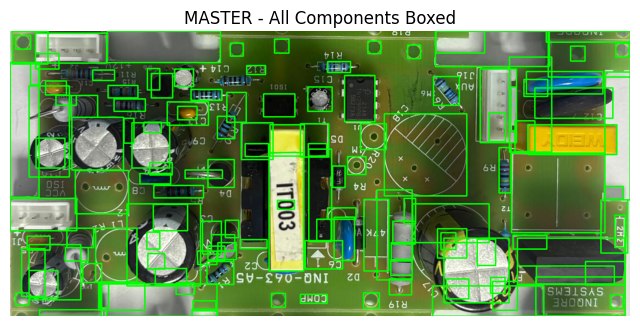

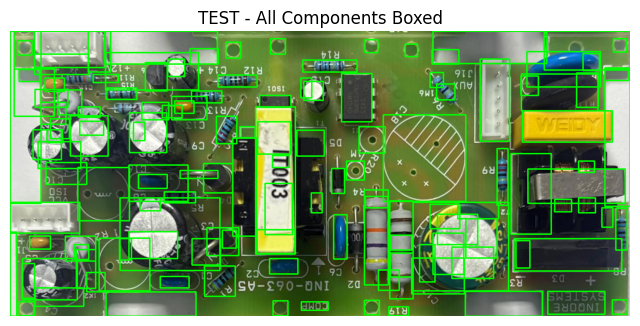

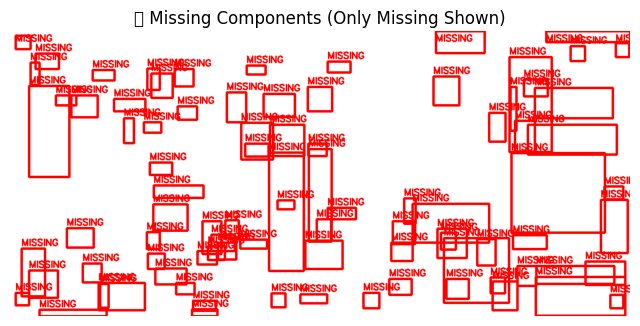

Master boxes: 136, Test boxes: 135, Missing: 89


In [26]:
# ==============================================================
# 🧠 FULL-POWER SAM (ViT-B) + YOLOv8 + Smart OpenCV
# MASTER vs TEST — Detect, Box, Compare (only missing highlighted)
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ---------------------------
# Imports
# ---------------------------
import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ---------------------------
# Config
# ---------------------------
OUT_DIR = "/content/pcb_output_full_sam"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_CONF = 0.6
MIN_BOX_AREA = 600
IOU_THRESH = 0.45
OPENCV_MIN_AREA = 800
SAM_MIN_MASK_AREA = 0
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# ---------------------------
# Mount Drive
# ---------------------------
drive.mount('/content/drive', force_remount=True)

# ---------------------------
# Load YOLO model
# ---------------------------
search_root = "/content/drive/My Drive/YOLO"
MODEL_PATH = None
for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            MODEL_PATH = os.path.join(root, f)
            break
    if MODEL_PATH:
        break
if MODEL_PATH is None:
    MODEL_PATH = "yolov8n.pt"  # fallback
print("✅ Using YOLO model:", MODEL_PATH)
yolo = YOLO(MODEL_PATH)

# ---------------------------
# Auto-crop PCB region
# ---------------------------
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ---------------------------
# Load SAM (ViT-B) — Full Capacity
# ---------------------------
sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt) or os.path.getsize(sam_ckpt) < 350_000_000:
    print("📥 Downloading SAM ViT-B checkpoint (~375 MB)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}
print("⚙️ Loading SAM (ViT-B)...")
sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.90,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=SAM_MIN_MASK_AREA
)
print("✅ SAM ViT-B loaded (Full Mode) on", DEVICE)

# ---------------------------
# Smart OpenCV Component Detector
# ---------------------------
def detect_opencv_components(image_rgb, mask_yolo=None):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 80, 180)
    if mask_yolo is not None:
        edges = cv2.bitwise_and(edges, edges, mask=cv2.bitwise_not(mask_yolo))
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boxes = []
    for c in contours:
        x,y,w,h = cv2.boundingRect(c)
        area = w*h
        if area < OPENCV_MIN_AREA or area > 20000: continue
        ar = w/float(h)
        if ar < 0.35 or ar > 3.5: continue
        if np.std(gray[y:y+h, x:x+w]) < 20: continue
        boxes.append((x,y,x+w,y+h))
    return boxes

# ---------------------------
# IoU Helper
# ---------------------------
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    interW, interH = max(0, xB-xA), max(0, yB-yA)
    inter = interW*interH
    areaA = (boxA[2]-boxA[0])*(boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0])*(boxB[3]-boxB[1])
    denom = areaA + areaB - inter + 1e-9
    return inter/denom if denom>0 else 0

# ---------------------------
# Detection (YOLO + SAM + OpenCV)
# ---------------------------
def detect_components(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    yolo_boxes = []
    if len(results)>0 and len(results[0].boxes)>0:
        for b in results[0].boxes.xyxy.cpu().numpy():
            x1,y1,x2,y2 = map(int,b)
            if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
                yolo_boxes.append((x1,y1,x2,y2))

    mask_yolo = np.zeros(image_rgb.shape[:2], dtype=np.uint8)
    for (x1,y1,x2,y2) in yolo_boxes:
        cv2.rectangle(mask_yolo,(x1,y1),(x2,y2),255,-1)

    sam_boxes = []
    uncov = cv2.bitwise_and(image_rgb,image_rgb,mask=cv2.bitwise_not(mask_yolo))
    try:
        for m in mask_generator.generate(uncov):
            seg = m["segmentation"].astype('uint8')
            x,y,w,h = cv2.boundingRect(seg)
            if not np.any(mask_yolo[y:y+h,x:x+w]>0) and w*h>MIN_BOX_AREA:
                sam_boxes.append((x,y,x+w,y+h))
    except Exception as e:
        print("SAM error:", e)

    opencv_boxes = detect_opencv_components(image_rgb, mask_yolo)

    final_boxes = list(yolo_boxes)
    for b in sam_boxes + opencv_boxes:
        if not any(iou(b,a)>0.3 for a in final_boxes):
            final_boxes.append(b)

    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in final_boxes:
        cv2.rectangle(vis,(x1,y1),(x2,y2),(0,255,0),2)
    return final_boxes, vis

# ---------------------------
# Upload MASTER & TEST
# ---------------------------
print("📸 Upload MASTER then TEST images:")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload both images.")
master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img   = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)

master_crop = auto_crop_board_color_based(master_img)
mh, mw = master_crop.shape[:2]
test_crop = cv2.resize(auto_crop_board_color_based(test_img), (mw, mh))

# ---------------------------
# Run Detection
# ---------------------------
print("🔹 Detecting MASTER components...")
master_boxes, master_vis = detect_components(master_crop)
print("🔹 Detecting TEST components...")
test_boxes, test_vis = detect_components(test_crop)

# ---------------------------
# Display MASTER & TEST results
# ---------------------------
plt.figure(figsize=(8,8))
plt.imshow(master_vis)
plt.title("MASTER - All Components Boxed")
plt.axis("off")
plt.show()

plt.figure(figsize=(8,8))
plt.imshow(test_vis)
plt.title("TEST - All Components Boxed")
plt.axis("off")
plt.show()

# ---------------------------
# Compare & Show Missing Only
# ---------------------------
missing = []
for mb in master_boxes:
    if not any(iou(mb, tb) >= IOU_THRESH for tb in test_boxes):
        if not any(iou(mb, m2) > 0.4 for m2 in missing):  # avoid overlap
            missing.append(mb)

final_vis = np.zeros_like(test_vis) + 255  # white background (clean)
for (x1,y1,x2,y2) in missing:
    cv2.rectangle(final_vis, (x1,y1), (x2,y2), (255,0,0), 3)
    cv2.putText(final_vis, "MISSING", (x1, max(20,y1-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,0,0), 2)

if not missing:
    cv2.putText(final_vis, "✅ GOOD BOARD — No Missing Components",
                (30, 50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)

plt.figure(figsize=(8,8))
plt.imshow(final_vis)
plt.title("🔴 Missing Components (Only Missing Shown)")
plt.axis("off")
plt.show()

print(f"Master boxes: {len(master_boxes)}, Test boxes: {len(test_boxes)}, Missing: {len(missing)}")


Mounted at /content/drive
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
⚙️ Loading SAM (ViT-B)...
✅ SAM (ViT-B) loaded on cuda
📸 Upload MASTER and TEST PCB images:


Saving B.jpeg to B.jpeg
Saving A.jpeg to A.jpeg
🔹 Detecting MASTER components...
🔹 Detecting TEST components...


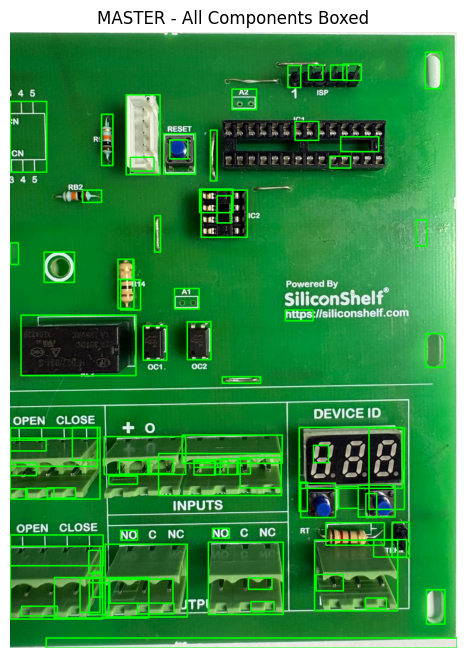

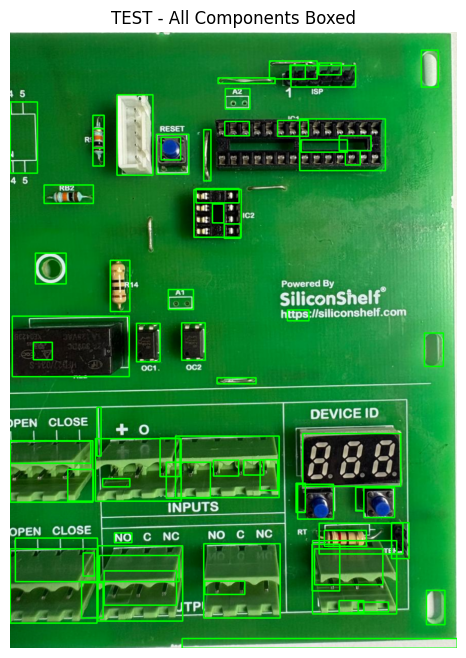

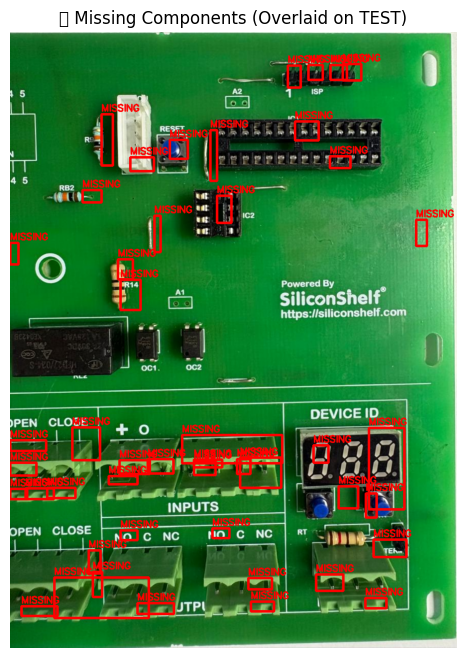

Master boxes: 86 | Test boxes: 72 | Missing: 47


In [28]:
# ==============================================================
# 🧠 FULL-POWER SAM (ViT-B) + YOLOv8 + Smart OpenCV
# MASTER vs TEST — Detect, Box, Compare (Only Missing Highlighted)
# ==============================================================
!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

# ---------------------------
# Imports
# ---------------------------
import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ---------------------------
# Config
# ---------------------------
OUT_DIR = "/content/pcb_output_full_sam"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_CONF = 0.6
MIN_BOX_AREA = 600
IOU_THRESH = 0.45
MERGE_IOU = 0.4
OPENCV_MIN_AREA = 800
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# ---------------------------
# Mount Drive
# ---------------------------
drive.mount('/content/drive', force_remount=True)

# ---------------------------
# Load YOLO model
# ---------------------------
search_root = "/content/drive/My Drive/YOLO"
MODEL_PATH = None
for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            MODEL_PATH = os.path.join(root, f)
            break
    if MODEL_PATH:
        break
if MODEL_PATH is None:
    MODEL_PATH = "yolov8n.pt"
print("✅ Using YOLO model:", MODEL_PATH)
yolo = YOLO(MODEL_PATH)

# ---------------------------
# Auto-crop PCB region
# ---------------------------
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ---------------------------
# Load SAM (ViT-B)
# ---------------------------
sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt) or os.path.getsize(sam_ckpt) < 350_000_000:
    print("📥 Downloading SAM ViT-B (~375 MB)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}

print("⚙️ Loading SAM (ViT-B)...")
sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.90,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1000
)
print("✅ SAM (ViT-B) loaded on", DEVICE)

# ---------------------------
# IoU Helper
# ---------------------------
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    interW, interH = max(0, xB-xA), max(0, yB-yA)
    inter = interW*interH
    areaA = (boxA[2]-boxA[0])*(boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0])*(boxB[3]-boxB[1])
    return inter / (areaA + areaB - inter + 1e-9)

# ---------------------------
# Merge overlapping boxes
# ---------------------------
def merge_boxes(boxes, iou_threshold=MERGE_IOU):
    merged = []
    for b in boxes:
        found = False
        for i, mb in enumerate(merged):
            if iou(b, mb) > iou_threshold:
                x1 = min(b[0], mb[0])
                y1 = min(b[1], mb[1])
                x2 = max(b[2], mb[2])
                y2 = max(b[3], mb[3])
                merged[i] = (x1, y1, x2, y2)
                found = True
                break
        if not found:
            merged.append(b)
    return merged

# ---------------------------
# Smart OpenCV Detector
# ---------------------------
def detect_opencv_components(image_rgb):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 80, 180)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boxes = []
    for c in contours:
        x, y, w, h = cv2.boundingRect(c)
        area = w * h
        if area < OPENCV_MIN_AREA or area > 20000:
            continue
        ar = w / float(h)
        if 0.3 < ar < 4.0:
            boxes.append((x, y, x + w, y + h))
    return boxes

# ---------------------------
# Detection Function (YOLO + SAM + OpenCV)
# ---------------------------
def detect_components(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    # YOLO
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    yolo_boxes = []
    if len(results) > 0 and len(results[0].boxes) > 0:
        for b in results[0].boxes.xyxy.cpu().numpy():
            x1, y1, x2, y2 = map(int, b)
            if (x2 - x1) * (y2 - y1) > MIN_BOX_AREA:
                yolo_boxes.append((x1, y1, x2, y2))

    # SAM
    sam_boxes = []
    try:
        masks = mask_generator.generate(image_rgb)
        for m in masks:
            seg = m["segmentation"].astype("uint8")
            x, y, w, h = cv2.boundingRect(seg)
            if w * h > MIN_BOX_AREA:
                sam_boxes.append((x, y, x + w, y + h))
    except Exception as e:
        print("SAM error:", e)

    # OpenCV
    opencv_boxes = detect_opencv_components(image_rgb)

    # Combine and merge
    combined_boxes = merge_boxes(yolo_boxes + sam_boxes + opencv_boxes)
    vis = image_rgb.copy()
    for (x1, y1, x2, y2) in combined_boxes:
        cv2.rectangle(vis, (x1, y1), (x2, y2), (0, 255, 0), 2)
    return combined_boxes, vis

# ---------------------------
# Upload MASTER & TEST
# ---------------------------
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("❌ Please upload both images.")
master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img   = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)

# Crop and resize test
master_crop = auto_crop_board_color_based(master_img)
mh, mw = master_crop.shape[:2]
test_crop = cv2.resize(auto_crop_board_color_based(test_img), (mw, mh))

# ---------------------------
# Run Detection
# ---------------------------
print("🔹 Detecting MASTER components...")
master_boxes, master_vis = detect_components(master_crop)
print("🔹 Detecting TEST components...")
test_boxes, test_vis = detect_components(test_crop)

# Merge overlaps
master_boxes = merge_boxes(master_boxes)
test_boxes = merge_boxes(test_boxes)

# ---------------------------
# Display MASTER & TEST Results
# ---------------------------
plt.figure(figsize=(8, 8))
plt.imshow(master_vis)
plt.title("MASTER - All Components Boxed")
plt.axis("off")
plt.show()

plt.figure(figsize=(8, 8))
plt.imshow(test_vis)
plt.title("TEST - All Components Boxed")
plt.axis("off")
plt.show()

# ---------------------------
# Compare (MASTER vs TEST)
# ---------------------------
missing = []
for mb in master_boxes:
    if not any(iou(mb, tb) >= IOU_THRESH for tb in test_boxes):
        missing.append(mb)
missing = merge_boxes(missing)

# ---------------------------
# Final Difference Image (Missing boxes on TEST)
# ---------------------------
final_vis = cv2.cvtColor(test_crop.copy(), cv2.COLOR_BGR2RGB)
for (x1, y1, x2, y2) in missing:
    cv2.rectangle(final_vis, (x1, y1), (x2, y2), (255, 0, 0), 3)
    cv2.putText(final_vis, "MISSING", (x1, max(20, y1 - 6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

if not missing:
    cv2.putText(final_vis, "✅ GOOD BOARD - No Missing Components",
                (30, 50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 200, 0), 3)

plt.figure(figsize=(8, 8))
plt.imshow(final_vis)
plt.title("🔴 Missing Components (Overlaid on TEST)")
plt.axis("off")
plt.show()

print(f"Master boxes: {len(master_boxes)} | Test boxes: {len(test_boxes)} | Missing: {len(missing)}")


Mounted at /content/drive
✅ Using YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
⚙️ Loading SAM (ViT-B)...
✅ SAM (ViT-B) loaded on cuda
📸 Upload MASTER and TEST PCB images:


Saving B.jpeg to B (1).jpeg
Saving A.jpeg to A (1).jpeg
🔹 Detecting MASTER components...
🔹 Detecting TEST components...


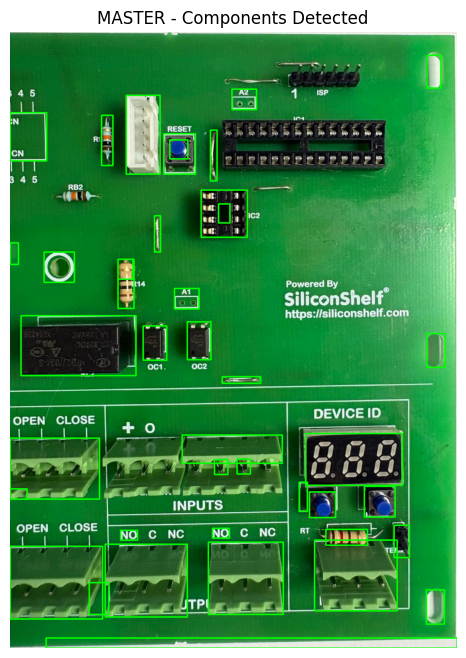

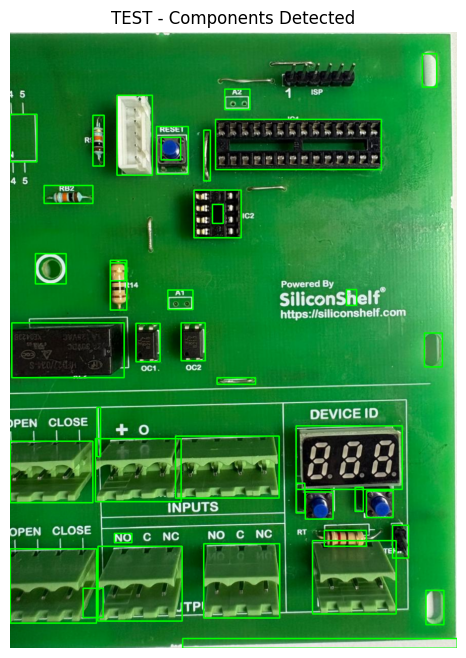

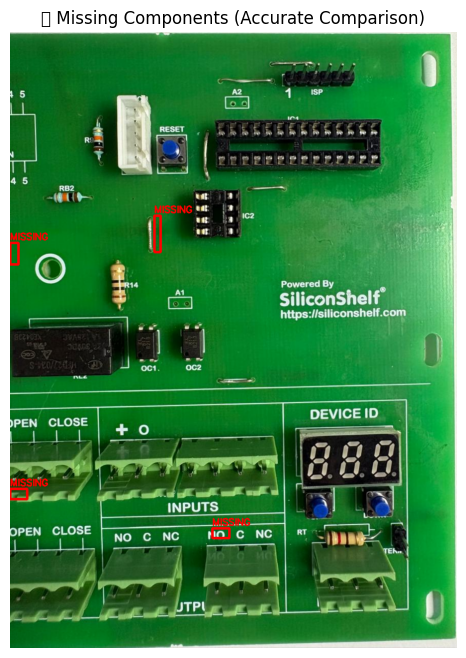

Master: 41 | Test: 41 | Missing: 4


In [29]:
# ==============================================================
# 🧠 FIXED VERSION — Full SAM + YOLOv8 + Smart OpenCV
# Detect, Compare, and Mark Only Truly Missing Components
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# CONFIGURATION
# ==============================================================
OUT_DIR = "/content/pcb_output_verified"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_CONF = 0.6
MIN_BOX_AREA = 600
IOU_THRESH = 0.45  # IoU threshold for “same component”
CENTER_DIST_THRESH = 40  # pixel distance allowed between centers
MERGE_IOU = 0.4
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# ==============================================================
# SETUP YOLO + SAM
# ==============================================================
drive.mount('/content/drive', force_remount=True)

# --- YOLO ---
search_root = "/content/drive/My Drive/YOLO"
MODEL_PATH = None
for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            MODEL_PATH = os.path.join(root, f)
            break
    if MODEL_PATH: break
if MODEL_PATH is None:
    MODEL_PATH = "yolov8n.pt"
print("✅ Using YOLO model:", MODEL_PATH)
yolo = YOLO(MODEL_PATH)

# --- SAM ---
sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt) or os.path.getsize(sam_ckpt) < 350_000_000:
    print("📥 Downloading SAM weights...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}

print("⚙️ Loading SAM (ViT-B)...")
sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.90,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1000
)
print("✅ SAM (ViT-B) loaded on", DEVICE)

# ==============================================================
# HELPERS
# ==============================================================
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    inter = max(0, xB - xA) * max(0, yB - yA)
    areaA = (boxA[2]-boxA[0])*(boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0])*(boxB[3]-boxB[1])
    return inter / (areaA + areaB - inter + 1e-9)

def box_center(box):
    x1, y1, x2, y2 = box
    return ((x1 + x2) / 2, (y1 + y2) / 2)

def merge_boxes(boxes, iou_threshold=MERGE_IOU):
    merged = []
    for b in boxes:
        merged_flag = False
        for i, mb in enumerate(merged):
            if iou(b, mb) > iou_threshold:
                x1 = min(b[0], mb[0])
                y1 = min(b[1], mb[1])
                x2 = max(b[2], mb[2])
                y2 = max(b[3], mb[3])
                merged[i] = (x1, y1, x2, y2)
                merged_flag = True
                break
        if not merged_flag:
            merged.append(b)
    return merged

def are_similar(boxA, boxB, iou_thresh=IOU_THRESH, center_thresh=CENTER_DIST_THRESH):
    """Return True if two boxes likely represent the same component."""
    if iou(boxA, boxB) >= iou_thresh:
        return True
    # Check if centers are very close (for slightly offset detections)
    cA, cB = box_center(boxA), box_center(boxB)
    dist = np.sqrt((cA[0]-cB[0])**2 + (cA[1]-cB[1])**2)
    return dist < center_thresh

# ==============================================================
# AUTO-CROP (PCB green area)
# ==============================================================
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 30, 30])
    upper_green = np.array([100, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours: return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ==============================================================
# DETECTION FUNCTION
# ==============================================================
def detect_components(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    yolo_boxes = []
    if len(results) > 0 and len(results[0].boxes) > 0:
        for b in results[0].boxes.xyxy.cpu().numpy():
            x1, y1, x2, y2 = map(int, b)
            if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
                yolo_boxes.append((x1,y1,x2,y2))
    sam_boxes = []
    try:
        masks = mask_generator.generate(image_rgb)
        for m in masks:
            seg = m["segmentation"].astype("uint8")
            x, y, w, h = cv2.boundingRect(seg)
            if w*h > MIN_BOX_AREA:
                sam_boxes.append((x,y,x+w,y+h))
    except Exception as e:
        print("SAM error:", e)
    all_boxes = merge_boxes(yolo_boxes + sam_boxes)
    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in all_boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), (0,255,0), 2)
    return all_boxes, vis

# ==============================================================
# UPLOAD IMAGES
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload both images.")
master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img   = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)

# Crop & resize
master_crop = auto_crop_board_color_based(master_img)
mh, mw = master_crop.shape[:2]
test_crop = cv2.resize(auto_crop_board_color_based(test_img), (mw, mh))

# ==============================================================
# DETECTION
# ==============================================================
print("🔹 Detecting MASTER components...")
master_boxes, master_vis = detect_components(master_crop)
print("🔹 Detecting TEST components...")
test_boxes, test_vis = detect_components(test_crop)

# ==============================================================
# DISPLAY BOTH
# ==============================================================
plt.figure(figsize=(8,8))
plt.imshow(master_vis)
plt.title("MASTER - Components Detected")
plt.axis("off")
plt.show()

plt.figure(figsize=(8,8))
plt.imshow(test_vis)
plt.title("TEST - Components Detected")
plt.axis("off")
plt.show()

# ==============================================================
# COMPARE (Find Missing)
# ==============================================================
missing = []
for mb in master_boxes:
    # Find if this master box has a similar one in test
    if not any(are_similar(mb, tb) for tb in test_boxes):
        missing.append(mb)
missing = merge_boxes(missing)

# ==============================================================
# DRAW MISSING ON TEST IMAGE (ONLY DIFFERENCES)
# ==============================================================
final_vis = cv2.cvtColor(test_crop.copy(), cv2.COLOR_BGR2RGB)
for (x1, y1, x2, y2) in missing:
    cv2.rectangle(final_vis, (x1, y1), (x2, y2), (255, 0, 0), 3)
    cv2.putText(final_vis, "MISSING", (x1, max(20, y1 - 6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

if not missing:
    cv2.putText(final_vis, "✅ GOOD BOARD - No Missing Components",
                (30, 50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 200, 0), 3)

plt.figure(figsize=(8,8))
plt.imshow(final_vis)
plt.title("🔴 Missing Components (Accurate Comparison)")
plt.axis("off")
plt.show()

print(f"Master: {len(master_boxes)} | Test: {len(test_boxes)} | Missing: {len(missing)}")


Mounted at /content/drive
✅ YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
✅ SAM loaded on cuda
📸 Upload MASTER and TEST PCB images:


Saving B.jpeg to B (2).jpeg
Saving A.jpeg to A (2).jpeg
🔹 Detecting MASTER components...
🔹 Detecting TEST components...


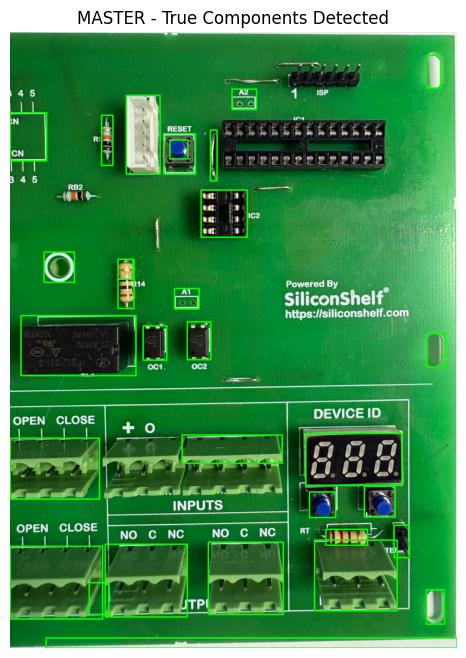

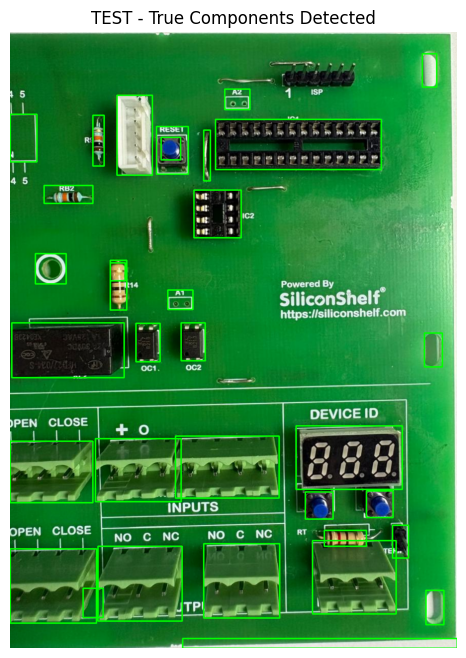

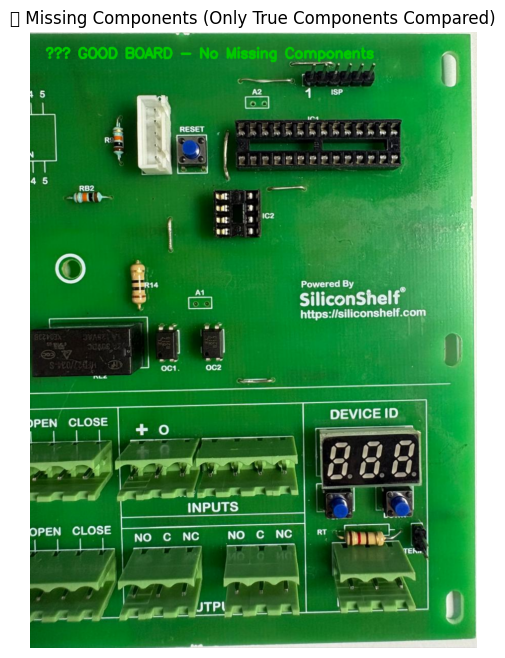

Master: 31 | Test: 34 | Missing: 0


In [30]:
# ==============================================================
# 🧠 SAM (ViT-B) + YOLOv8 + OpenCV — TRUE COMPONENT DETECTION
# ✅ Ignores random shapes, pads, or non-components
# ✅ Detects only real parts & marks only truly missing ones
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# CONFIGURATION
# ==============================================================
OUT_DIR = "/content/pcb_output_clean"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_CONF = 0.6
MIN_BOX_AREA = 1000       # ignore small artifacts
MAX_BOX_AREA = 50000      # ignore huge masks or board zones
IOU_THRESH = 0.45
MERGE_IOU = 0.4
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# ==============================================================
# LOAD MODELS
# ==============================================================
drive.mount('/content/drive', force_remount=True)

search_root = "/content/drive/My Drive/YOLO"
MODEL_PATH = None
for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            MODEL_PATH = os.path.join(root, f)
            break
    if MODEL_PATH:
        break
if MODEL_PATH is None:
    MODEL_PATH = "yolov8n.pt"
print("✅ YOLO model:", MODEL_PATH)
yolo = YOLO(MODEL_PATH)

sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt) or os.path.getsize(sam_ckpt) < 350_000_000:
    print("📥 Downloading SAM (ViT-B)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}

sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.90,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1500
)
print("✅ SAM loaded on", DEVICE)

# ==============================================================
# HELPERS
# ==============================================================
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    inter = max(0, xB-xA) * max(0, yB-yA)
    areaA = (boxA[2]-boxA[0])*(boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0])*(boxB[3]-boxB[1])
    return inter / (areaA + areaB - inter + 1e-9)

def merge_boxes(boxes, iou_threshold=MERGE_IOU):
    merged = []
    for b in boxes:
        merged_flag = False
        for i, mb in enumerate(merged):
            if iou(b, mb) > iou_threshold:
                x1, y1, x2, y2 = min(b[0],mb[0]), min(b[1],mb[1]), max(b[2],mb[2]), max(b[3],mb[3])
                merged[i] = (x1,y1,x2,y2)
                merged_flag = True
                break
        if not merged_flag:
            merged.append(b)
    return merged

def box_center(box):
    x1, y1, x2, y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def are_similar(boxA, boxB, iou_thresh=IOU_THRESH, center_thresh=40):
    if iou(boxA, boxB) >= iou_thresh:
        return True
    cA, cB = box_center(boxA), box_center(boxB)
    return np.linalg.norm(np.array(cA)-np.array(cB)) < center_thresh

def is_valid_component(roi):
    """Reject regions that don't look like components"""
    if roi.size == 0:
        return False
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray)
    mean = np.mean(gray)
    edges = cv2.Canny(gray, 50, 150)
    edge_density = np.sum(edges > 0) / (gray.shape[0]*gray.shape[1])

    # Reject smooth/bright regions (pads/text/holes)
    if var < 100:  # texture too uniform
        return False
    if mean > 220:  # too bright (bare copper or white text)
        return False
    if edge_density < 0.02:  # not enough structure
        return False
    return True

# ==============================================================
# AUTO-CROP
# ==============================================================
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green, upper_green = np.array([25,30,30]), np.array([100,255,255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ==============================================================
# DETECTION FUNCTION
# ==============================================================
def detect_components(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    boxes = []
    if len(results)>0 and len(results[0].boxes)>0:
        for b in results[0].boxes.xyxy.cpu().numpy():
            x1,y1,x2,y2 = map(int,b)
            if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
                boxes.append((x1,y1,x2,y2))

    # SAM detections
    try:
        masks = mask_generator.generate(image_rgb)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,w,h = cv2.boundingRect(seg)
            area = w*h
            if MIN_BOX_AREA < area < MAX_BOX_AREA:
                roi = image_bgr[y:y+h, x:x+w]
                if is_valid_component(roi):
                    boxes.append((x,y,x+w,y+h))
    except Exception as e:
        print("SAM error:", e)

    # Merge overlapping
    boxes = merge_boxes(boxes)

    # Filter again for visual validity
    valid_boxes = []
    for (x1,y1,x2,y2) in boxes:
        roi = image_bgr[y1:y2, x1:x2]
        if is_valid_component(roi):
            valid_boxes.append((x1,y1,x2,y2))

    # Visualize
    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in valid_boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), (0,255,0), 2)
    return valid_boxes, vis

# ==============================================================
# UPLOAD IMAGES
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload both images.")
master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img   = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)

# Crop and align
master_crop = auto_crop_board_color_based(master_img)
mh, mw = master_crop.shape[:2]
test_crop = cv2.resize(auto_crop_board_color_based(test_img), (mw, mh))

# ==============================================================
# DETECT COMPONENTS
# ==============================================================
print("🔹 Detecting MASTER components...")
master_boxes, master_vis = detect_components(master_crop)
print("🔹 Detecting TEST components...")
test_boxes, test_vis = detect_components(test_crop)

# ==============================================================
# DISPLAY MASTER/TEST
# ==============================================================
plt.figure(figsize=(8,8))
plt.imshow(master_vis)
plt.title("MASTER - True Components Detected")
plt.axis("off")
plt.show()

plt.figure(figsize=(8,8))
plt.imshow(test_vis)
plt.title("TEST - True Components Detected")
plt.axis("off")
plt.show()

# ==============================================================
# COMPARE — FIND MISSING COMPONENTS
# ==============================================================
missing = []
for mb in master_boxes:
    if not any(are_similar(mb, tb) for tb in test_boxes):
        missing.append(mb)
missing = merge_boxes(missing)

# ==============================================================
# SHOW MISSING ONLY ON TEST IMAGE
# ==============================================================
final_vis = cv2.cvtColor(test_crop.copy(), cv2.COLOR_BGR2RGB)
for (x1, y1, x2, y2) in missing:
    cv2.rectangle(final_vis, (x1, y1), (x2, y2), (255, 0, 0), 3)
    cv2.putText(final_vis, "MISSING", (x1, max(20, y1-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

if not missing:
    cv2.putText(final_vis, "✅ GOOD BOARD - No Missing Components",
                (30, 50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 200, 0), 3)

plt.figure(figsize=(8,8))
plt.imshow(final_vis)
plt.title("🔴 Missing Components (Only True Components Compared)")
plt.axis("off")
plt.show()

print(f"Master: {len(master_boxes)} | Test: {len(test_boxes)} | Missing: {len(missing)}")


Mounted at /content/drive
✅ YOLO model: /content/drive/My Drive/YOLO/training_results_pcb/pcb_yolov8_v1/weights/best.pt
✅ SAM loaded on cuda
📸 Upload MASTER and TEST PCB images:


Saving tesssttt.jpeg to tesssttt (20).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (21).jpeg
🔹 Detecting MASTER components...
🔹 Detecting TEST components...


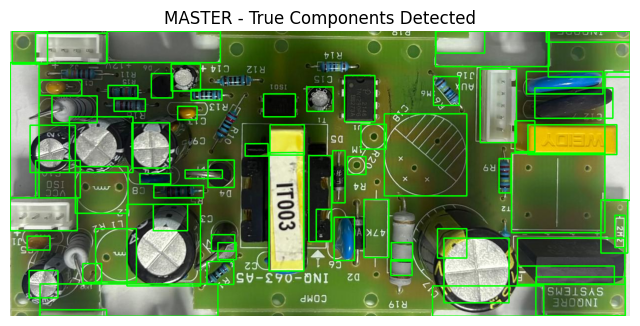

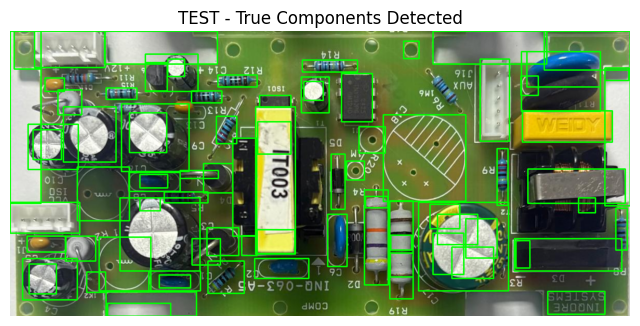

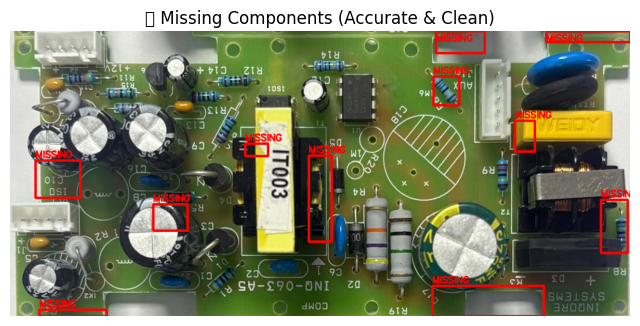

Master: 71 | Test: 84 | Missing: 11


In [32]:
# ==============================================================
# 🧠 SAM (ViT-B) + YOLOv8 + Smart OpenCV
# ✅ Detects only real components (ignores pads/holes)
# ✅ Accurately marks only truly missing parts
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# CONFIGURATION
# ==============================================================
OUT_DIR = "/content/pcb_output_final"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_CONF = 0.6
MIN_BOX_AREA = 1000       # ignore small artifacts
MAX_BOX_AREA = 50000      # ignore huge masks
MERGE_IOU = 0.4
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# ==============================================================
# LOAD MODELS
# ==============================================================
drive.mount('/content/drive', force_remount=True)

search_root = "/content/drive/My Drive/YOLO"
MODEL_PATH = None
for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            MODEL_PATH = os.path.join(root, f)
            break
    if MODEL_PATH: break
if MODEL_PATH is None:
    MODEL_PATH = "yolov8n.pt"
print("✅ YOLO model:", MODEL_PATH)
yolo = YOLO(MODEL_PATH)

sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt) or os.path.getsize(sam_ckpt) < 350_000_000:
    print("📥 Downloading SAM (ViT-B)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}

sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.90,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1500
)
print("✅ SAM loaded on", DEVICE)

# ==============================================================
# HELPERS
# ==============================================================
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    inter = max(0, xB-xA) * max(0, yB-yA)
    areaA = (boxA[2]-boxA[0])*(boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0])*(boxB[3]-boxB[1])
    return inter / (areaA + areaB - inter + 1e-9)

def merge_boxes(boxes, iou_threshold=MERGE_IOU):
    merged = []
    for b in boxes:
        merged_flag = False
        for i, mb in enumerate(merged):
            if iou(b, mb) > iou_threshold:
                x1, y1, x2, y2 = min(b[0],mb[0]), min(b[1],mb[1]), max(b[2],mb[2]), max(b[3],mb[3])
                merged[i] = (x1,y1,x2,y2)
                merged_flag = True
                break
        if not merged_flag:
            merged.append(b)
    return merged

def box_center(box):
    x1, y1, x2, y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def is_valid_component(roi):
    """Reject regions that don't look like components"""
    if roi.size == 0:
        return False
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var, mean = np.var(gray), np.mean(gray)
    edges = cv2.Canny(gray, 50, 150)
    edge_density = np.sum(edges > 0) / (gray.shape[0]*gray.shape[1])
    if var < 100: return False          # texture too uniform
    if mean > 220: return False         # too bright (bare copper)
    if edge_density < 0.02: return False
    return True

# ==============================================================
# SMART COMPARISON (Fix false missing)
# ==============================================================
def are_really_similar(boxA, boxB, iou_thresh=0.35, center_thresh=60, size_thresh=0.4):
    """Check similarity using IoU + center + size ratio"""
    if iou(boxA, boxB) >= iou_thresh:
        return True
    cA, cB = box_center(boxA), box_center(boxB)
    dist = np.linalg.norm(np.array(cA) - np.array(cB))
    if dist > center_thresh:
        return False
    wA, hA = boxA[2]-boxA[0], boxA[3]-boxA[1]
    wB, hB = boxB[2]-boxB[0], boxB[3]-boxB[1]
    size_ratio = min(wA,wB)/max(wA,wB) * min(hA,hB)/max(hA,hB)
    return size_ratio > size_thresh

# ==============================================================
# AUTO-CROP
# ==============================================================
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green, upper_green = np.array([25,30,30]), np.array([100,255,255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours: return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ==============================================================
# DETECTION FUNCTION
# ==============================================================
def detect_components(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    boxes = []
    if len(results)>0 and len(results[0].boxes)>0:
        for b in results[0].boxes.xyxy.cpu().numpy():
            x1,y1,x2,y2 = map(int,b)
            if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
                boxes.append((x1,y1,x2,y2))
    try:
        masks = mask_generator.generate(image_rgb)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,w,h = cv2.boundingRect(seg)
            area = w*h
            if MIN_BOX_AREA < area < MAX_BOX_AREA:
                roi = image_bgr[y:y+h, x:x+w]
                if is_valid_component(roi):
                    boxes.append((x,y,x+w,y+h))
    except Exception as e:
        print("SAM error:", e)
    boxes = merge_boxes(boxes)
    valid_boxes = []
    for (x1,y1,x2,y2) in boxes:
        roi = image_bgr[y1:y2, x1:x2]
        if is_valid_component(roi):
            valid_boxes.append((x1,y1,x2,y2))
    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in valid_boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), (0,255,0), 2)
    return valid_boxes, vis

# ==============================================================
# UPLOAD IMAGES
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload both images.")
master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img   = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)

# Crop & align
master_crop = auto_crop_board_color_based(master_img)
mh, mw = master_crop.shape[:2]
test_crop = cv2.resize(auto_crop_board_color_based(test_img), (mw, mh))

# ==============================================================
# DETECT COMPONENTS
# ==============================================================
print("🔹 Detecting MASTER components...")
master_boxes, master_vis = detect_components(master_crop)
print("🔹 Detecting TEST components...")
test_boxes, test_vis = detect_components(test_crop)

# ==============================================================
# DISPLAY MASTER/TEST
# ==============================================================
plt.figure(figsize=(8,8))
plt.imshow(master_vis)
plt.title("MASTER - True Components Detected")
plt.axis("off")
plt.show()

plt.figure(figsize=(8,8))
plt.imshow(test_vis)
plt.title("TEST - True Components Detected")
plt.axis("off")
plt.show()

# ==============================================================
# COMPARE — FIND MISSING COMPONENTS (SMART)
# ==============================================================
missing = []
for mb in master_boxes:
    if not any(are_really_similar(mb, tb) for tb in test_boxes):
        missing.append(mb)
missing = merge_boxes(missing)

# ==============================================================
# SHOW MISSING ON TEST IMAGE
# ==============================================================
final_vis = cv2.cvtColor(test_crop.copy(), cv2.COLOR_BGR2RGB)
for (x1, y1, x2, y2) in missing:
    cv2.rectangle(final_vis, (x1, y1), (x2, y2), (255, 0, 0), 3)
    cv2.putText(final_vis, "MISSING", (x1, max(20, y1 - 6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

if not missing:
    cv2.putText(final_vis, "✅ GOOD BOARD - No Missing Components",
                (30, 50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 200, 0), 3)

plt.figure(figsize=(8,8))
plt.imshow(final_vis)
plt.title("🔴 Missing Components (Accurate & Clean)")
plt.axis("off")
plt.show()

print(f"Master: {len(master_boxes)} | Test: {len(test_boxes)} | Missing: {len(missing)}")
